<a href="https://colab.research.google.com/github/aravind598/Machine_Learning_4041/blob/main/ML_CZ4041.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#IMPORT LIBRARIES

In [ ]:
#!pip install reverse_geocoder
!pip install catboost
!pip install smogn
#!pip install vecstack
from smogn import smoter
import lightgbm as lgb
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot
import matplotlib.pyplot as plt # we only need pyplot
sns.set() # set the default Seaborn style for graphics
import statsmodels.api as sm
%matplotlib inline
from sklearn.feature_selection import RFE, RFECV
from sklearn.linear_model import RidgeCV, LassoCV, Ridge, Lasso, LinearRegression, SGDRegressor, PassiveAggressiveRegressor, ARDRegression, BayesianRidge
from sklearn import metrics
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix
from sklearn.tree import export_graphviz, DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV, train_test_split, StratifiedKFold, RepeatedKFold, KFold
from sklearn.preprocessing import MinMaxScaler, StandardScaler, LabelEncoder, LabelBinarizer, Normalizer
from sklearn.cluster import KMeans
import graphviz
import plotly.offline as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from plotly import tools
import cufflinks as cf
import requests
from io import StringIO 
#import reverse_geocoder as rg
from sklearn.svm import SVR, NuSVR
from sklearn.neighbors import KNeighborsRegressor
from xgboost import XGBRegressor, XGBRFRegressor
from sklearn.linear_model import LinearRegression, Ridge, Lasso, BayesianRidge
from sklearn.experimental import enable_hist_gradient_boosting
from sklearn.ensemble import RandomForestRegressor, StackingRegressor,HistGradientBoostingRegressor, ExtraTreesRegressor, AdaBoostRegressor, GradientBoostingRegressor, ExtraTreesRegressor
from sklearn.metrics import mean_squared_error
from lightgbm import LGBMRegressor
#from vecstack import stacking
#from vecstack import StackingTransformer
from catboost import CatBoostRegressor
from catboost import Pool
import warnings
from xgboost import XGBRegressor
from xgboost import plot_importance
from sklearn.datasets import make_regression
from matplotlib import pyplot
from sklearn.decomposition import PCA
from tqdm import tqdm
from lightgbm import LGBMRegressor
from sklearn.model_selection import cross_val_score, cross_val_predict, cross_validate
from sklearn.model_selection import RepeatedKFold
from statistics import mean
from statistics import stdev
from sklearn.neural_network import MLPRegressor
from mlxtend.regressor import StackingRegressor
warnings.filterwarnings('ignore')
pd.set_option('display.max_colwidth',99999999)
pd.set_option('max_rows', 99999999999)

     |████████████████████████████████| 67.3MB 54kB/s 


/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


#2. Read DataFrames into Pandas

In [ ]:
url = 'https://raw.githubusercontent.com/aravind598/Machine_Learning_4041/main/Zindi/Train.csv'
url_1 = 'https://raw.githubusercontent.com/aravind598/Machine_Learning_4041/main/Zindi/variable_descriptions.csv'
url_2 = 'https://raw.githubusercontent.com/aravind598/Machine_Learning_4041/main/Zindi/Test.csv'

In [ ]:
train = pd.read_csv(url)
desc = pd.read_csv(url_1)
test = pd.read_csv(url_2)

In [ ]:
train.head()

,ward,total_households,total_individuals,target,dw_00,dw_01,dw_02,dw_03,dw_04,dw_05,dw_06,dw_07,dw_08,dw_09,dw_10,dw_11,dw_12,dw_13,psa_00,psa_01,psa_02,psa_03,psa_04,stv_00,stv_01,car_00,car_01,lln_00,lln_01,lan_00,lan_01,lan_02,lan_03,lan_04,lan_05,lan_06,lan_07,lan_08,lan_09,lan_10,lan_11,lan_12,lan_13,lan_14,pg_00,pg_01,pg_02,pg_03,pg_04,lgt_00,pw_00,pw_01,pw_02,pw_03,pw_04,pw_05,pw_06,pw_07,pw_08,ADM4_PCODE,lat,lon,NL
0,41601001: Ward 1,1674.45058,5888.20750,16.773757,0.933841,0.000846,0.005490,0.000676,0.000000,0.001372,0.005750,0.031466,0.008080,0.002823,0.001431,0.008224,0,0,0.260191,0.607898,0.000188,0.010018,0.121705,0.283468,0.716532,0.273727,0.726273,0.118825,0.881175,0.832913,0.012336,0.001923,0.050939,0.000000,0.000564,0.076088,0.006371,0.003663,0.000375,0.000372,0.004943,0.002719,0,0.006793,0.357455,0.563166,0.004260,0.072996,0.002123,0.919424,0.742692,0.214027,0.019968,0.002848,0.007537,0.000000,0.012928,0,0,ZA4161001,-29.682270,24.734743,0.292039
1,41601002: Ward 2,1736.99230,6735.33812,21.496661,0.696940,0.001253,0.004402,0.000000,0.002301,0.001323,0.007575,0.123547,0.151910,0.001486,0.001253,0.008010,0,0,0.290228,0.549788,0.000000,0.021336,0.138647,0.103641,0.896359,0.144638,0.855362,0.066903,0.933097,0.879655,0.008445,0.000328,0.011249,0.000842,0.001759,0.032431,0.030844,0.001646,0.001308,0.000994,0.000000,0.002439,0,0.028061,0.698428,0.278006,0.003695,0.015835,0.004036,0.959259,0.309294,0.576844,0.018946,0.014566,0.057127,0.019092,0.004131,0,0,ZA4161002,-29.119311,24.757737,3.207775
2,41601003: Ward 3,2403.57591,7273.04995,10.931425,0.810545,0.004517,0.008891,0.003986,0.007735,0.000956,0.006686,0.022632,0.129902,0.000000,0.000000,0.004150,0,0,0.186435,0.677005,0.000489,0.021315,0.114757,0.165772,0.834228,0.272220,0.727780,0.100009,0.899991,0.565546,0.015991,0.001566,0.111270,0.004795,0.002552,0.148083,0.139687,0.003165,0.000165,0.000779,0.001692,0.002509,0,0.002200,0.672452,0.154225,0.002181,0.167494,0.003649,0.826164,0.323393,0.483376,0.083010,0.057560,0.010358,0.001421,0.040881,0,0,ZA4161003,-29.142276,25.094093,0.000000
3,41601004: Ward 4,1740.78737,5734.49046,23.119257,0.659914,0.000000,0.006129,0.000000,0.000813,0.037245,0.005255,0.068909,0.218786,0.000000,0.000000,0.002947,0,0,0.281229,0.593281,0.000579,0.007249,0.117663,0.087768,0.912232,0.127875,0.872125,0.029155,0.970845,0.743812,0.006530,0.001188,0.086423,0.006735,0.002308,0.103244,0.038284,0.003080,0.000582,0.000000,0.000197,0.007442,0,0.000174,0.728014,0.263831,0.001806,0.000956,0.005393,0.986151,0.677437,0.314194,0.002689,0.000000,0.000669,0.000000,0.005011,0,0,ZA4161004,-29.372052,24.942867,2.038778
4,41601005: Ward 5,1730.51451,6657.23835,13.652252,0.950575,0.000655,0.001473,0.000598,0.006999,0.000818,0.004985,0.009150,0.015382,0.008693,0.000000,0.000673,0,0,0.196687,0.517578,0.000989,0.005148,0.279598,0.345975,0.654025,0.404507,0.595493,0.133552,0.866448,0.422623,0.014352,0.000842,0.121869,0.007027,0.002613,0.147363,0.081706,0.003044,0.000169,0.000643,0.001201,0.004276,0,0.192272,0.753491,0.129654,0.004523,0.106953,0.005380,0.957376,0.771106,0.194743,0.009699,0.004859,0.001290,0.000673,0.017629,0,0,ZA4161005,-29.409381,25.290165,0.000000


#Create a New DataFrame called newdata + Feature Engineering Section (newData) usinf the Train dataset, the final variable is lastData

In [ ]:
pd.set_option('display.max_colwidth',1000)
pd.set_option('max_rows', 99999)
numeric_features = train.select_dtypes(include=[np.number])
numeric_features.dtypes

total_households     float64
total_individuals    float64
target               float64
dw_00                float64
dw_01                float64
dw_02                float64
dw_03                float64
dw_04                float64
dw_05                float64
dw_06                float64
dw_07                float64
dw_08                float64
dw_09                float64
dw_10                float64
dw_11                float64
dw_12                  int64
dw_13                  int64
psa_00               float64
psa_01               float64
psa_02               float64
psa_03               float64
psa_04               float64
stv_00               float64
stv_01               float64
car_00               float64
car_01               float64
lln_00               float64
lln_01               float64
lan_00               float64
lan_01               float64
lan_02               float64
lan_03               float64
lan_04               float64
lan_05               float64
lan_06        

In [ ]:
# MinMax Scaler
min_max_scaler = MinMaxScaler()
normaliser=Normalizer()
newData = pd.DataFrame(train)
newData['Family_Size'] = newData['total_individuals'] / newData['total_households']
newData['scaled_total_households'] = min_max_scaler.fit_transform(newData['total_households'].values.reshape(-1,1))
#newData  = newData.drop('total_households', axis=1)
newData['scaled_total_individuals'] = min_max_scaler.fit_transform(newData['total_individuals'].values.reshape(-1,1))
#newData  = newData.drop('total_individuals', axis=1)
newData[['car_00', 'car_01', 'dw_00', 'dw_01', 'dw_02',
       'dw_03', 'dw_04', 'dw_05', 'dw_06', 'dw_07', 'dw_08', 'dw_09', 'dw_10',
       'dw_11', 'lan_00', 'lan_01', 'lan_02', 'lan_03', 'lan_04', 'lan_05',
       'lan_06', 'lan_07', 'lan_08', 'lan_09', 'lan_10', 'lan_11', 'lan_12',
       'lan_14', 'lgt_00', 'lln_00', 'lln_01', 'pg_00', 'pg_01',
       'pg_02', 'pg_03', 'pg_04', 'psa_00', 'psa_01', 'psa_02', 'psa_03',
       'psa_04', 'pw_00', 'pw_01', 'pw_02', 'pw_03', 'pw_04', 'pw_05', 'pw_06',
       'stv_00', 'stv_01']] = min_max_scaler.fit_transform(newData[[  'car_00', 'car_01', 'dw_00', 'dw_01', 'dw_02',
       'dw_03', 'dw_04', 'dw_05', 'dw_06', 'dw_07', 'dw_08', 'dw_09', 'dw_10',
       'dw_11', 'lan_00', 'lan_01', 'lan_02', 'lan_03', 'lan_04', 'lan_05',
       'lan_06', 'lan_07', 'lan_08', 'lan_09', 'lan_10', 'lan_11', 'lan_12',
       'lan_14', 'lgt_00', 'lln_00', 'lln_01', 'pg_00', 'pg_01',
       'pg_02', 'pg_03', 'pg_04', 'psa_00', 'psa_01', 'psa_02', 'psa_03',
       'psa_04', 'pw_00', 'pw_01', 'pw_02', 'pw_03', 'pw_04', 'pw_05', 'pw_06',
       'stv_00', 'stv_01']])

#Adding some data on the poor and rich in terms of percentage %
newData['Poor'] = np.nan
newData['Rich'] = np.nan
newData['Poor'] = newData['psa_01']+newData['car_01']+newData['stv_00']
newData['Rich'] = newData['psa_00']+newData['car_00'] + newData['stv_01']
newData['ADM4_PCODE_encoded'] = LabelEncoder().fit_transform(newData['ADM4_PCODE'])
newData['ward_encoded'] = LabelEncoder().fit_transform(newData['ward'])


newData['all_psa'] = newData['psa_00'] + newData['psa_01'] + newData['psa_02'] + newData['psa_03'] + newData['psa_04']
#newData['all_psa'] = newData['psa_00'] + newData['psa_02']
#newData['all_psa'] = newData['psa_00'] + newData['psa_03']
#newData['all_psa'] = newData['psa_00'] + newData['psa_04']


newData['all_pw'] = newData['pw_00'] + newData['pw_01'] + newData['pw_02'] + newData['pw_03'] + newData['pw_04']
#newData['all_pw'] = newData['pw_00'] + newData['pw_02']
#newData['all_pw'] = newData['pw_00'] + newData['pw_03']
#newData['all_pw'] = newData['pw_00'] + newData['pw_04']

Using KMEans to find CLusters betweenthe the lattitude and the longitudes

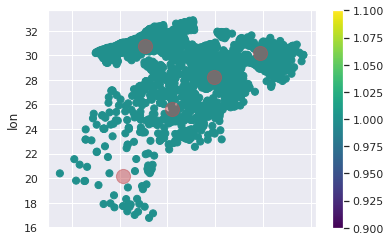

In [ ]:
#Clusters in terms of Lat and Long 
kmeans = KMeans(n_clusters =5, init ='k-means++')
kmeans.fit(newData[['lat','lon']])
newData['cluster_label'] = kmeans.fit_predict(newData[['lat','lon']])
centers = kmeans.cluster_centers_ # Coordinates of cluster centers.
labels = kmeans.predict(newData[['lat','lat']])
newData['cluster_label'].value_counts()
newData.plot.scatter(x = 'lat', y = 'lon', c=labels, s=50, cmap='viridis')
plt.scatter(centers[:, 0], centers[:, 1], c='r', s=200, alpha=0.5)

In [ ]:
newData['cluster_label'].value_counts()

3    960
0    781
2    527
4    498
1     56
Name: cluster_label, dtype: int64

In [ ]:
columning=newData.drop(["ward","target","ADM4_PCODE"],1).columns
KM_data=newData[columning].copy()
KM=KMeans(10,random_state=2019)
newData["cluster"]=KM.fit_predict(KM_data[columning])
newData["cluster"].value_counts()

5    817
9    654
2    432
0    362
4    164
1    158
8    138
3     73
7     22
6      2
Name: cluster, dtype: int64

In [ ]:
newData['W'] = newData['ward'].apply(lambda x : x.split(':')[1])
newData['W'] = LabelEncoder().fit_transform(newData['W'])
newData['car_01_bin'] = newData['car_01'].apply(lambda x : np.round(x * 100) ) 
# newData['car_01_bin'] = newData['car_01_bin'].apply(lambda x : 1 if x>50  else 0)
newData['psa_01_bin'] = newData['psa_01'].apply(lambda x : np.round(x * 100) ) 
# newData['psa_01_bin'] = newData['psa_01_bin'].apply(lambda x : 1 if x>50  else 0)
newData['stv_01_bin'] = newData['stv_01'].apply(lambda x : np.round(x * 100) ) 
newData['W_encoded1'] = newData.groupby('W')['psa_01_bin'].transform('mean')
newData['W_encoded2'] = newData.groupby('W')['car_01_bin'].transform('mean')
newData['W_encoded3'] = newData.groupby('W')['stv_01_bin'].transform('mean')
newData = newData.drop(['W','car_01_bin','psa_01_bin','stv_01_bin'],1)
train['NL'] = train['NL'].apply(lambda x : np.round(x * 10) )

In [ ]:
#Manhattan distance to find the straight line distance between 2 points, Given the Lat and Lon we can find the bearing from the points and the distance between them
def manhattan_distance(lat, lon):
    a = np.abs(lat -lon)
    return a

newData['dist_manhattan'] = manhattan_distance(newData['lon'].values, newData['lat'].values,)

#Bearing
#Gets the Earth's Rad and finds the bearing, Earth Radius in terms of KM = 6371
def bearing_array(lat, lon):
    lon_delta_rad = np.radians(lat - lon)
    lat, lon = map(np.radians, (lat, lon))
    y = np.sin(lon_delta_rad) * np.cos(lat)
    x = np.cos(lat) * np.sin(lat) - np.sin(lon) * np.cos(lon) * np.cos(lon_delta_rad)
    return np.degrees(np.arctan2(y, x))
newData['bearing'] = bearing_array(newData['lat'].values, newData['lon'].values,)

In [ ]:
max_households=newData["total_households"].max()
max_individuals=newData["total_individuals"].max()
newData["total_households_divMax"] = newData["total_households"].div(max_households)
newData["total_individuals_divMax"]= newData["total_individuals"].div(max_individuals)

luxury_items = ['psa_01','car_01','stv_00']
austerity_items = ['psa_00','car_00','stv_01']
newData['luxury_stuff'] = newData[luxury_items].sum(axis=1)
newData['austerity_stuff'] = newData[austerity_items].sum(axis=1)

In [ ]:
# reduce dimentionality for dwelling features
pca = PCA()
dwelling_features =  newData.filter(regex='dw_.*')
df_pca = pca.fit_transform(dwelling_features)

newData['pca_dw_0'] = df_pca[:,0]
newData['pca_dw_1'] = df_pca[:,1]
# reduce dimentionality for language features
newpca = PCA()
lan_features =  newData.filter(regex='lan_.*')
df_newpca = newpca.fit_transform(lan_features)

newData['pca_lan_0'] = df_newpca[:,0]
newData['pca_lan_1'] = df_newpca[:,1]
#water access
newData['water_access'] = newData.filter(regex='pw_.*').idxmax(axis=1)
newData['water_access'] = LabelEncoder().fit_transform(newData['water_access'])

In [ ]:
luxury_dwelling= ['dw_02', 'dw_03', 'dw_04', 'dw_05', 'dw_06', 'dw_09']
newData["luxury_dwelling"] = newData[luxury_dwelling].sum(axis=1)

shack_dwelling = ['dw_07','dw_08']
newData["shack_dwelling"] = newData[shack_dwelling].sum(axis=1)

poor_dwelling = ['dw_00','dw_01','dw_07','dw_08','dw_09','dw_10']
newData['poor_dwelling'] = newData[poor_dwelling].sum(axis=1)

verypoor_dwelling = ['dw_07','dw_08','dw_09','dw_10']
newData['very_poor_dwelling'] = newData[verypoor_dwelling].sum(axis=1)

no_dwelling = ['dw_11','dw_12','dw_13']
newData['no_specific_dwell'] = newData[no_dwelling].sum(axis=1)

'''newData[["luxury_dwelling","shack_dwelling",'poor_dwelling','no_specific_dwell',
         'very_poor_dwelling','pca_dw_00','pca_dw_01','pca_lan_00','pca_lan_01',"Poor0",	'Rich0'	,'all_psa0'	,'all_pw0'	,	'luxury_stuff0',	'austerity_stuff0']]=min_max_scaler.fit_transform(newData[["luxury_dwelling","shack_dwelling",'poor_dwelling',
                                                                                                                      'no_specific_dwell','very_poor_dwelling','pca_dw_0','pca_dw_1','pca_lan_0','pca_lan_1',"Poor",	'Rich'	,'all_psa'	,'all_pw'	,	'luxury_stuff',	'austerity_stuff']])
'''
#With Nearby Pipe Water Access either at home, yard or <200m away from the dwelling area
pipe_water_access = ['pw_00','pw_01','pw_02']
far_pipe_water_access = ['pw_03','pw_04','pw_05']
newData['pipe_water_access']=newData[pipe_water_access].sum(axis=1).div(len(pipe_water_access))
newData['far_pipe_water_access']=newData[far_pipe_water_access].sum(axis=1).div(len(far_pipe_water_access))

#Use Bearing and Manhattan Distance between point
newData[["Bearing_minmax","manhattan_minmax"]]=min_max_scaler.fit_transform(newData[['bearing','dist_manhattan' ]])
dist_loc=["Bearing_minmax","manhattan_minmax"]
newData['dist_loc'] = newData[dist_loc].sum(axis=1).div(len(dist_loc))
newData=newData.drop(["Bearing_minmax","manhattan_minmax"],axis=1)

#Modifying the Rich and Poor Columns as new_Rich, new_Poor
newData['new_Rich'] = newData['psa_00']+newData['car_00'] + newData['stv_01'] + newData['pw_00'] + newData['lgt_00']
newData['new_Poor'] = newData['psa_01']+newData['car_01']+newData['stv_00'] + newData['very_poor_dwelling']
newData['new_Rich']=newData['new_Rich']
newData['new_Poor']=newData['new_Poor']
newData['target']= pd.DataFrame(train)['target']
'''
newData[['pipe_water_access0',	'far_pipe_water_access0',	'dist_loc0',	'new_Rich0',	'new_Poor0']]=min_max_scaler.fit_transform(newData[['pipe_water_access',	'far_pipe_water_access',	'dist_loc',	'new_Rich',	'new_Poor']])'''



"\nnewData[['pipe_water_access0',\t'far_pipe_water_access0',\t'dist_loc0',\t'new_Rich0',\t'new_Poor0']]=min_max_scaler.fit_transform(newData[['pipe_water_access',\t'far_pipe_water_access',\t'dist_loc',\t'new_Rich',\t'new_Poor']])"

In [ ]:
newerData = newData.copy()
listy = ['ward', 'total_households', 'total_individuals', 'scaled_total_households', 'scaled_total_individuals','ADM4_PCODE', 
        'lat', 'lon', 'NL','dist_manhattan','bearing' ,'Family_Size','water_access','cluster_label', 'cluster', 'W_encoded1', 'W_encoded2','W_encoded3','ADM4_PCODE_encoded','ward_encoded']
dfexample = newerData[listy]
dropping1 = newerData.drop(listy,axis=1)


#newerData.drop(['ward', 'total_households', 'total_individuals', 'target','scaled_total_households', 'scaled_total_individuals','ADM4_PCODE', 
 #                          'lat', 'lon', 'NL','dist_manhattan','bearing' ,'Family_Size','water_access','cluster_label', 'cluster', 'W_encoded1', 'W_encoded2','ward'],axis=1)
#newnData = pd.DataFrame(normaliser.fit_transform(dropping))
#pd.concat([newnData,dfexample])

#df = dropping
#normalized_df=(df-df.min())/(df.max()-df.min())
normalized_df=(dropping1-dropping1.mean())/dropping1.std()
'''
one easy way by using Pandas: (here I want to use mean normalization)

normalized_df=(df-df.mean())/df.std()
#normalized_df=(dropping-dropping.mean())/dropping.std()

to use min-max normalization:

normalized_df=(df-df.min())/(df.max()-df.min())
'''

dfs = pd.concat([dfexample,normalized_df],axis=1)
lastData = dfs.copy()

ward
1
total_households
2
total_individuals
3
scaled_total_households
4
scaled_total_individuals
5
ADM4_PCODE
6
lat
7
lon
8
NL
9
dist_manhattan
10
bearing
11
Family_Size
12
water_access
13
cluster_label
14
cluster
15
W_encoded1
16
W_encoded2
17
W_encoded3
18
ADM4_PCODE_encoded
19
ward_encoded
20


In [ ]:
lastData.describe(include="all")

,ward,total_households,total_individuals,scaled_total_households,scaled_total_individuals,ADM4_PCODE,lat,lon,NL,dist_manhattan,bearing,Family_Size,water_access,cluster_label,cluster,W_encoded1,W_encoded2,W_encoded3,ADM4_PCODE_encoded,ward_encoded,target,dw_00,dw_01,dw_02,dw_03,dw_04,dw_05,dw_06,dw_07,dw_08,dw_09,dw_10,dw_11,dw_12,dw_13,psa_00,psa_01,psa_02,psa_03,psa_04,...,lan_12,lan_13,lan_14,pg_00,pg_01,pg_02,pg_03,pg_04,lgt_00,pw_00,pw_01,pw_02,pw_03,pw_04,pw_05,pw_06,pw_07,pw_08,Poor,Rich,all_psa,all_pw,total_households_divMax,total_individuals_divMax,luxury_stuff,austerity_stuff,pca_dw_0,pca_dw_1,pca_lan_0,pca_lan_1,luxury_dwelling,shack_dwelling,poor_dwelling,very_poor_dwelling,no_specific_dwell,pipe_water_access,far_pipe_water_access,dist_loc,new_Rich,new_Poor
count,2822,2822.000000,2822.000000,2822.000000,2822.000000,2822,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,0.0,0.0,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,...,2.822000e+03,0.0,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,0.0,0.0,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03
unique,2822,NaN,NaN,NaN,NaN,2822,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,94703013: Ward 13,NaN,NaN,NaN,NaN,ZA3091003,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,1,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,3665.281214,12869.130053,0.092337,0.136529,NaN,-26.880740,28.666515,17.437560,55.547254,-131.041947,5.163249,1.453225,2.119773,4.655563,61.714033,73.889440,73.121545,1410.500000,1410.500000,-2.000919e-15,4.390220e-15,-8.503710e-16,-2.071734e-16,-8.293626e-16,-2.095861e-15,-1.285490e-17,-1.011397e-15,-3.361356e-16,-4.082096e-16,5.795525e-16,-1.134930e-15,1.306145e-16,NaN,NaN,-5.260065e-15,-1.001601e-14,1.848696e-15,1.242510e-15,2.103680e-15,...,-7.797527e-17,NaN,2.793261e-16,9.833362e-15,-6.166419e-16,-1.529114e-16,7.980466e-16,-6.679435e-16,-3.437128e-15,7.526364e-16,1.786900e-15,-1.847329e-15,2.510394e-16,-1.420865e-15,9.503777e-16,4.339784e-16,NaN,NaN,7.614784e-15,-1.134324e-14,1.532068e-14,4.839079e-15,-4.979972e-16,2.626452e-15,7.614784e-15,-1.134324e-14,3.876732e-16,-4.796541e-16,-6.119996e-16,1.631107e-16,-2.213807e-15,6.430009e-16,4.403596e-15,2.758641e-16,1.306145e-16,-3.102881e-16,1.266606e-15,8.198812e-17,5.249286e-15,7.384439e-15
std,NaN,3266.364522,9696.690518,0.082309,0.106190,NaN,2.021279,2.373809,18.958621,2.989583,0.860419,72.727066,1.845823,1.469472,3.115592,2.709229,6.968230,7.183891,814.785555,814.785555,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.0

#Change the Train Data using SMOTE takes awhile to do this process

In [ ]:

newestData = smoter(
    data = newData,  ## pandas dataframe
    y = 'target'  ## string ('header name')
    #k = 9,                    ## positive integer (k < n)
    #samp_method = 'extreme',  ## string ('balance' or 'extreme')

    ## phi relevance arguments
    #rel_thres = 0.80,         ## positive real number (0 < R < 1)
    #rel_method = 'auto',      ## string ('auto' or 'manual')
    #rel_xtrm_type = 'high',   ## string ('low' or 'both' or 'high')
    #rel_coef = 2.25           ## positive real number (0 < R)
)

r_index: 100%|##########| 262/262 [00:06<00:00, 42.99it/s]


In [ ]:
lastingData = smoter(
    data = lastData,  ## pandas dataframe
    y = 'target'  ## string ('header name')
    #k = 9,                    ## positive integer (k < n)
    #samp_method = 'extreme',  ## string ('balance' or 'extreme')

    ## phi relevance arguments
    #rel_thres = 0.80,         ## positive real number (0 < R < 1)
    #rel_method = 'auto',      ## string ('auto' or 'manual')
    #rel_xtrm_type = 'high',   ## string ('low' or 'both' or 'high')
    #rel_coef = 2.25           ## positive real number (0 < R)

)

r_index: 100%|##########| 262/262 [00:06<00:00, 42.76it/s]


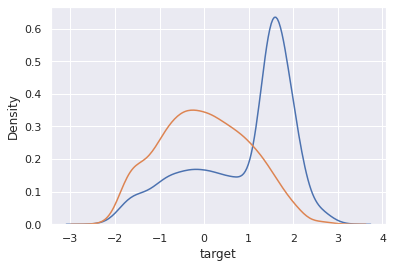

In [ ]:
sns.kdeplot(lastingData['target'], label = "Original")
sns.kdeplot(lastData['target'], label = "Modified")

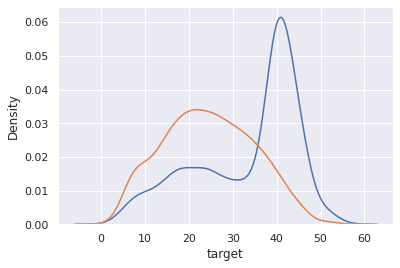

In [ ]:
sns.kdeplot(newestData['target'], label = "Original")
sns.kdeplot(newData['target'], label = "Modified")

#Test Data from Test dataset, the final variable is testData

In [ ]:
# MinMax Scaler
min_max_scaler = MinMaxScaler()
normaliser=Normalizer()
testData = pd.DataFrame(test)
#testData['target'] = pd.DataFrame(train)['target']
testData['Family_Size'] = testData['total_individuals'] / testData['total_households']
testData['scaled_total_households'] = min_max_scaler.fit_transform(testData['total_households'].values.reshape(-1,1))
#testData  = testData.drop('total_households', axis=1)
testData['scaled_total_individuals'] = min_max_scaler.fit_transform(testData['total_individuals'].values.reshape(-1,1))
#testData  = testData.drop('total_individuals', axis=1)
testData[['car_00', 'car_01', 'dw_00', 'dw_01', 'dw_02',
       'dw_03', 'dw_04', 'dw_05', 'dw_06', 'dw_07', 'dw_08', 'dw_09', 'dw_10',
       'dw_11', 'lan_00', 'lan_01', 'lan_02', 'lan_03', 'lan_04', 'lan_05',
       'lan_06', 'lan_07', 'lan_08', 'lan_09', 'lan_10', 'lan_11', 'lan_12',
       'lan_14', 'lgt_00', 'lln_00', 'lln_01', 'pg_00', 'pg_01',
       'pg_02', 'pg_03', 'pg_04', 'psa_00', 'psa_01', 'psa_02', 'psa_03',
       'psa_04', 'pw_00', 'pw_01', 'pw_02', 'pw_03', 'pw_04', 'pw_05', 'pw_06',
       'stv_00', 'stv_01']] = min_max_scaler.fit_transform(testData[[  'car_00', 'car_01', 'dw_00', 'dw_01', 'dw_02',
       'dw_03', 'dw_04', 'dw_05', 'dw_06', 'dw_07', 'dw_08', 'dw_09', 'dw_10',
       'dw_11', 'lan_00', 'lan_01', 'lan_02', 'lan_03', 'lan_04', 'lan_05',
       'lan_06', 'lan_07', 'lan_08', 'lan_09', 'lan_10', 'lan_11', 'lan_12',
       'lan_14', 'lgt_00', 'lln_00', 'lln_01', 'pg_00', 'pg_01',
       'pg_02', 'pg_03', 'pg_04', 'psa_00', 'psa_01', 'psa_02', 'psa_03',
       'psa_04', 'pw_00', 'pw_01', 'pw_02', 'pw_03', 'pw_04', 'pw_05', 'pw_06',
       'stv_00', 'stv_01']])

#Adding some data on the poor and rich in terms of percentage %
testData['Poor'] = np.nan
testData['Rich'] = np.nan
testData['Poor'] = testData['psa_01']+testData['car_01']+testData['stv_00']
testData['Rich'] = testData['psa_00']+testData['car_00'] + testData['stv_01']
testData['ADM4_PCODE_encoded'] = LabelEncoder().fit_transform(testData['ADM4_PCODE'])
testData['ward_encoded'] = LabelEncoder().fit_transform(testData['ward'])


testData['all_psa'] = testData['psa_00'] + testData['psa_01'] + testData['psa_02'] + testData['psa_03'] + testData['psa_04']
#testData['all_psa'] = testData['psa_00'] + testData['psa_02']
#testData['all_psa'] = testData['psa_00'] + testData['psa_03']
#testData['all_psa'] = testData['psa_00'] + testData['psa_04']


testData['all_pw'] = testData['pw_00'] + testData['pw_01'] + testData['pw_02'] + testData['pw_03'] + testData['pw_04']
#testData['all_pw'] = testData['pw_00'] + testData['pw_02']
#testData['all_pw'] = testData['pw_00'] + testData['pw_03']
#testData['all_pw'] = testData['pw_00'] + testData['pw_04']


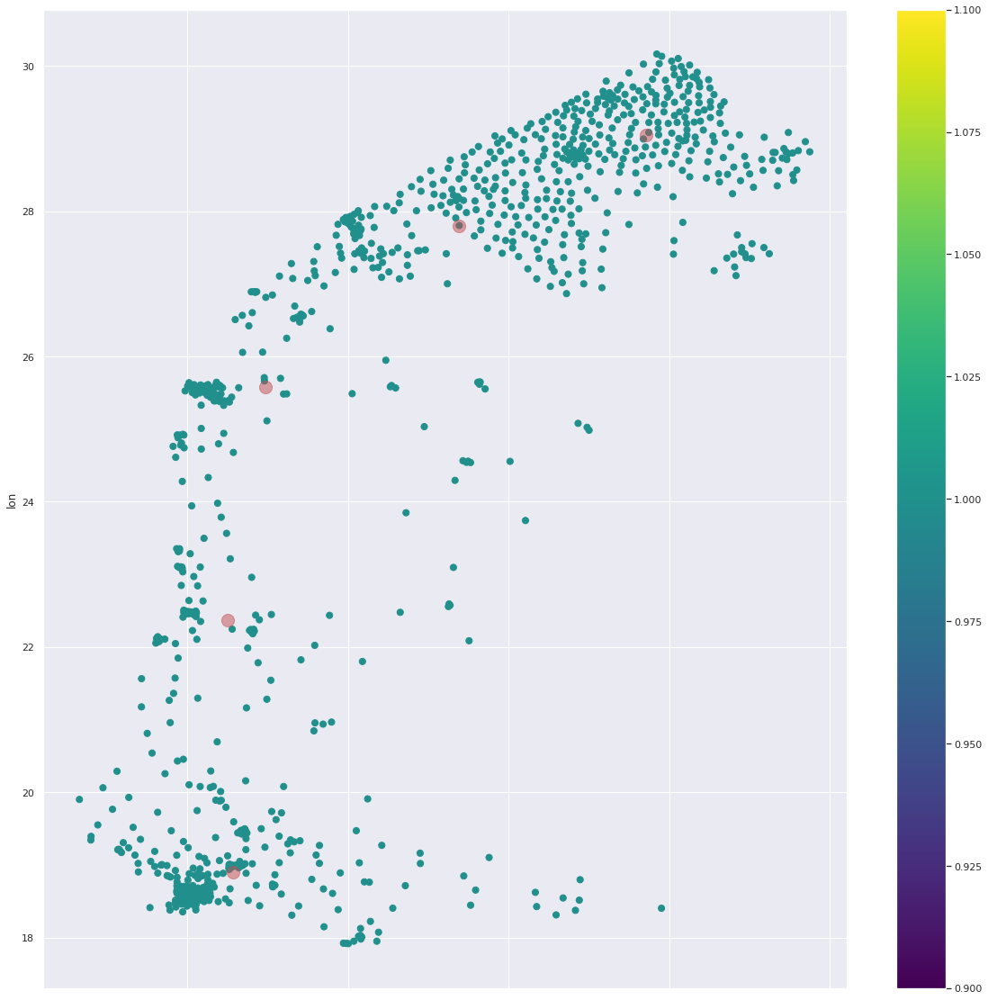

In [ ]:
#Clusters in terms of Lat and Long 
kmeans = KMeans(n_clusters =5, init ='k-means++')
kmeans.fit(testData[['lat','lon']])
testData['cluster_label'] = kmeans.fit_predict(testData[['lat','lon']])
centers = kmeans.cluster_centers_ # Coordinates of cluster centers.
labels = kmeans.predict(testData[['lat','lat']])
testData['cluster_label'].value_counts()
testData.plot.scatter(x = 'lat', y = 'lon', c=labels, s=50, cmap='viridis')
plt.scatter(centers[:, 0], centers[:, 1], c='r', s=200, alpha=0.5)

In [ ]:
columning=testData.drop(["ward","ADM4_PCODE"],1).columns
KM_data=testData[columning].copy()
KM=KMeans(10,random_state=2019)
testData["cluster"]=KM.fit_predict(KM_data[columning])
testData["cluster"].value_counts()

7    320
3    266
5    114
0    100
9     61
4     48
2     35
8     33
1     30
6      6
Name: cluster, dtype: int64

In [ ]:
testData['W'] = testData['ward'].apply(lambda x : x.split(':')[1])
testData['W'] = LabelEncoder().fit_transform(testData['W'])
testData['car_01_bin'] = testData['car_01'].apply(lambda x : np.round(x * 100) ) 
# testData['car_01_bin'] = testData['car_01_bin'].apply(lambda x : 1 if x>50  else 0)
testData['psa_01_bin'] = testData['psa_01'].apply(lambda x : np.round(x * 100) ) 
# testData['psa_01_bin'] = testData['psa_01_bin'].apply(lambda x : 1 if x>50  else 0)
testData['stv_01_bin'] = testData['stv_01'].apply(lambda x : np.round(x * 100) ) 
testData['W_encoded1'] = testData.groupby('W')['psa_01_bin'].transform('mean')
testData['W_encoded2'] = testData.groupby('W')['car_01_bin'].transform('mean')
testData['W_encoded3'] = testData.groupby('W')['stv_01_bin'].transform('mean')
testData = testData.drop(['W','car_01_bin','psa_01_bin','stv_01_bin'],1)
train['NL'] = train['NL'].apply(lambda x : np.round(x * 10) )

In [ ]:
#Manhattan distance to find the straight line distance between 2 points, Given the Lat and Lon we can find the bearing from the points and the distance between them
def manhattan_distance(lat, lon):
    a = np.abs(lat -lon)
    return a

testData['dist_manhattan'] = manhattan_distance(testData['lon'].values, testData['lat'].values,)

#Bearing
#Gets the Earth's Rad and finds the bearing, Earth Radius in terms of KM = 6371
def bearing_array(lat, lon):
    lon_delta_rad = np.radians(lat - lon)
    lat, lon = map(np.radians, (lat, lon))
    y = np.sin(lon_delta_rad) * np.cos(lat)
    x = np.cos(lat) * np.sin(lat) - np.sin(lon) * np.cos(lon) * np.cos(lon_delta_rad)
    return np.degrees(np.arctan2(y, x))
testData['bearing'] = bearing_array(testData['lat'].values, testData['lon'].values,)

In [ ]:
max_households=testData["total_households"].max()
max_individuals=testData["total_individuals"].max()
testData["total_households_divMax"] = testData["total_households"].div(max_households)
testData["total_individuals_divMax"]= testData["total_individuals"].div(max_individuals)

luxury_items = ['psa_01','car_01','stv_00']
austerity_items = ['psa_00','car_00','stv_01']
testData['luxury_stuff'] = testData[luxury_items].sum(axis=1)
testData['austerity_stuff'] = testData[austerity_items].sum(axis=1)

In [ ]:
# reduce dimentionality for dwelling features
pca = PCA()
dwelling_features =  testData.filter(regex='dw_.*')
df_pca = pca.fit_transform(dwelling_features)

testData['pca_dw_0'] = df_pca[:,0]
testData['pca_dw_1'] = df_pca[:,1]
# reduce dimentionality for language features
newpca = PCA()
lan_features =  testData.filter(regex='lan_.*')
df_newpca = newpca.fit_transform(lan_features)

testData['pca_lan_0'] = df_newpca[:,0]
testData['pca_lan_1'] = df_newpca[:,1]
#water access
testData['water_access'] = testData.filter(regex='pw_.*').idxmax(axis=1)
testData['water_access'] = LabelEncoder().fit_transform(testData['water_access'])

In [ ]:
luxury_dwelling= ['dw_02', 'dw_03', 'dw_04', 'dw_05', 'dw_06', 'dw_09']
testData["luxury_dwelling"] = testData[luxury_dwelling].sum(axis=1)

shack_dwelling = ['dw_07','dw_08']
testData["shack_dwelling"] = testData[shack_dwelling].sum(axis=1)

poor_dwelling = ['dw_00','dw_01','dw_07','dw_08','dw_09','dw_10']
testData['poor_dwelling'] = testData[poor_dwelling].sum(axis=1)

verypoor_dwelling = ['dw_07','dw_08','dw_09','dw_10']
testData['very_poor_dwelling'] = testData[verypoor_dwelling].sum(axis=1)

no_dwelling = ['dw_11','dw_12','dw_13']
testData['no_specific_dwell'] = testData[no_dwelling].sum(axis=1)

'''testData[["luxury_dwelling","shack_dwelling",'poor_dwelling','no_specific_dwell',
         'very_poor_dwelling','pca_dw_00','pca_dw_01','pca_lan_00','pca_lan_01',"Poor0",	'Rich0'	,'all_psa0'	,'all_pw0'	,	'luxury_stuff0',	'austerity_stuff0']]=min_max_scaler.fit_transform(testData[["luxury_dwelling","shack_dwelling",'poor_dwelling',
                                                                                                                      'no_specific_dwell','very_poor_dwelling','pca_dw_0','pca_dw_1','pca_lan_0','pca_lan_1',"Poor",	'Rich'	,'all_psa'	,'all_pw'	,	'luxury_stuff',	'austerity_stuff']])
'''
#With Nearby Pipe Water Access either at home, yard or <200m away from the dwelling area
pipe_water_access = ['pw_00','pw_01','pw_02']
far_pipe_water_access = ['pw_03','pw_04','pw_05']
testData['pipe_water_access']=testData[pipe_water_access].sum(axis=1).div(len(pipe_water_access))
testData['far_pipe_water_access']=testData[far_pipe_water_access].sum(axis=1).div(len(far_pipe_water_access))

#Use Bearing and Manhattan Distance between point
testData[["Bearing_minmax","manhattan_minmax"]]=min_max_scaler.fit_transform(testData[['bearing','dist_manhattan' ]])
dist_loc=["Bearing_minmax","manhattan_minmax"]
testData['dist_loc'] = testData[dist_loc].sum(axis=1).div(len(dist_loc))
testData=testData.drop(["Bearing_minmax","manhattan_minmax"],axis=1)

#Modifying the Rich and Poor Columns as new_Rich, new_Poor
testData['new_Rich'] = testData['psa_00']+testData['car_00'] + testData['stv_01'] + testData['pw_00'] + testData['lgt_00']
testData['new_Poor'] = testData['psa_01']+testData['car_01']+testData['stv_00'] + testData['very_poor_dwelling']
testData['new_Rich']=testData['new_Rich']
testData['new_Poor']=testData['new_Poor']
'''
testData[['pipe_water_access0',	'far_pipe_water_access0',	'dist_loc0',	'new_Rich0',	'new_Poor0']]=min_max_scaler.fit_transform(testData[['pipe_water_access',	'far_pipe_water_access',	'dist_loc',	'new_Rich',	'new_Poor']])'''



"\ntestData[['pipe_water_access0',\t'far_pipe_water_access0',\t'dist_loc0',\t'new_Rich0',\t'new_Poor0']]=min_max_scaler.fit_transform(testData[['pipe_water_access',\t'far_pipe_water_access',\t'dist_loc',\t'new_Rich',\t'new_Poor']])"

In [ ]:
newerData = testData.copy()
listy = ['ward', 'total_households', 'total_individuals', 'scaled_total_households', 'scaled_total_individuals','ADM4_PCODE', 
        'lat', 'lon', 'NL','dist_manhattan','bearing' ,'Family_Size','water_access','cluster_label', 'cluster', 'W_encoded1', 'W_encoded2','W_encoded3','ADM4_PCODE_encoded','ward_encoded']
dfexample = newerData[listy]
dropping1 = newerData.drop(listy,axis=1)


#newerData.drop(['ward', 'total_households', 'total_individuals', 'target','scaled_total_households', 'scaled_total_individuals','ADM4_PCODE', 
 #                          'lat', 'lon', 'NL','dist_manhattan','bearing' ,'Family_Size','water_access','cluster_label', 'cluster', 'W_encoded1', 'W_encoded2','ward'],axis=1)
#newnData = pd.DataFrame(normaliser.fit_transform(dropping))
#pd.concat([newnData,dfexample])

#df = dropping
#normalized_df=(df-df.min())/(df.max()-df.min())
normalized_df=(dropping1-dropping1.mean())/dropping1.std()
'''
one easy way by using Pandas: (here I want to use mean normalization)

normalized_df=(df-df.mean())/df.std()
#normalized_df=(dropping-dropping.mean())/dropping.std()

to use min-max normalization:

normalized_df=(df-df.min())/(df.max()-df.min())
'''

dfs = pd.concat([dfexample,normalized_df],axis=1)
ntData = dfs.copy()

In [ ]:
ntData.head()

,ward,total_households,total_individuals,scaled_total_households,scaled_total_individuals,ADM4_PCODE,lat,lon,NL,dist_manhattan,bearing,Family_Size,water_access,cluster_label,cluster,W_encoded1,W_encoded2,W_encoded3,ADM4_PCODE_encoded,ward_encoded,dw_00,dw_01,dw_02,dw_03,dw_04,dw_05,dw_06,dw_07,dw_08,dw_09,dw_10,dw_11,dw_12,dw_13,psa_00,psa_01,psa_02,psa_03,psa_04,stv_00,...,lan_12,lan_13,lan_14,pg_00,pg_01,pg_02,pg_03,pg_04,lgt_00,pw_00,pw_01,pw_02,pw_03,pw_04,pw_05,pw_06,pw_07,pw_08,Poor,Rich,all_psa,all_pw,total_households_divMax,total_individuals_divMax,luxury_stuff,austerity_stuff,pca_dw_0,pca_dw_1,pca_lan_0,pca_lan_1,luxury_dwelling,shack_dwelling,poor_dwelling,very_poor_dwelling,no_specific_dwell,pipe_water_access,far_pipe_water_access,dist_loc,new_Rich,new_Poor
0,21001001: Ward 1,2504.95194,8745.15151,0.118492,0.130710,ZA2101001,-32.637758,23.848688,0.000000,56.486446,-133.157714,3.491145,0,2,3,70.981818,74.963636,73.454545,387,387,1.460932,-0.764760,-0.566694,-0.418319,-0.344658,0.038610,-0.651134,-0.368819,-0.447673,-0.465478,-0.244255,-0.456577,NaN,NaN,-0.605764,0.892252,-0.508352,-0.687417,-0.190010,-0.238207,...,-0.302850,NaN,-0.057081,-1.202458,1.500549,-0.076150,-0.045082,-0.278060,0.519234,0.324545,1.721535,-0.754431,-0.694362,-0.613703,-0.508686,-0.621929,NaN,NaN,0.682538,-0.521232,-0.981272,0.196242,-0.224751,-0.319765,0.682538,-0.521232,-1.066277,-1.108164,1.326346,-1.062249,-0.796040,-0.493700,0.039380,-0.661370,-0.456577,0.803359,-0.726719,-0.311585,0.344421,-0.162205
1,21001002: Ward 2,2080.27718,7258.11764,0.097515,0.107530,ZA2101002,-31.990536,24.555818,0.000000,56.546353,-132.905673,3.489015,0,4,7,70.327273,70.636364,70.000000,388,388,1.098474,-0.765978,-0.053838,0.061447,0.446242,-0.217753,-0.135664,-0.185513,-0.335739,0.113021,1.882144,-0.132935,NaN,NaN,-1.186084,0.068076,0.477712,0.328233,1.761121,1.198495,...,-0.223013,NaN,2.210322,-0.461692,-0.143487,-0.138772,1.220373,0.254243,0.649273,0.876067,0.513710,-0.769977,-0.709771,-0.613703,-0.508686,-0.633989,NaN,NaN,0.085263,-1.162688,-0.246655,0.125519,-0.378247,-0.482233,0.085263,-1.162688,-0.932743,-0.692068,0.624102,-0.294775,0.022880,-0.321352,0.823881,0.337932,-0.132935,0.735027,-0.733978,-0.192637,0.606082,0.288910
2,21001003: Ward 3,1106.62639,5919.13170,0.049422,0.086658,ZA2101003,-32.283595,24.563940,8.269556,56.847535,-132.925309,5.348808,0,4,7,69.472727,72.090909,71.109091,389,389,0.412241,-0.742847,-0.503939,-0.418319,-0.217780,3.342422,-0.507213,0.238695,-0.364358,-0.465478,-0.488207,-0.075858,NaN,NaN,-0.072228,-0.256861,11.566387,1.071591,-0.319051,0.230680,...,-0.410162,NaN,-0.366727,-1.434825,2.040773,-0.236208,-0.480259,-0.293549,0.726414,0.728675,0.902901,-0.811480,-0.687206,-0.613703,-0.508686,-0.643410,NaN,NaN,0.535237,-0.723897,8.815267,0.159056,-0.730168,-0.628526,0.535237,-0.723897,-0.641566,0.126698,1.594896,-1.002698,0.417680,-0.112491,-1.228598,-0.404392,-0.075858,0.759566,-0.723348,-0.160395,0.701351,-0.043210
3,21001004: Ward 4,2175.56096,10280.57452,0.102222,0.154644,ZA2101004,-32.261612,24.542202,8.626625,56.803814,-132.930061,4.725482,0,4,5,69.000000,70.927273,68.527273,390,390,-0.440328,-0.759814,-0.449721,-0.368962,-0.344658,6.074930,-0.441802,1.366697,-0.464315,0.328950,-0.488207,-0.383451,NaN,NaN,-0.401256,-0.060937,-0.508352,-0.760179,1.376960,0.837242,...,-0.535713,NaN,1.291711,-1.378481,1.792672,0.161386,-0.195696,-0.314286,0.688193,0.336430,1.795625,-0.811132,-0.719759,-0.591303,-0.508686,-0.638955,NaN,NaN,0.480218,-0.848038,-1.079324,0.207088,-0.343808,-0.152011,0.480218,-0.848038,-0.335370,1.213759,1.493006,-0.979012,1.597313,0.427128,-1.604367,0.331886,-0.383451,0.819607,-0.730881,-0.168419,0.321695,0.471954
4,21001005: Ward 5,1270.83883,6018.34202,0.057533,0.088204,ZA2101005,-32.251571,24.558537,8.601754,56.810109,-132.924502,4.735724,1,4,7,68.923077,72.538462,71.788462,391,391,1.445316,-0.759284,-0.581487,-0.418319,-0.287454,-0.383430,-0.642148,-0.077840,-0.463474,1.031576,-0.488207,-0.306593,NaN,NaN,-0.18790

#Finished Data Headers

In [ ]:
print(len(lastData.columns))
print(len(newData.columns))

78
98


In [ ]:
desc.head()
desc

,Column,Description,Unnamed: 2,Unnamed: 3
0,dw_00,Percentage of dwellings of type: House or brick/concrete block structure on a separate stand or yard or on a farm,NaN,NaN
1,dw_01,Percentage of dwellings of type: Traditional dwelling/hut/structure made of traditional materials,NaN,NaN
2,dw_02,Percentage of dwellings of type: Flat or apartment in a block of flats,NaN,NaN
3,dw_03,Percentage of dwellings of type: Cluster house in complex,NaN,NaN
4,dw_04,Percentage of dwellings of type: Townhouse (semi-detached house in a complex),NaN,NaN
5,dw_05,Percentage of dwellings of type: Semi-detached house,NaN,NaN
6,dw_06,Percentage of dwellings of type: House/flat/room in backyard,NaN,NaN
7,dw_07,Percentage of dwellings of type: Informal dwelling (shack,in backyard),NaN
8,dw_08,Percentage of dwellings of type: Informal dwelling (shack,not in backyard,e.g. in an informal/squatter settlement or on a farm)
9,dw_09,Percentage of dwellings of type: Room/flatlet on a property or larger dwelling/servants quarters/granny flat,NaN,NaN


In [ ]:
print(lastingdata.shape)
print(newData.shape)

(2534, 98)
(2822, 98)


In [ ]:
testData.head()

,ward,total_households,total_individuals,dw_00,dw_01,dw_02,dw_03,dw_04,dw_05,dw_06,dw_07,dw_08,dw_09,dw_10,dw_11,dw_12,dw_13,psa_00,psa_01,psa_02,psa_03,psa_04,stv_00,stv_01,car_00,car_01,lln_00,lln_01,lan_00,lan_01,lan_02,lan_03,lan_04,lan_05,lan_06,lan_07,lan_08,lan_09,lan_10,lan_11,...,pw_08,ADM4_PCODE,lat,lon,NL,Family_Size,scaled_total_households,scaled_total_individuals,Poor,Rich,ADM4_PCODE_encoded,ward_encoded,all_psa,all_pw,cluster_label,cluster,W_encoded1,W_encoded2,W_encoded3,dist_manhattan,bearing,total_households_divMax,total_individuals_divMax,luxury_stuff,austerity_stuff,pca_dw_0,pca_dw_1,pca_lan_0,pca_lan_1,water_access,luxury_dwelling,shack_dwelling,poor_dwelling,very_poor_dwelling,no_specific_dwell,pipe_water_access,far_pipe_water_access,dist_loc,new_Rich,new_Poor
0,21001001: Ward 1,2504.95194,8745.15151,0.964030,0.000886,0.002657,0.000000,0.000000,0.040554,0.001082,0.029536,0.004185,0.000000,0.018688,0.008537,0.0,0.0,0.409279,0.776227,0.000000,0.047932,0.098370,0.191989,0.808011,0.206502,0.793498,0.210987,0.789013,0.836688,0.022102,0.060551,0.127730,0.003462,0.010605,0.003661,0.240051,0.011080,0.025405,0.029720,0.0,...,0.0,ZA2101001,-32.637758,23.848688,0.000000,3.491145,0.118492,0.130710,1.761713,1.423792,387,387,1.331807,1.062430,3,3,70.981818,74.963636,73.454545,56.486446,-133.157714,0.123087,0.135560,1.761713,1.423792,-0.449234,-0.203671,0.729385,-0.228398,0,0.044293,0.033721,1.017326,0.052409,0.008537,0.352640,0.001504,0.492556,2.898761,1.814123
1,21001002: Ward 2,2080.27718,7258.11764,0.859395,0.000488,0.057349,0.042726,0.055441,0.016564,0.052942,0.050852,0.020196,0.048161,0.181585,0.028147,0.0,0.0,0.306632,0.664795,0.080129,0.152814,0.209513,0.508719,0.491281,0.507663,0.492337,0.450961,0.549039,0.444667,0.119920,0.041305,0.294007,0.010580,0.125786,0.003028,0.124289,0.030643,0.031549,0.000000,0.0,...,0.0,ZA2101002,-31.990536,24.555818,0.000000,3.489015,0.097515,0.107530,1.665851,1.305576,388,388,1.413882,1.036143,0,7,70.327273,70.636364,70.000000,56.546353,-132.905673,0.102220,0.112509,1.665851,1.305576,-0.392975,-0.127196,0.343207,-0.063381,0,0.273182,0.071048,1.160677,0.300794,0.028147,0.344790,0.000591,0.529735,3.023866,1.966645
2,21001003: Ward 3,1106.62639,5919.13170,0.661292,0.008054,0.009349,0.000000,0.008894,0.349725,0.015561,0.100181,0.016103,0.000000,0.000000,0.031606,0.0,0.0,0.503651,0.620863,0.981212,0.229577,0.091020,0.295358,0.704642,0.178149,0.821851,0.107384,0.892616,0.975520,0.013318,0.035784,0.017945,0.006631,0.016119,0.002771,0.045090,0.093159,0.435888,0.086522,0.0,...,0.0,ZA2101003,-32.283595,24.563940,8.269556,5.348808,0.049422,0.086658,1.738072,1.386443,389,389,2.426323,1.048608,0,7,69.472727,72.090909,71.109091,56.847535,-132.925309,0.054377,0.091753,1.738072,1.386443,-0.270299,0.023286,0.877066,-0.215594,0,0.383529,0.116283,0.785629,0.116283,0.031606,0.347609,0.001927,0.539812,3.069416,1.854355
3,21001004: Ward 4,2175.56096,10280.57452,0.415170,0.002504,0.015131,0.004395,0.000000,0.605432,0.022142,0.231350,0.001804,0.066137,0.000000,0.012968,0.0,0.0,0.445453,0.647352,0.000000,0.040418,0.187630,0.429078,0.570922,0.347190,0.652810,0.304379,0.695621,0.872006,0.019760,0.092713,0.018432,0.001894,0.046840,0.001147,0.198553,0.022082,0.000000,0.012542,0.0,...,0.0,ZA2101004,-32.261612,24.542202,8.626625,4.725482,0.102222,0.154644,1.729241,1.363564,390,390,1.320853,1.066461,0,5,69.000000,70.927273,68.527273,56.803814,-132.930061,0.106902,0.159360,1.729241,1.363564,-0.141295,0.223078,0.821035,-0.210501,0,0.713238,0.233154,0.716966,0.299291,0.012968,0.354506,0.000981,0.537304,2.887895,2.028532
4,21001005: Ward 5,1270.83883,6018.34202,0.959522,0.002677,0.001079,0.000000,0.004010,0.001060,0.001986,0.063373,0.001925,0.124631,0.000000,0.017625,0.0,0.0,0.483191,0.691360,0.015992,0.155517,0.085005,0.318518,0.681482,0.169792,0.830208,0.166507,0.833493,0.988275,0.009161,0.035194,0.010789,0.009749,0.000000,0.002478,0.184780,0.021554,0.000000,0.085696,0.0,...,0.0,ZA2101005,-32.251571,24.558537,8.60175

In [ ]:
lastData.head()

,target,dw_00,dw_01,dw_02,dw_03,dw_04,dw_05,dw_06,dw_07,dw_08,dw_09,dw_10,dw_11,dw_12,dw_13,psa_00,psa_01,psa_02,psa_03,psa_04,stv_00,stv_01,car_00,car_01,lln_00,lln_01,lan_00,lan_01,lan_02,lan_03,lan_04,lan_05,lan_06,lan_07,lan_08,lan_09,lan_10,lan_11,lan_12,lan_13,lan_14,pg_00,pg_01,pg_02,pg_03,pg_04,lgt_00,pw_00,pw_01,pw_02,pw_03,pw_04,pw_05,pw_06,pw_07,pw_08,Poor,Rich,all_psa,all_pw,total_households_divMax,total_individuals_divMax,luxury_stuff,austerity_stuff,pca_dw_0,pca_dw_1,pca_lan_0,pca_lan_1,luxury_dwelling,shack_dwelling,poor_dwelling,very_poor_dwelling,no_specific_dwell,pipe_water_access,far_pipe_water_access,dist_loc,new_Rich,new_Poor
0,16.773757,0.938570,0.000908,0.005768,0.002560,0.000000,0.003148,0.013924,0.069032,0.010120,0.009980,0.020813,0.008224,0,0,0.463306,0.712647,0.009677,0.037467,0.082555,0.337266,0.662734,0.285528,0.714472,0.155813,0.844187,0.850565,0.013130,0.002148,0.059723,0.000000,0.000576,0.077545,0.006614,0.107009,0.000382,0.000378,0.004985,0.007393,0,0.006804,0.350274,0.580871,0.004534,0.077609,0.005771,0.919288,0.745745,0.228272,0.019968,0.008699,0.024568,0.000000,0.013445,0,0,1.764386,1.411567,1.305652,1.027252,0.042194,0.064200,1.764386,1.411567,-0.244426,-0.078111,-0.295695,-0.066837,0.035381,0.079151,1.049422,0.109944,0.008224,0.331328,0.011089,0.464615,3.076600,1.874330
1,21.496661,0.700469,0.001345,0.004625,0.000000,0.005870,0.003035,0.018343,0.271047,0.190249,0.005254,0.018223,0.008010,0,0,0.516791,0.644379,0.000000,0.079798,0.100279,0.123311,0.876689,0.150874,0.849126,0.087729,0.912271,0.898298,0.008989,0.000366,0.013189,0.000853,0.001797,0.033052,0.032022,0.048070,0.001333,0.001012,0.000000,0.006632,0,0.028105,0.695057,0.286746,0.003933,0.016836,0.010971,0.959190,0.310565,0.615238,0.018946,0.044491,0.186210,0.083640,0.004296,0,0,1.616816,1.544354,1.341246,1.175451,0.043770,0.073436,1.616816,1.544354,-0.036926,0.205953,-0.302957,-0.065095,0.037127,0.461295,1.186587,0.484773,0.008010,0.314917,0.104780,0.452581,2.814109,2.101589
2,10.931425,0.814649,0.004849,0.009341,0.015086,0.019727,0.002193,0.016192,0.049652,0.162687,0.000000,0.000000,0.004150,0,0,0.331972,0.793834,0.025157,0.079718,0.075287,0.197233,0.802767,0.283955,0.716045,0.131139,0.868861,0.577532,0.017020,0.001749,0.130456,0.004862,0.002607,0.150920,0.145021,0.092465,0.000168,0.000792,0.001706,0.006822,0,0.002203,0.668791,0.159073,0.002321,0.178078,0.009920,0.825869,0.324722,0.515549,0.083010,0.175813,0.033764,0.006227,0.042517,0,0,1.707112,1.418695,1.305967,1.132858,0.060566,0.079299,1.707112,1.418695,-0.131999,0.042945,-0.303766,-0.137816,0.062539,0.212339,1.031837,0.212339,0.004150,0.307761,0.071934,0.473977,2.569287,1.919450
3,23.119257,0.663255,0.000000,0.006440,0.000000,0.002075,0.085443,0.012727,0.151177,0.274004,0.000000,0.000000,0.002947,0,0,0.500766,0.695474,0.029785,0.027111,0.078326,0.104425,0.895575,0.133388,0.866612,0.038231,0.961769,0.759576,0.006951,0.001327,0.101326,0.006830,0.002358,0.105222,0.039746,0.089977,0.000593,0.000000,0.000198,0.020235,0,0.000175,0.724974,0.272125,0.001922,0.001017,0.014660,0.986127,0.680221,0.335106,0.002689,0.000000,0.002182,0.000000,0.005211,0,0,1.666511,1.529729,1.331462,1.020199,0.043865,0.062524,1.666511,1.529729,-0.005124,0.212670,-0.290936,-0.082119,0.106684,0.425181,1.088436,0.425181,0.002947,0.339339,0.000727,0.470053,3.196078,2.091692
4,13.652252,0.955388,0.000703,0.001547,0.002262,0.017850,0.001877,0.012071,0.020074,0.019264,0.030734,0.000000,0.000673,0,0,0.350228,0.606538,0.050867,0.019255,0.247729,0.411637,0.588363,0.421945,0.578055,0.175124,0.824876,0.431580,0.015276,0.000940,0.142883,0.007126,0.002670,0.150185,0.084826,0.088914,0.000173,0.000654,0.001211,0.011626,0,0.192571,0.750735,0.133730,0.004813,0.113712,0.014625,0.957304,0.774276,0.207705,0.009699,0.014840,0.004205,0.002950,0.018335,0,0,1.596229,1.360536,1.274617,1.010725,0.043606,0.072585,1.596229,1.360536,-0.258561,-0.101245,-0.266196,-0.091233,0.066341,0.039338,1.026162,0.070071,0.000673,0.330560,0.007332,0.492

In [ ]:
newData.describe()

,total_households,total_individuals,target,dw_00,dw_01,dw_02,dw_03,dw_04,dw_05,dw_06,dw_07,dw_08,dw_09,dw_10,dw_11,dw_12,dw_13,psa_00,psa_01,psa_02,psa_03,psa_04,stv_00,stv_01,car_00,car_01,lln_00,lln_01,lan_00,lan_01,lan_02,lan_03,lan_04,lan_05,lan_06,lan_07,lan_08,lan_09,lan_10,lan_11,...,pw_07,pw_08,lat,lon,NL,Family_Size,scaled_total_households,scaled_total_individuals,Poor,Rich,ADM4_PCODE_encoded,ward_encoded,all_psa,all_pw,cluster_label,cluster,W_encoded1,W_encoded2,W_encoded3,dist_manhattan,bearing,total_households_divMax,total_individuals_divMax,luxury_stuff,austerity_stuff,pca_dw_0,pca_dw_1,pca_lan_0,pca_lan_1,water_access,luxury_dwelling,shack_dwelling,poor_dwelling,very_poor_dwelling,no_specific_dwell,pipe_water_access,far_pipe_water_access,dist_loc,new_Rich,new_Poor
count,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.0,2822.0,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,...,2822.0,2822.0,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2.822000e+03,2.822000e+03,2.822000e+03,2.822000e+03,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000,2822.000000
mean,3665.281214,12869.130053,24.507554,0.715802,0.099428,0.033665,0.022921,0.022101,0.014427,0.054184,0.086210,0.080886,0.024268,0.016175,0.007902,0.0,0.0,0.554254,0.617099,0.027829,0.126019,0.089066,0.268799,0.731201,0.261103,0.738897,0.128030,0.871970,0.099671,0.062460,0.032854,0.046877,0.288307,0.119304,0.110122,0.135663,0.134980,0.024784,0.024686,0.054439,...,0.0,0.0,-26.880740,28.666515,17.437560,5.163249,0.092337,0.136529,1.624796,1.546558,1410.500000,1410.500000,1.414267,1.031451,2.299787,4.655563,61.714033,73.889440,73.121545,55.547254,-131.041947,0.092359,0.140314,1.624796,1.546558,-1.548293e-16,5.838310e-17,8.348311e-17,-4.272510e-17,1.453225,0.171567,0.167096,1.022769,0.207539,0.007902,0.280117,0.079775,0.659896,2.743882,1.832334
std,3266.364522,9696.690518,10.294387,0.215119,0.196301,0.084316,0.073319,0.078292,0.056448,0.089909,0.127001,0.137514,0.059465,0.044228,0.024762,0.0,0.0,0.136445,0.099995,0.042559,0.087422,0.037902,0.206798,0.206798,0.202032,0.202032,0.171885,0.171885,0.208320,0.131614,0.099948,0.097844,0.372724,0.260829,0.224373,0.270571,0.134579,0.119604,0.127822,0.163163,...,0.0,0.0,2.021279,2.373809,18.958621,72.727066,0.082309,0.106190,0.135626,0.160200,814.785555,814.785555,0.086700,0.227884,1.312874,3.115592,2.709229,6.968230,7.183891,2.989583,0.860419,0.082307,0.105724,0.135626,0.160200,2.636919e-01,1.880385e-01,4.044109e-01,2.884060e-01,1.845823,0.234096,0.220078,0.154962,0.232386,0.024762,0.077707,0.106096,0.159219,0.365971,0.305487
min,1.000000,402.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,-32.490089,16.760022,0.000000,1.254742,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.044405,0.000000,0.000000,49.000000,7.000000,10.000000,45.529354,-134.528212,0.000025,0.004383,1.000000,1.000000,-2.964721e-01,-3.556607e-01,-4.492334e-01,-5.750893e-01,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.002907,0.000000,0.000000,1.101869,1.000000
25%,1778.858235,7071.205695,1

In [ ]:
testData.describe()

,total_households,total_individuals,dw_00,dw_01,dw_02,dw_03,dw_04,dw_05,dw_06,dw_07,dw_08,dw_09,dw_10,dw_11,dw_12,dw_13,psa_00,psa_01,psa_02,psa_03,psa_04,stv_00,stv_01,car_00,car_01,lln_00,lln_01,lan_00,lan_01,lan_02,lan_03,lan_04,lan_05,lan_06,lan_07,lan_08,lan_09,lan_10,lan_11,lan_12,...,pw_07,pw_08,lat,lon,NL,Family_Size,scaled_total_households,scaled_total_individuals,Poor,Rich,ADM4_PCODE_encoded,ward_encoded,all_psa,all_pw,cluster_label,cluster,W_encoded1,W_encoded2,W_encoded3,dist_manhattan,bearing,total_households_divMax,total_individuals_divMax,luxury_stuff,austerity_stuff,pca_dw_0,pca_dw_1,pca_lan_0,pca_lan_1,water_access,luxury_dwelling,shack_dwelling,poor_dwelling,very_poor_dwelling,no_specific_dwell,pipe_water_access,far_pipe_water_access,dist_loc,new_Rich,new_Poor
count,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.0,1013.0,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,...,1013.0,1013.0,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1.013000e+03,1.013000e+03,1.013000e+03,1.013000e+03,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000,1013.000000
mean,3126.764779,11671.898368,0.542285,0.251046,0.063090,0.037253,0.024160,0.036941,0.066591,0.072424,0.068222,0.038751,0.037400,0.036202,0.0,0.0,0.516427,0.655591,0.041309,0.118918,0.109194,0.244503,0.755497,0.247928,0.752072,0.182800,0.817200,0.288302,0.083149,0.200045,0.580910,0.038235,0.154478,0.029508,0.109795,0.157281,0.072120,0.069826,0.050909,0.071885,...,0.0,0.0,-32.690435,24.763302,13.653903,4.031596,0.149207,0.176332,1.652166,1.519852,506.000000,506.000000,1.441440,0.989488,1.973346,4.688055,65.562685,75.203356,75.559724,57.453737,-132.747626,0.153642,0.180927,1.652166,1.519852,1.646703e-16,4.392121e-17,-7.874583e-17,2.537183e-17,1.855874,0.266787,0.140647,1.010130,0.216798,0.036202,0.260348,0.092836,0.589946,2.734087,1.868964
std,2766.674568,9152.794041,0.288682,0.327109,0.106642,0.089055,0.070099,0.093580,0.100608,0.116284,0.143046,0.083251,0.076607,0.060593,0.0,0.0,0.176881,0.135203,0.081262,0.103266,0.056963,0.220456,0.220456,0.250253,0.250253,0.232023,0.232023,0.364724,0.155211,0.133817,0.410487,0.066689,0.109886,0.109769,0.088330,0.120531,0.100375,0.085173,0.104269,0.116245,...,0.0,0.0,1.217243,4.214377,18.659450,1.487911,0.136660,0.142674,0.160500,0.184294,292.572213,292.572213,0.111725,0.371692,1.319615,2.604994,5.049611,10.552913,9.160419,3.373963,1.263375,0.135948,0.141878,0.160500,0.184294,4.213109e-01,1.837911e-01,5.499207e-01,2.150139e-01,2.347094,0.279501,0.216580,0.182729,0.248558,0.060593,0.114883,0.125677,0.312563,0.478120,0.338100
min,106.083320,359.881550,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,-34.670197,17.917653,0.000000,1.994041,0.000000,0.000000,0.508868,0.965088,0.000000,0.000000,1.000000,0.008620,0.000000,0.000000,53.000000,2.000000,11.000000,49.453007,-134.570804,0.005213,0.005579,0.508868,0.965088,-4.675091e-01,-2.359186e-01,-5.500948e-01,-2.849660e-01,0.000000,0.006975,0.000000,0.199269,0.000000,0.000000,0.001370,0.000000,0.029023,1.638429,0.543056
25%,1668.381650,6638.455370,0.29

In [ ]:
newData.dtypes

ward                         object
total_households            float64
total_individuals           float64
target                      float64
dw_00                       float64
dw_01                       float64
dw_02                       float64
dw_03                       float64
dw_04                       float64
dw_05                       float64
dw_06                       float64
dw_07                       float64
dw_08                       float64
dw_09                       float64
dw_10                       float64
dw_11                       float64
dw_12                         int64
dw_13                         int64
psa_00                      float64
psa_01                      float64
psa_02                      float64
psa_03                      float64
psa_04                      float64
stv_00                      float64
stv_01                      float64
car_00                      float64
car_01                      float64
lln_00                      

In [ ]:
testData.dtypes

ward                         object
total_households            float64
total_individuals           float64
dw_00                       float64
dw_01                       float64
dw_02                       float64
dw_03                       float64
dw_04                       float64
dw_05                       float64
dw_06                       float64
dw_07                       float64
dw_08                       float64
dw_09                       float64
dw_10                       float64
dw_11                       float64
dw_12                       float64
dw_13                       float64
psa_00                      float64
psa_01                      float64
psa_02                      float64
psa_03                      float64
psa_04                      float64
stv_00                      float64
stv_01                      float64
car_00                      float64
car_01                      float64
lln_00                      float64
lln_01                      

In [ ]:
train.head()

,ward,total_households,total_individuals,target,dw_00,dw_01,dw_02,dw_03,dw_04,dw_05,dw_06,dw_07,dw_08,dw_09,dw_10,dw_11,dw_12,dw_13,psa_00,psa_01,psa_02,psa_03,psa_04,stv_00,stv_01,car_00,car_01,lln_00,lln_01,lan_00,lan_01,lan_02,lan_03,lan_04,lan_05,lan_06,lan_07,lan_08,lan_09,lan_10,lan_11,lan_12,lan_13,lan_14,pg_00,pg_01,pg_02,pg_03,pg_04,lgt_00,pw_00,pw_01,pw_02,pw_03,pw_04,pw_05,pw_06,pw_07,pw_08,ADM4_PCODE,lat,lon,NL,Family_Size,scaled_total_households,scaled_total_individuals
0,41601001: Ward 1,1674.45058,5888.20750,16.773757,0.933841,0.000846,0.005490,0.000676,0.000000,0.001372,0.005750,0.031466,0.008080,0.002823,0.001431,0.008224,0,0,0.260191,0.607898,0.000188,0.010018,0.121705,0.283468,0.716532,0.273727,0.726273,0.118825,0.881175,0.832913,0.012336,0.001923,0.050939,0.000000,0.000564,0.076088,0.006371,0.003663,0.000375,0.000372,0.004943,0.002719,0,0.006793,0.357455,0.563166,0.004260,0.072996,0.002123,0.919424,0.742692,0.214027,0.019968,0.002848,0.007537,0.000000,0.012928,0,0,ZA4161001,-29.682270,24.734743,30.0,3.516501,0.042169,0.060080
1,41601002: Ward 2,1736.99230,6735.33812,21.496661,0.696940,0.001253,0.004402,0.000000,0.002301,0.001323,0.007575,0.123547,0.151910,0.001486,0.001253,0.008010,0,0,0.290228,0.549788,0.000000,0.021336,0.138647,0.103641,0.896359,0.144638,0.855362,0.066903,0.933097,0.879655,0.008445,0.000328,0.011249,0.000842,0.001759,0.032431,0.030844,0.001646,0.001308,0.000994,0.000000,0.002439,0,0.028061,0.698428,0.278006,0.003695,0.015835,0.004036,0.959259,0.309294,0.576844,0.018946,0.014566,0.057127,0.019092,0.004131,0,0,ZA4161002,-29.119311,24.757737,320.0,3.877587,0.043745,0.069357
2,41601003: Ward 3,2403.57591,7273.04995,10.931425,0.810545,0.004517,0.008891,0.003986,0.007735,0.000956,0.006686,0.022632,0.129902,0.000000,0.000000,0.004150,0,0,0.186435,0.677005,0.000489,0.021315,0.114757,0.165772,0.834228,0.272220,0.727780,0.100009,0.899991,0.565546,0.015991,0.001566,0.111270,0.004795,0.002552,0.148083,0.139687,0.003165,0.000165,0.000779,0.001692,0.002509,0,0.002200,0.672452,0.154225,0.002181,0.167494,0.003649,0.826164,0.323393,0.483376,0.083010,0.057560,0.010358,0.001421,0.040881,0,0,ZA4161003,-29.142276,25.094093,0.0,3.025929,0.060543,0.075246
3,41601004: Ward 4,1740.78737,5734.49046,23.119257,0.659914,0.000000,0.006129,0.000000,0.000813,0.037245,0.005255,0.068909,0.218786,0.000000,0.000000,0.002947,0,0,0.281229,0.593281,0.000579,0.007249,0.117663,0.087768,0.912232,0.127875,0.872125,0.029155,0.970845,0.743812,0.006530,0.001188,0.086423,0.006735,0.002308,0.103244,0.038284,0.003080,0.000582,0.000000,0.000197,0.007442,0,0.000174,0.728014,0.263831,0.001806,0.000956,0.005393,0.986151,0.677437,0.314194,0.002689,0.000000,0.000669,0.000000,0.005011,0,0,ZA4161004,-29.372052,24.942867,200.0,3.294194,0.043841,0.058397
4,41601005: Ward 5,1730.51451,6657.23835,13.652252,0.950575,0.000655,0.001473,0.000598,0.006999,0.000818,0.004985,0.009150,0.015382,0.008693,0.000000,0.000673,0,0,0.196687,0.517578,0.000989,0.005148,0.279598,0.345975,0.654025,0.404507,0.595493,0.133552,0.866448,0.422623,0.014352,0.000842,0.121869,0.007027,0.002613,0.147363,0.081706,0.003044,0.000169,0.000643,0.001201,0.004276,0,0.192272,0.753491,0.129654,0.004523,0.106953,0.005380,0.957376,0.771106,0.194743,0.009699,0.004859,0.001290,0.000673,0.017629,0,0,ZA4161005,-29.409381,25.290165,0.0,3.846971,0.043582,0.068502


In [ ]:
train['target'].describe()

count    2822.000000
mean       24.507554
std        10.294387
min         0.000000
25%        16.751556
50%        24.156670
75%        32.226553
max        55.528423
Name: target, dtype: float64

In [ ]:
desc.head()
#pd.set_option('display.max_colwidth', 200)
desc

,Column,Description,Unnamed: 2,Unnamed: 3
0,dw_00,Percentage of dwellings of type: House or brick/concrete block structure on a separate stand or yard or on a farm,NaN,NaN
1,dw_01,Percentage of dwellings of type: Traditional dwelling/hut/structure made of traditional materials,NaN,NaN
2,dw_02,Percentage of dwellings of type: Flat or apartment in a block of flats,NaN,NaN
3,dw_03,Percentage of dwellings of type: Cluster house in complex,NaN,NaN
4,dw_04,Percentage of dwellings of type: Townhouse (semi-detached house in a complex),NaN,NaN
5,dw_05,Percentage of dwellings of type: Semi-detached house,NaN,NaN
6,dw_06,Percentage of dwellings of type: House/flat/room in backyard,NaN,NaN
7,dw_07,Percentage of dwellings of type: Informal dwelling (shack,in backyard),NaN
8,dw_08,Percentage of dwellings of type: Informal dwelling (shack,not in backyard,e.g. in an informal/squatter settlement or on a farm)
9,dw_09,Percentage of dwellings of type: Room/flatlet on a property or larger dwelling/servants quarters/granny flat,NaN,NaN


#Overall Correlation Section

In [ ]:
def magnify():
        return [dict(selector="th",
                 props=[("font-size", "9pt")]),
            dict(selector="td",
                 props=[('padding', "0em 0em")]),
            dict(selector="th:hover",
                 props=[("font-size", "12pt")]),
            dict(selector="tr:hover td:hover",
                 props=[('max-width', '200px'),
                        ('font-size', '12pt')])
    ]

For train dataset

In [ ]:
corr=train.corr()
cmap=sns.diverging_palette(220, 10, as_cmap=True)
corr.style.background_gradient(cmap, axis=1)\
        .set_properties(**{'max-width': '80px', 'font-size': '10pt'})\
        .set_caption("Hover to magify")\
        .set_precision(2)\
        .set_table_styles(magnify())

For the newData DataFrame

In [ ]:
corr=newData.corr()
cmap = cmap=sns.diverging_palette(220, 10, as_cmap=True)
corr.style.background_gradient(cmap, axis=1)\
        .set_properties(**{'max-width': '80px', 'font-size': '10pt'})\
        .set_caption("Hover to magify")\
        .set_precision(2)\
        .set_table_styles(magnify())

For the lastData DataFrame

In [ ]:
corr=lastData.corr()
cmap = cmap=sns.diverging_palette(220, 10, as_cmap=True)
corr.style.background_gradient(cmap, axis=1)\
        .set_properties(**{'max-width': '80px', 'font-size': '10pt'})\
        .set_caption("Hover to magify")\
        .set_precision(2)\
        .set_table_styles(magnify())

For the lastingData DataFrame

In [ ]:
corr=lastingData.corr()
cmap = cmap=sns.diverging_palette(220, 10, as_cmap=True)
corr.style.background_gradient(cmap, axis=1)\
        .set_properties(**{'max-width': '80px', 'font-size': '10pt'})\
        .set_caption("Hover to magify")\
        .set_precision(2)\
        .set_table_styles(magnify())

For the newestData DataFrame

In [ ]:
corr=newestData.corr()
cmap = cmap=sns.diverging_palette(220, 10, as_cmap=True)
corr.style.background_gradient(cmap, axis=1)\
        .set_properties(**{'max-width': '80px', 'font-size': '10pt'})\
        .set_caption("Hover to magify")\
        .set_precision(2)\
        .set_table_styles(magnify())

In [ ]:
newData.corr()

,total_households,total_individuals,target,dw_00,dw_01,dw_02,dw_03,dw_04,dw_05,dw_06,dw_07,dw_08,dw_09,dw_10,dw_11,dw_12,dw_13,psa_00,psa_01,psa_02,psa_03,psa_04,stv_00,stv_01,car_00,car_01,lln_00,lln_01,lan_00,lan_01,lan_02,lan_03,lan_04,lan_05,lan_06,lan_07,lan_08,lan_09,lan_10,lan_11,...,pw_07,pw_08,lat,lon,NL,Family_Size,scaled_total_households,scaled_total_individuals,Poor,Rich,ADM4_PCODE_encoded,ward_encoded,all_psa,all_pw,cluster_label,cluster,W_encoded1,W_encoded2,W_encoded3,dist_manhattan,bearing,total_households_divMax,total_individuals_divMax,luxury_stuff,austerity_stuff,pca_dw_0,pca_dw_1,pca_lan_0,pca_lan_1,water_access,luxury_dwelling,shack_dwelling,poor_dwelling,very_poor_dwelling,no_specific_dwell,pipe_water_access,far_pipe_water_access,dist_loc,new_Rich,new_Poor
total_households,1.000000,0.959244,-0.374833,-0.226119,-0.231304,0.222825,0.328743,0.314811,0.095374,0.284317,0.267116,0.240964,0.128285,-0.057963,-0.001159,NaN,NaN,-0.348228,0.304959,0.106763,0.321778,-0.189969,0.250416,-0.250416,0.253040,-0.253040,0.292774,-0.292774,-0.034003,0.384818,-0.019893,0.104534,-0.064717,-0.028589,-0.032726,-0.100976,-0.045081,-0.041664,0.048105,0.045326,...,NaN,NaN,0.063018,0.032249,0.708701,-0.025501,1.000000,0.959244,0.229733,-0.300732,0.173471,0.173471,0.097513,0.075441,0.118438,-0.046649,0.558923,-0.496386,-0.498909,-0.017000,0.022515,1.000000,0.959244,0.229733,-0.300732,6.258945e-02,4.314950e-01,-3.187374e-02,4.571377e-02,-0.260596,0.453286,0.304710,-0.141472,0.310367,-0.001159,0.241968,-0.159162,0.001722,0.202074,0.338092
total_individuals,0.959244,1.000000,-0.293827,-0.200350,-0.161183,0.178921,0.255194,0.245253,0.109852,0.252280,0.205278,0.186950,0.080483,-0.078160,-0.002963,NaN,NaN,-0.242333,0.187257,0.103006,0.353433,-0.157760,0.206140,-0.206140,0.200226,-0.200226,0.251397,-0.251397,-0.082232,0.340476,-0.015302,0.057173,0.027323,-0.031766,-0.067826,-0.131588,-0.053589,-0.034436,0.065083,0.053421,...,NaN,NaN,0.039653,0.104198,0.684853,-0.019814,0.959244,1.000000,0.154115,-0.219989,0.180827,0.180827,0.172571,0.041820,0.070679,-0.027545,0.538328,-0.499578,-0.505144,0.055926,0.089394,0.959244,1.000000,0.154115,-0.219989,7.313497e-02,3.351574e-01,5.791810e-02,6.660399e-02,-0.216009,0.370219,0.235274,-0.139592,0.228533,-0.002963,0.190575,-0.137222,0.080670,0.186781,0.242269
target,-0.374833,-0.293827,1.000000,0.018461,0.458206,-0.232727,-0.338137,-0.385533,-0.146357,-0.248573,-0.177763,-0.186627,-0.235331,-0.128540,-0.109490,NaN,NaN,0.782472,-0.707506,-0.097613,-0.301572,0.203999,-0.664181,0.664181,-0.702831,0.702831,-0.637835,0.637835,-0.507942,-0.438704,-0.020163,-0.142685,0.232266,0.275263,-0.038563,-0.046968,-0.003930,0.066230,0.106548,0.210597,...,NaN,NaN,0.120381,0.347088,-0.514398,-0.039266,-0.374833,-0.293827,-0.487400,0.637460,0.107491,0.107491,0.152606,-0.060485,-0.453942,0.135743,-0.273219,0.276169,0.272001,0.194206,0.379181,-0.374833,-0.293827,-0.487400,0.637460,1.768542e-01,-4.275129e-01,2.026424e-01,2.606541e-01,0.583112,-0.509205,-0.219194,0.167775,-0.292268,-0.109490,-0.569652,0.487850,0.316445,-0.496003,-0.438720
dw_00,-0.226119,-0.200350,0.018461,1.000000,-0.614702,-0.356335,-0.154956,-0.126421,-0.076181,-0.181262,-0.228804,-0.364130,-0.076239,-0.025813,-0.119659,NaN,NaN,0.053266,0.061978,-0.100414,-0.215588,-0.116875,0.204563,-0.204563,0.103555,-0.103555,0.016995,-0.016995,0.080893,-0.112058,0.079717,-0.133999,-0.432648,0.284967,0.083131,0.100746,-0.061157,0.099285,0.111999,0.147429,...,NaN,NaN,0.348089,-0.152692,-0.133895,-0.063736,-0.226119,-0.200350,0.203350,-0.088103,0.230161,0.230161,-0.162458,0.198335,-0.174303,-0.095919,-0.133842,0.080506,0.064399,-0.356587,-0.058081,-0.226119,-0.200350,0.203350,-0.088103,-9.478469e-01,-2.858444e-01,-4.370876e-01,1.626384e-01,-0.239252,-0.326509,-0.359560,0.062244,-0.364939,-0.119659,0.281296,-0.076582,-0.243990,0.336305,-0.187331
dw_01,-0.231304,-0.161183,0.458206,-0.614702,1.000000,0.000617,-0.075112,-0.112250,-0.095776,-0.099431,-0.236245,-0.223481,-0.102495,

In [ ]:
dropping.corr()

,dw_00,dw_01,dw_02,dw_03,dw_04,dw_05,dw_06,dw_07,dw_08,dw_09,dw_10,dw_11,dw_12,dw_13,psa_00,psa_01,psa_02,psa_03,psa_04,stv_00,stv_01,car_00,car_01,lln_00,lln_01,lan_00,lan_01,lan_02,lan_03,lan_04,lan_05,lan_06,lan_07,lan_08,lan_09,lan_10,lan_11,lan_12,lan_13,lan_14,pg_00,pg_01,pg_02,pg_03,pg_04,lgt_00,pw_00,pw_01,pw_02,pw_03,pw_04,pw_05,pw_06,pw_07,pw_08,Poor,Rich,all_psa,all_pw,total_households_divMax,total_individuals_divMax,luxury_stuff,austerity_stuff,pca_dw_0,pca_dw_1,pca_lan_0,pca_lan_1,luxury_dwelling,shack_dwelling,poor_dwelling,very_poor_dwelling,no_specific_dwell,pipe_water_access,far_pipe_water_access,dist_loc,new_Rich,new_Poor
dw_00,1.000000,-0.825384,-0.157415,0.151474,0.144085,0.051372,-0.252310,0.123603,-0.065617,0.115783,0.180203,-0.018752,NaN,NaN,-0.718383,0.665392,-0.033343,0.216950,-0.173665,0.623903,-0.623903,0.540395,-0.540395,0.506889,-0.506889,0.614439,0.208343,-0.099034,-0.602548,-0.169032,-0.339260,-0.124582,0.435887,-0.370567,0.087359,0.069437,0.076897,0.124325,NaN,0.128441,-0.615080,0.529581,0.143748,0.353760,0.273723,0.653914,0.734382,0.344766,-0.417563,-0.425430,-0.395134,-0.322007,-0.676879,NaN,NaN,0.574897,-0.702009,-0.244381,0.324501,0.110502,0.068472,0.574897,-0.702009,-9.307705e-01,-3.433660e-01,6.245104e-01,2.542808e-03,-0.014795,0.023026,0.257880,0.114383,-0.018752,0.719792,-0.455694,-0.541738,0.674044,0.357000
dw_01,-0.825384,1.000000,-0.106763,-0.214122,-0.216042,-0.275123,0.127249,-0.392839,-0.313921,-0.213308,-0.167210,-0.053585,NaN,NaN,0.841092,-0.712655,0.029261,-0.306176,0.108359,-0.620016,0.620016,-0.563222,0.563222,-0.535450,0.535450,-0.578877,-0.322523,-0.043624,0.634601,0.113437,0.310409,0.110803,-0.479395,0.333541,-0.171773,-0.154044,-0.243118,-0.331342,NaN,-0.213124,0.625853,-0.536014,-0.208654,-0.353175,-0.406692,-0.697306,-0.797042,-0.409749,0.381888,0.458373,0.433813,0.349128,0.796224,NaN,NaN,-0.573780,0.784135,0.262720,-0.413923,-0.352946,-0.285421,-0.573780,0.784135,9.739013e-01,-1.999451e-01,-6.297700e-01,-2.049841e-01,-0.272987,-0.418257,-0.176862,-0.487427,-0.053585,-0.847948,0.494594,0.687426,-0.716100,-0.630717
dw_02,-0.157415,-0.106763,1.000000,0.204827,0.243043,0.036242,0.176215,-0.084750,-0.130510,0.179578,-0.050160,0.003841,NaN,NaN,-0.015365,-0.168545,0.002085,0.063011,0.317148,0.204397,-0.204397,0.291648,-0.291648,0.249570,-0.249570,-0.034962,0.318271,0.166708,-0.150338,0.081404,-0.009224,0.003250,0.034913,-0.034092,0.105672,0.076818,0.028910,0.346611,NaN,0.414227,-0.108321,-0.050366,0.226657,0.287210,0.227888,0.119536,0.177055,-0.119222,-0.109356,-0.072070,-0.073593,-0.046409,-0.060683,NaN,NaN,-0.315970,0.136780,-0.006833,-0.007984,0.207273,0.148207,-0.315970,0.136780,9.068861e-03,1.787417e-01,8.026978e-02,3.725734e-01,0.636811,-0.131702,-0.535126,-0.070071,0.003841,0.056576,-0.076541,-0.090291,0.259299,-0.201508
dw_03,0.151474,-0.214122,0.204827,1.000000,0.701348,0.010513,-0.050013,-0.056148,-0.060552,0.113782,-0.007678,-0.057779,NaN,NaN,-0.246785,0.173988,0.026639,0.133984,0.006415,0.528855,-0.528855,0.565964,-0.565964,0.531516,-0.531516,0.143088,0.491566,0.102813,-0.313887,0.007677,-0.119530,-0.056836,0.148873,-0.196671,0.115619,0.063987,0.077637,0.254171,NaN,0.200189,-0.305037,-0.003268,0.239083,0.620347,0.223902,0.196399,0.332557,-0.128583,-0.171865,-0.160361,-0.150501,-0.128268,-0.175352,NaN,NaN,-0.009478,-0.100962,-0.033668,0.037897,0.312239,0.206064,-0.009478,-0.100962,-2.035036e-01,-3.597645e-02,2.582521e-01,3.698509e-01,0.592078,-0.070140,-0.178516,-0.025373,-0.057779,0.180868,-0.174829,-0.207352,0.333473,-0.023152
dw_04,0.144085,-0.216042,0.243043,0.701348,1.000000,0.012996,-0.050669,-0.076964,-0.071445,0.117706,-0.014701,-0.051739,NaN,NaN,-0.232578,0.181852,0.035529,0.115067,-0.021742,0.544084,-0.544084,0.582183,-0.582183,0.545845,-0.545845,0.118773,0.528475,0.142572,-0.303080,-0.001055,-0.119754,-0.046902,0.130841,-0.186718,0.095815,0.067600,0.058239,0.233019,NaN,0.182564,-0.293455,-0.027852,0.342284,0.631517,0.217723,0.192048,0.349698,-0.134173,-0.

In [ ]:
newData.corr()['target'].sort_values(ascending=False).head(30)

target                   1.000000
psa_00                   0.782472
car_01                   0.702831
stv_01                   0.664181
lln_01                   0.637835
Rich                     0.637460
austerity_stuff          0.637460
pg_00                    0.613346
water_access             0.583112
far_pipe_water_access    0.487850
pw_06                    0.470676
dw_01                    0.458206
pw_02                    0.442441
pw_03                    0.440941
pw_04                    0.389467
bearing                  0.379181
pw_05                    0.349653
lon                      0.347088
dist_loc                 0.316445
W_encoded2               0.276169
lan_05                   0.275263
W_encoded3               0.272001
pca_lan_1                0.260654
lan_04                   0.232266
lan_11                   0.210597
psa_04                   0.203999
pca_lan_0                0.202642
dist_manhattan           0.194206
pca_dw_0                 0.176854
poor_dwelling 

In [ ]:
newestData.corr()['target'].sort_values(ascending=False).head(30)

target                   1.000000
psa_00                   0.837812
austerity_stuff          0.736264
Rich                     0.736105
car_01                   0.728405
stv_01                   0.697837
lln_01                   0.675576
pg_00                    0.639810
water_access             0.524097
bearing                  0.512844
far_pipe_water_access    0.500656
Family_Size              0.482009
pw_02                    0.468684
lon                      0.465394
pw_03                    0.451575
pw_06                    0.427747
dw_01                    0.421455
pca_lan_1                0.411976
pw_04                    0.393779
dist_loc                 0.375713
pw_05                    0.341838
pca_dw_0                 0.338501
psa_04                   0.304175
pca_lan_0                0.299994
lan_05                   0.297054
W_encoded2               0.286877
W_encoded3               0.283119
lan_11                   0.277734
ADM4_PCODE_encoded       0.242834
ward_encoded  

In [ ]:
lastData.corr()['target'].sort_values(ascending=False).head(30)

target                   1.000000
psa_00                   0.782472
car_01                   0.702831
stv_01                   0.664181
lln_01                   0.637835
Rich                     0.637460
austerity_stuff          0.637460
pg_00                    0.613346
far_pipe_water_access    0.487850
pw_06                    0.470676
dw_01                    0.458206
pw_02                    0.442441
pw_03                    0.440941
pw_04                    0.389467
pw_05                    0.349653
dist_loc                 0.316445
lan_05                   0.275263
pca_lan_1                0.260654
lan_04                   0.232266
lan_11                   0.210597
psa_04                   0.203999
pca_lan_0                0.202642
pca_dw_0                 0.176854
poor_dwelling            0.167775
all_psa                  0.152606
pw_01                    0.113646
lan_10                   0.106548
lan_09                   0.066230
dw_00                    0.018461
lan_08        

In [ ]:
lastingData.corr()['target'].sort_values(ascending=False).head(30)

target                   1.000000
psa_00                   0.840182
Rich                     0.762729
austerity_stuff          0.762548
car_01                   0.717424
stv_01                   0.710333
lln_01                   0.662117
pg_00                    0.631959
far_pipe_water_access    0.527306
water_access             0.513710
bearing                  0.505019
pw_03                    0.493354
pw_02                    0.487818
pw_06                    0.467725
dw_01                    0.463354
lon                      0.457050
pw_04                    0.420831
pca_lan_1                0.402413
dist_loc                 0.401109
pw_05                    0.370320
lan_05                   0.363578
pca_dw_0                 0.334774
lan_11                   0.317771
W_encoded2               0.315327
lan_04                   0.310916
W_encoded3               0.308067
pca_lan_0                0.295731
psa_04                   0.287417
all_psa                  0.266147
ADM4_PCODE_enc

In [ ]:
train.corr()['target'].sort_values(ascending=False).head(20)

target    1.000000
psa_00    0.782472
car_01    0.702831
stv_01    0.664181
lln_01    0.637835
pg_00     0.613346
pw_06     0.470676
dw_01     0.458206
pw_02     0.442441
pw_03     0.440941
pw_04     0.389467
pw_05     0.349653
lon       0.347088
lan_05    0.275263
lan_04    0.232266
lan_11    0.210597
psa_04    0.203999
lat       0.120381
pw_01     0.113646
lan_10    0.106548
Name: target, dtype: float64

In [ ]:
plt.figure(figsize=(200,200))

cmap = sns.diverging_palette(220, 10, as_cmap=True)
df = pd.DataFrame(train)

cor = df.corr(method = 'pearson')

sns.heatmap(df[['target']].sort_values(ascending=False,by="target").head(10), annot=True, cmap='coolwarm')
plt.show()

In [ ]:
corr=train.corr()[['target']].sort_values(ascending=False,by='target').head(20)
cmap = cmap=sns.diverging_palette(220, 10, as_cmap=True)
corr.style.background_gradient(cmap, axis=1)\
        .set_properties(**{'max-width': '80px', 'font-size': '10pt'})\
        .set_caption("Hover to magify")\
        .set_precision(2)\
        .set_table_styles(magnify())

,target
target,1.00
psa_00,0.78
car_01,0.70
stv_01,0.66
lln_01,0.64
pg_00,0.61
pw_06,0.47
dw_01,0.46
pw_02,0.44
pw_03,0.44


#Data Section

Text(0.5, 0, 'Percentage of households that are have heads as Women and have income under 19600/month')

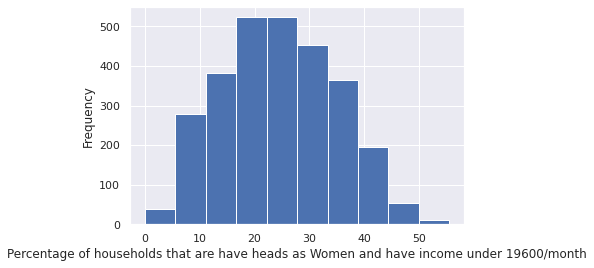

In [ ]:
# Plot the distribution
ax = train['target'].plot(kind='hist')
plt.xlabel('Percentage of households that are have heads as Women and have income under 19600/month')

In [ ]:
dataing=newData.copy()
dataing=dataing.drop(["ward","ADM4_PCODE"],1)
def displayboxgraph(headers):
    for i in headers : 
        #plt.figure(figsize=[8,5])
        #plt.figure(figsize=(20, 20))
        sns.boxplot(x=i,data=newData)
        plt.figure(figsize=(30,8))
        #plt.figure()
        #plt.title(i,fontsize=15)

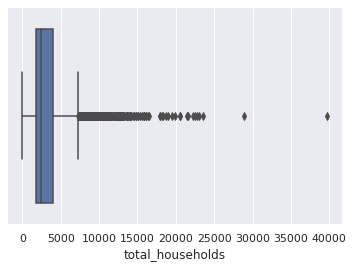

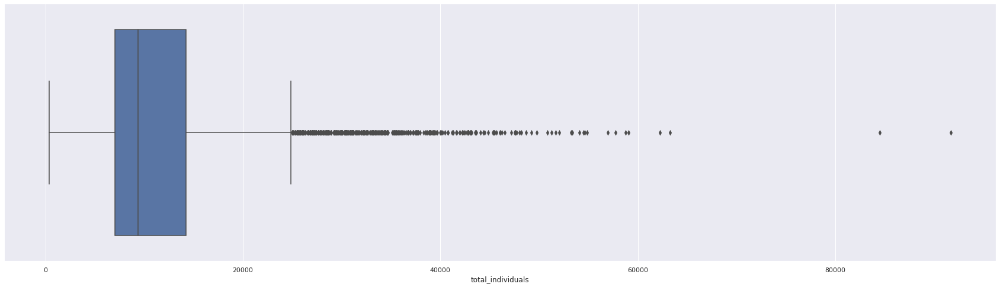

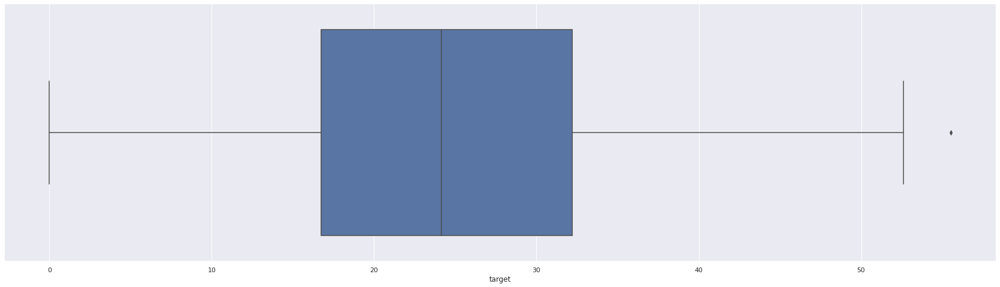

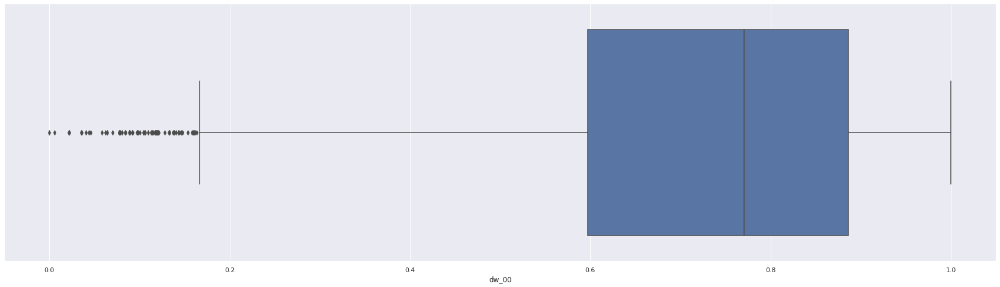

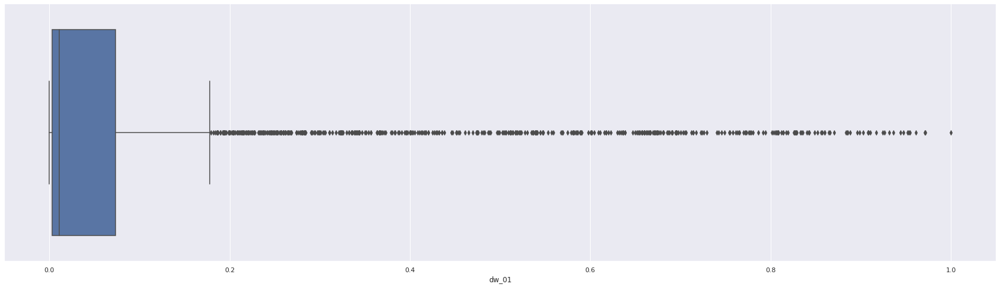

...

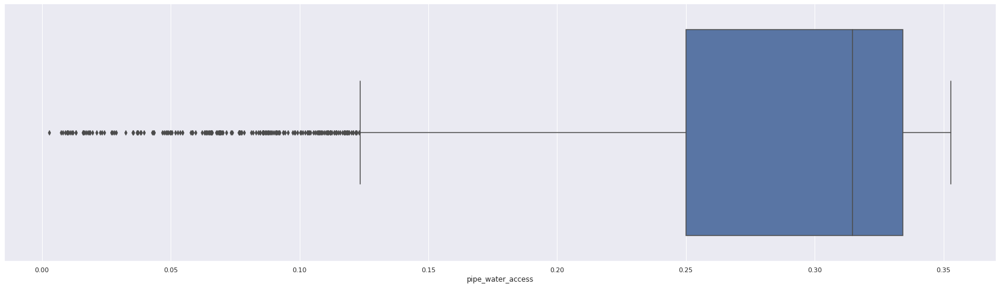

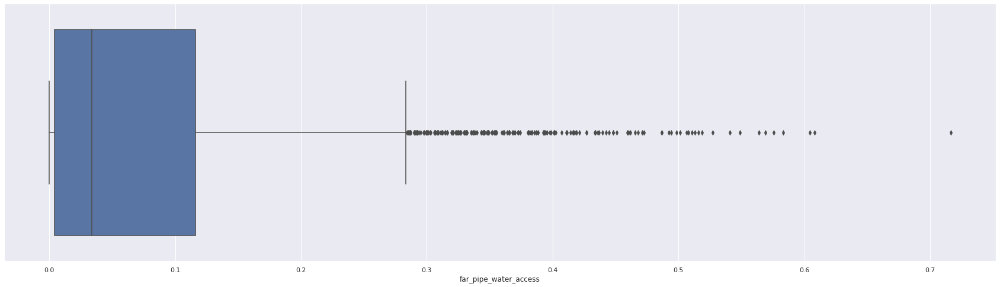

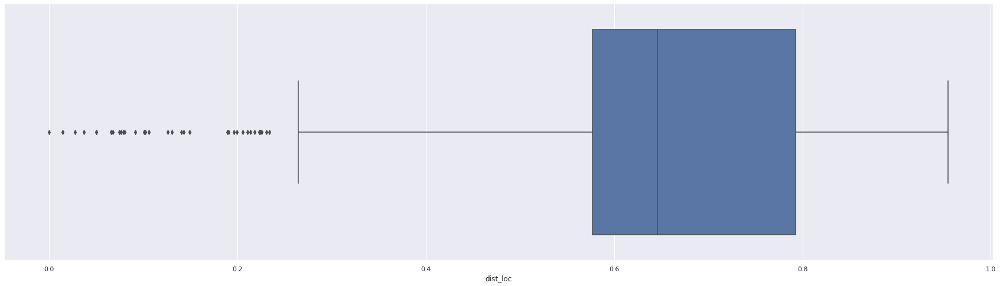

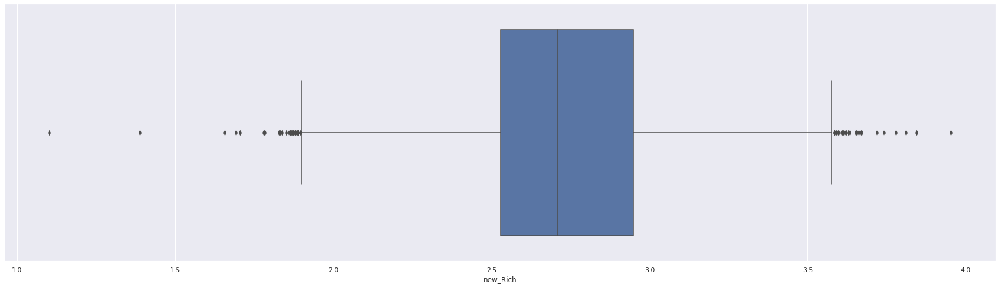

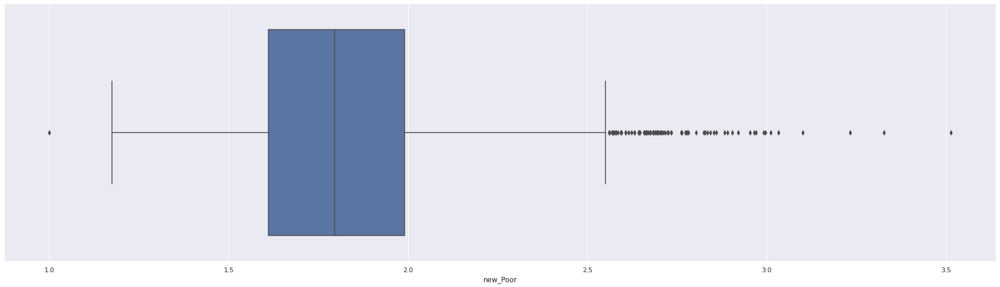

<Figure size 2160x576 with 0 Axes>

In [ ]:
displayboxgraph(list(dataing.columns.values))

In [ ]:
living_Quarters = ['dw_00','dw_01', 'dw_02', 'dw_03', 'dw_04', 'dw_05', 'dw_06', 'dw_07', 'dw_08','dw_09', 'dw_10',
                  'dw_11', 'dw_12', 'dw_13']
schools = ['psa_00', 'psa_01', 'psa_02', 'psa_03', 'psa_04']
language = ['lan_00', 'lan_01', 'lan_02', 'lan_03', 'lan_04',
       'lan_05', 'lan_06', 'lan_07', 'lan_08', 'lan_09', 'lan_10', 'lan_11',
       'lan_12', 'lan_13', 'lan_14']
population = ['pg_00', 'pg_01', 'pg_02', 'pg_03', 'pg_04']
access_Water = ['pw_00', 'pw_01', 'pw_02', 'pw_03', 'pw_04', 'pw_05','pw_06', 'pw_07', 'pw_08']
car_Land = ['stv_00', 'stv_01', 'car_00', 'car_01','lln_00', 'lln_01']
others = ['total_households', 'total_individuals', 'lat', 'lon', 'NL']
newDatas = newData.drop(['ADM4_PCODE','ward'],1)

In [ ]:
def displayreglinegraph(headers):
    for i in headers : 
        #plt.figure(figsize=[8,5])
        plt.figure(figsize=(20, 20))
        sns.regplot(x=i, y=newData["target"],data=newData)
        plt.figure(figsize=(20, 20))
        #plt.title(i,fontsize=15)

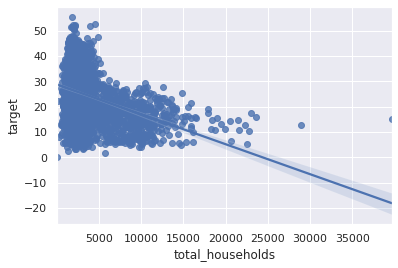

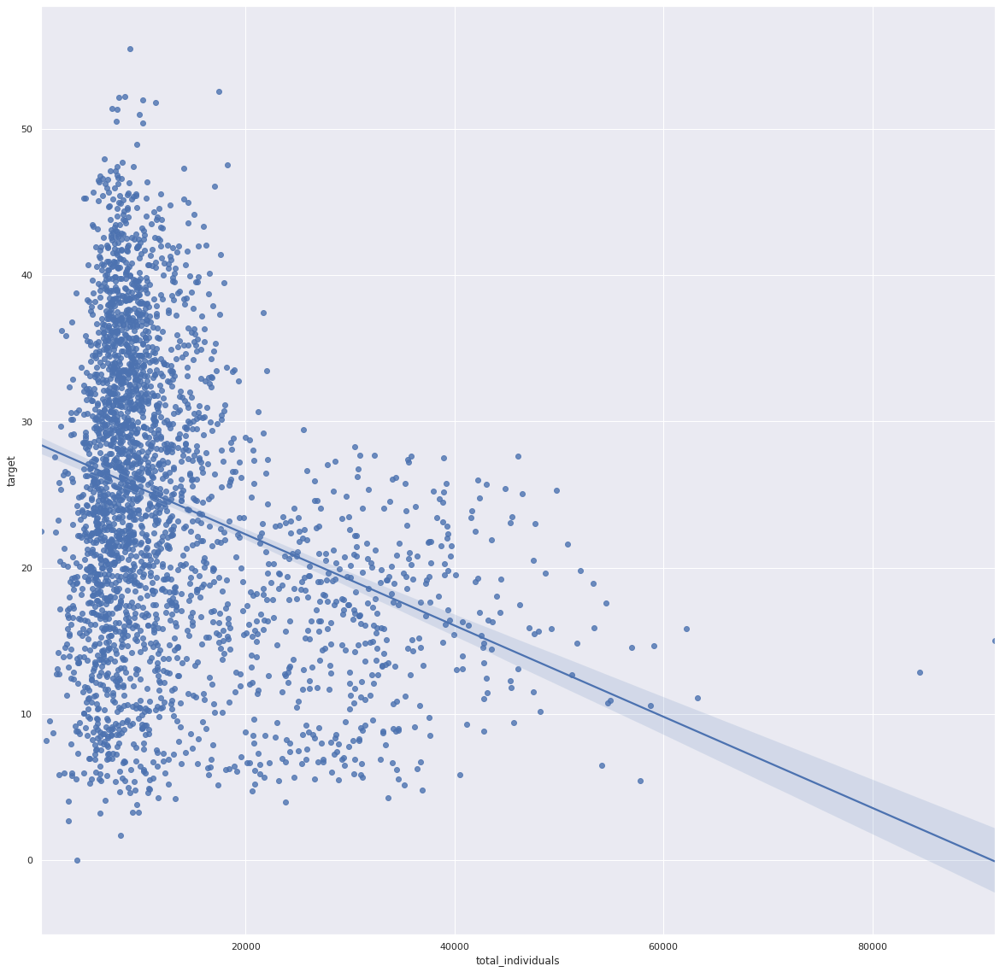

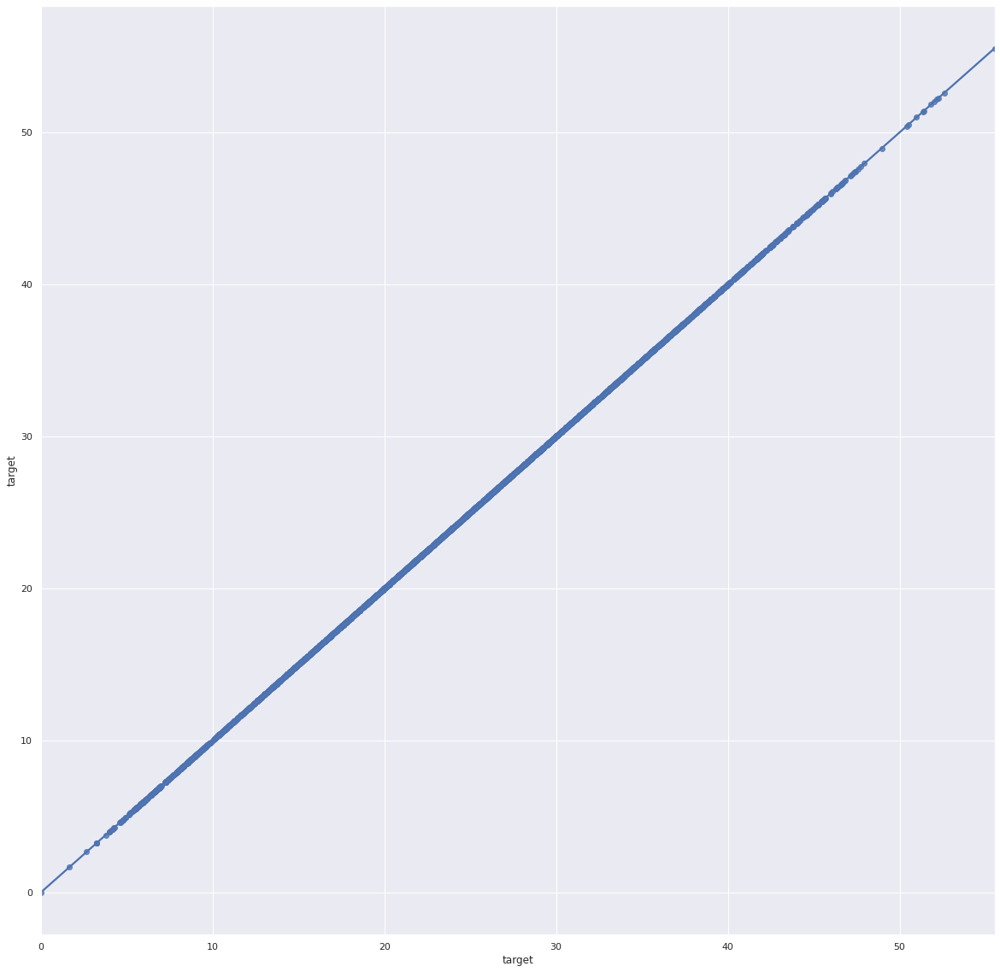

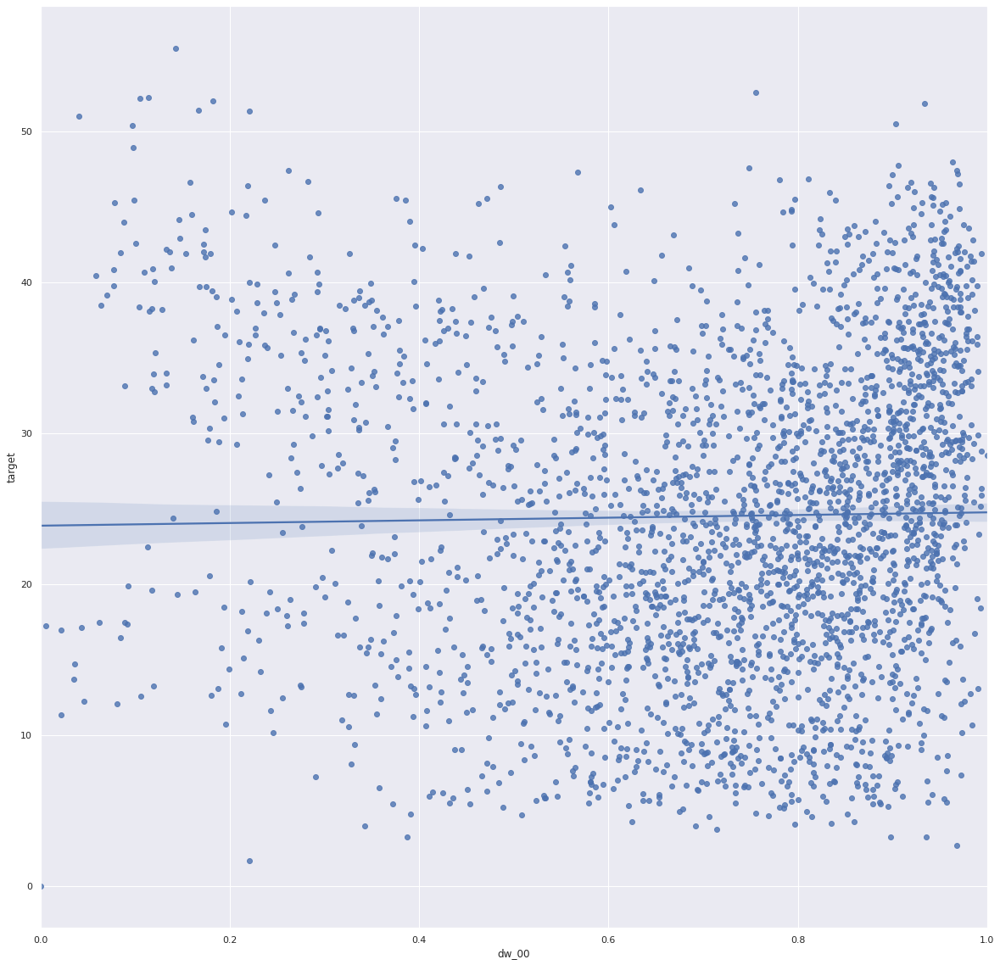

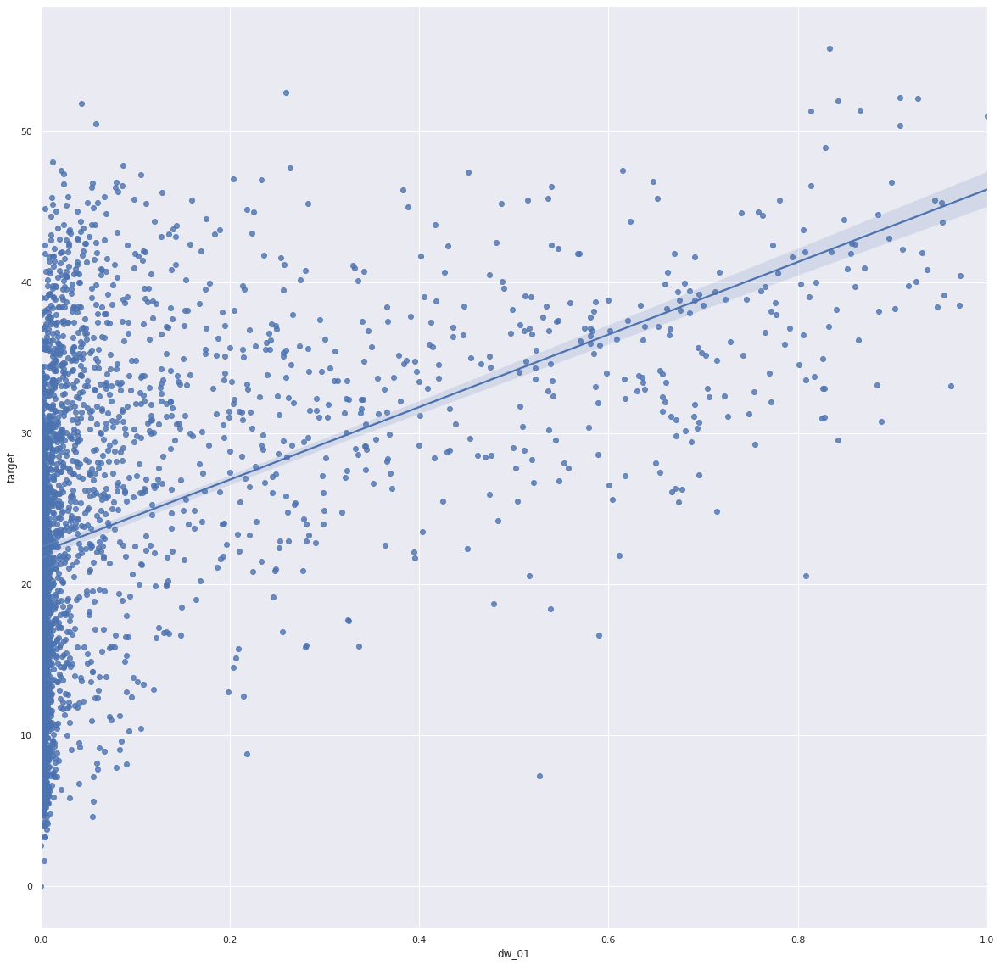

...

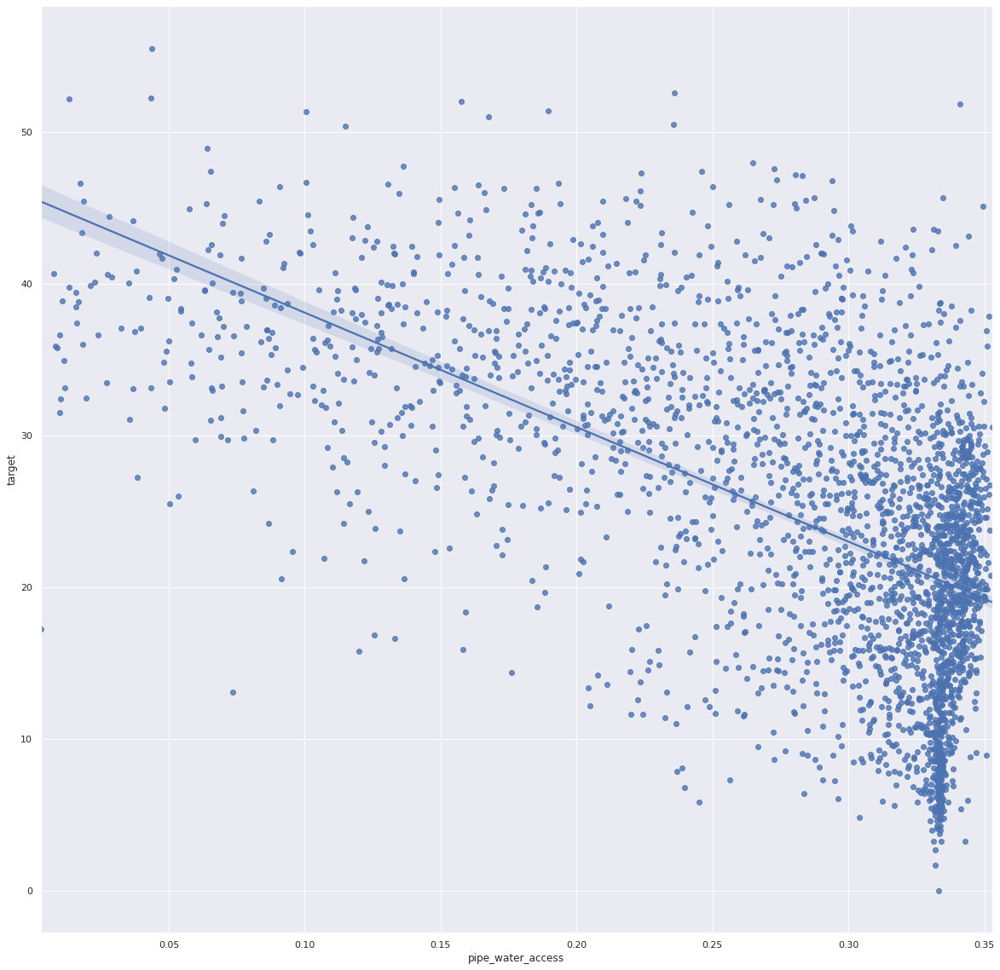

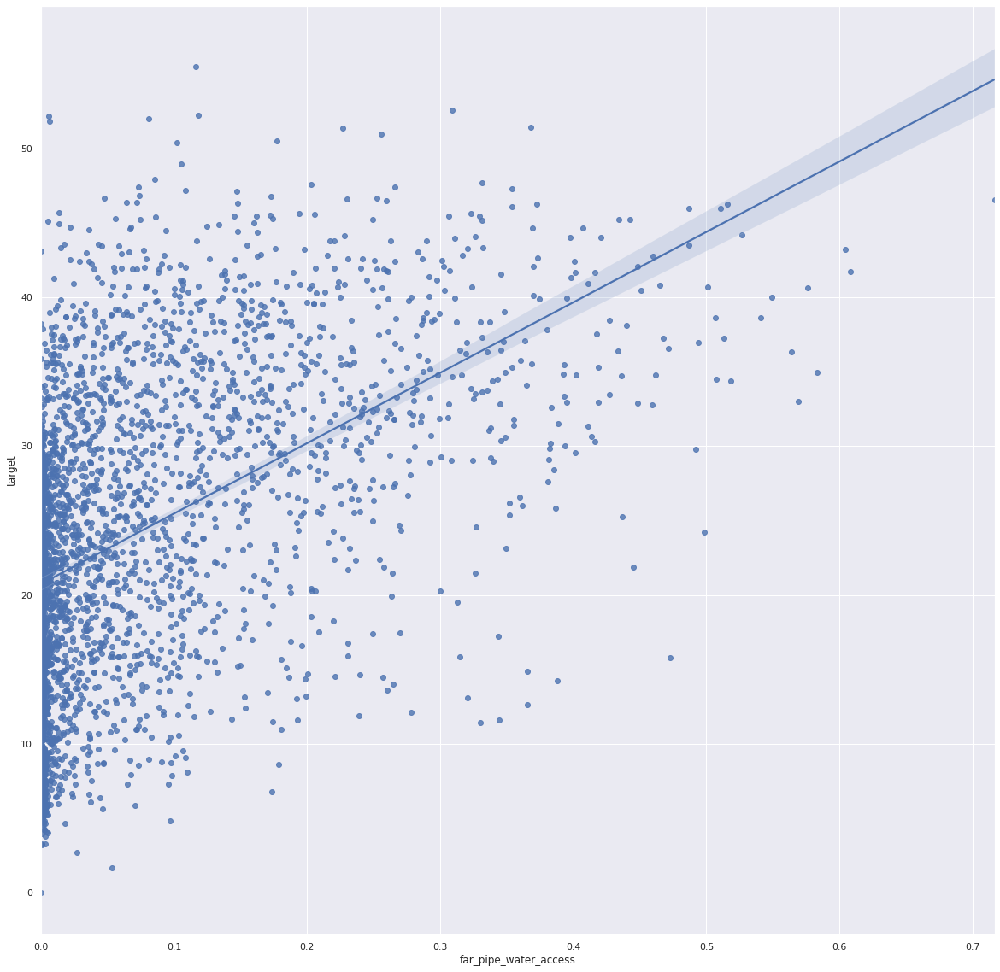

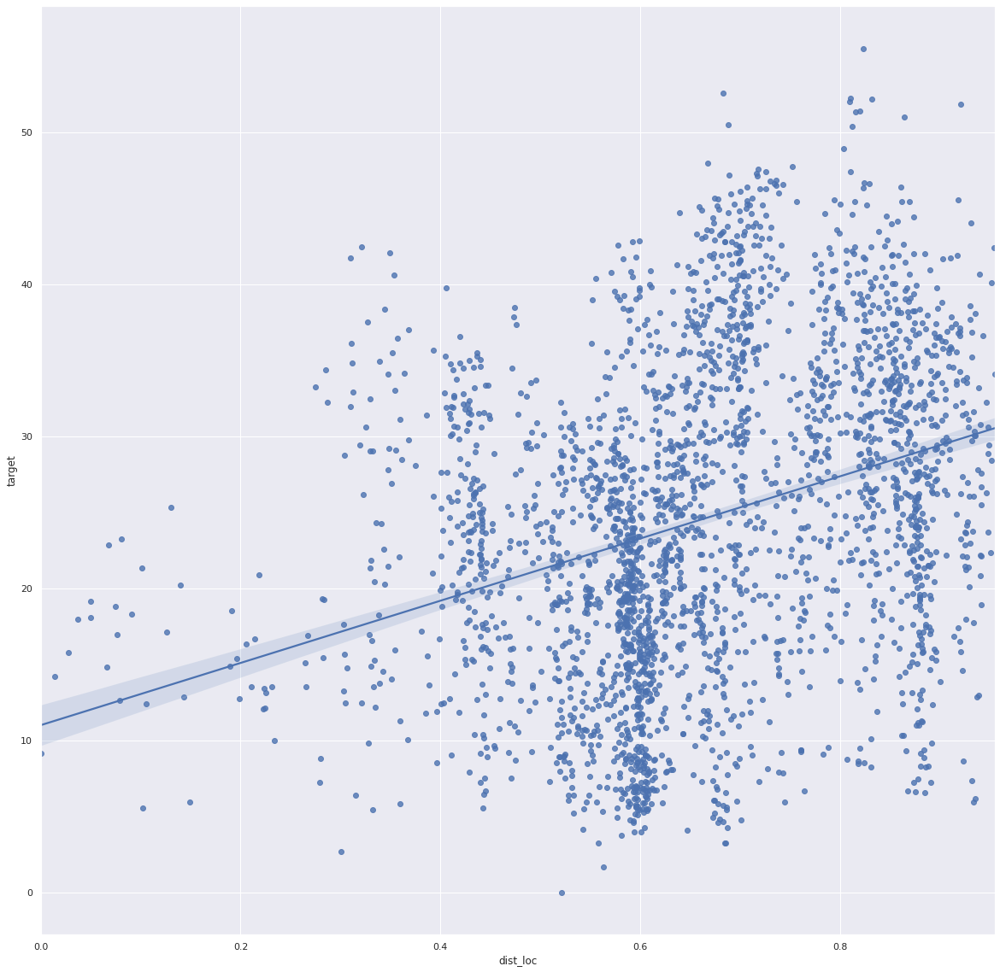

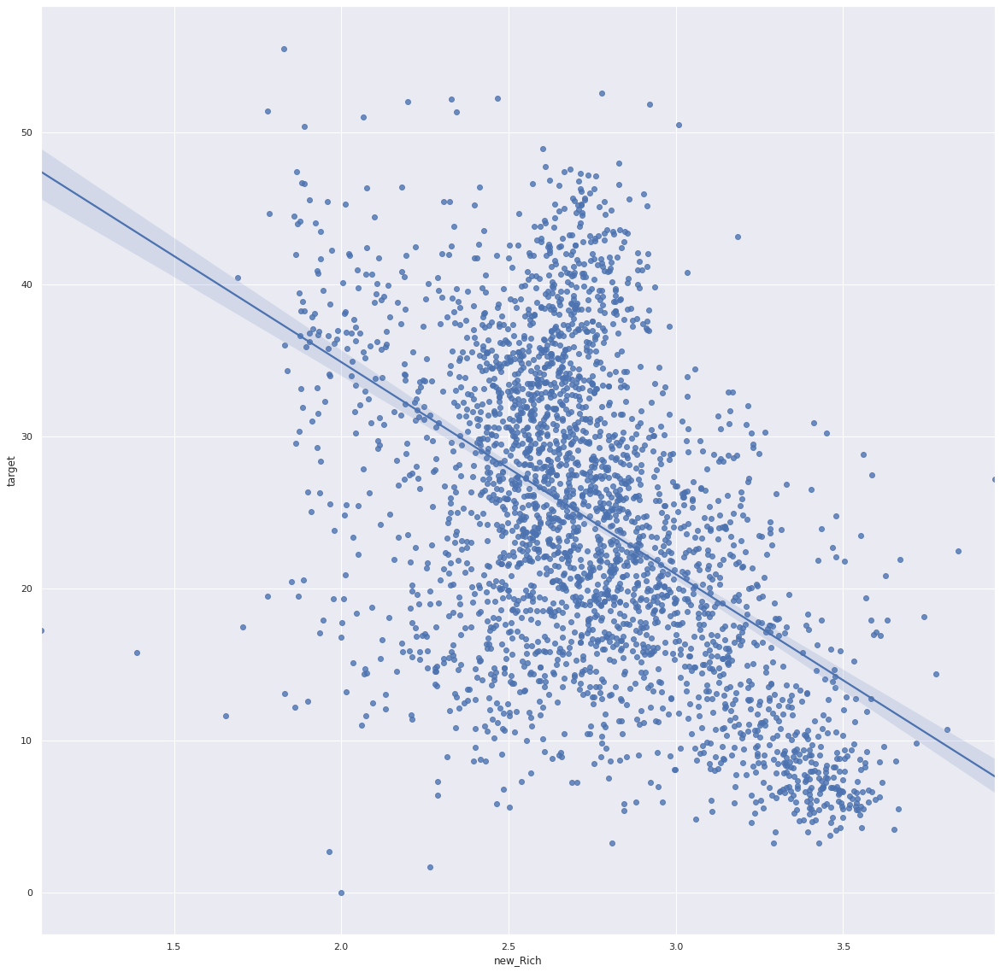

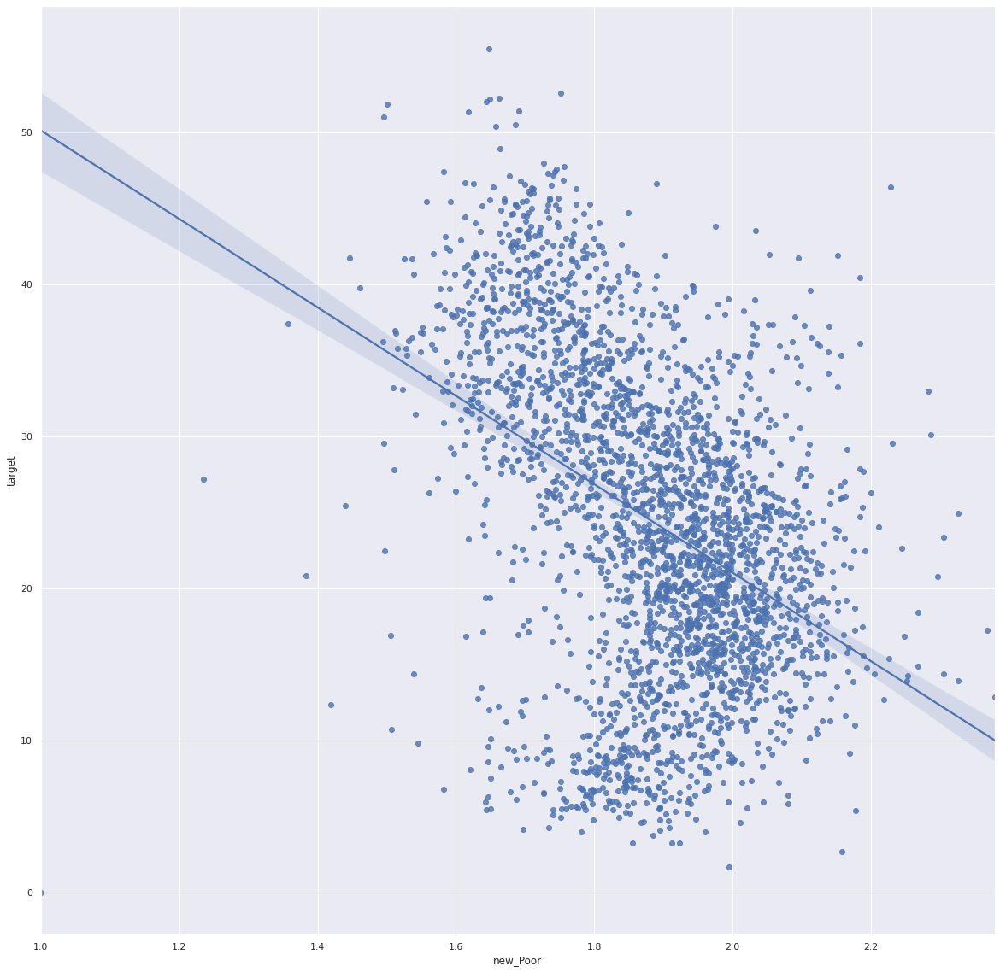

<Figure size 1440x1440 with 0 Axes>

In [ ]:
displayreglinegraph(list(newDatas.columns.values))

In [ ]:
def displaygraphs(headers):
    for i in headers : 
        #plt.figure(figsize=[8,5])
        sns.scatterplot(x=i, y='target', data=newData)
        plt.figure(figsize=(20, 20))
        #plt.title(i,fontsize=15)

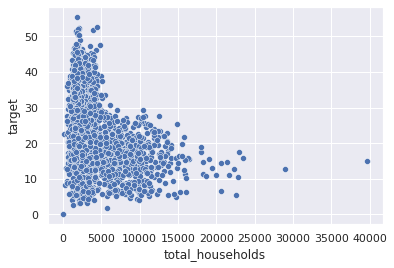

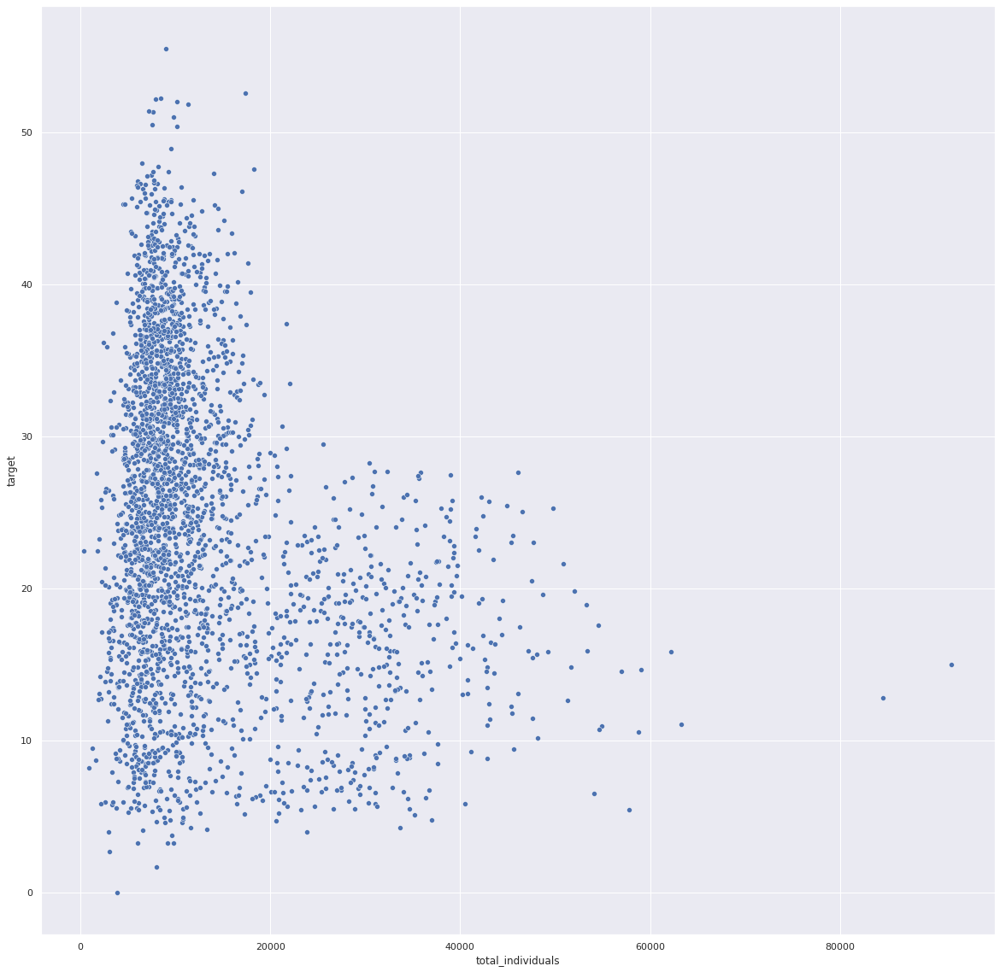

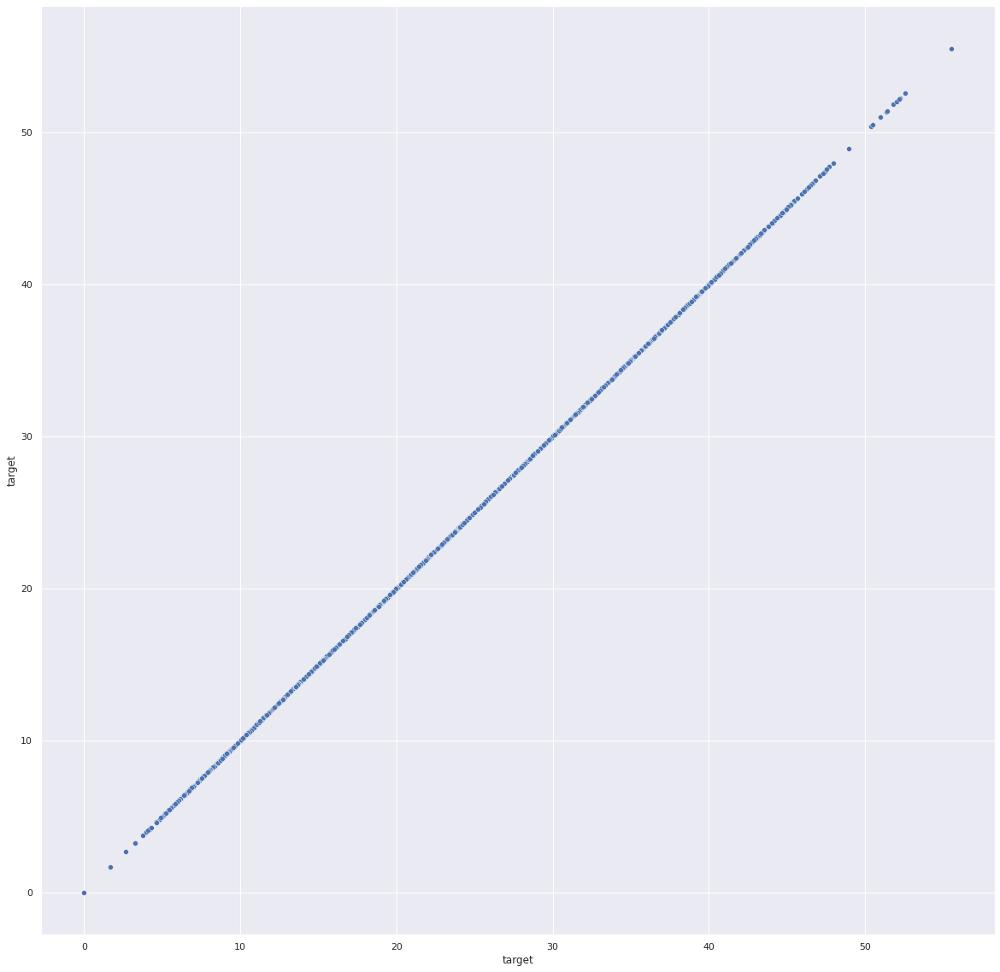

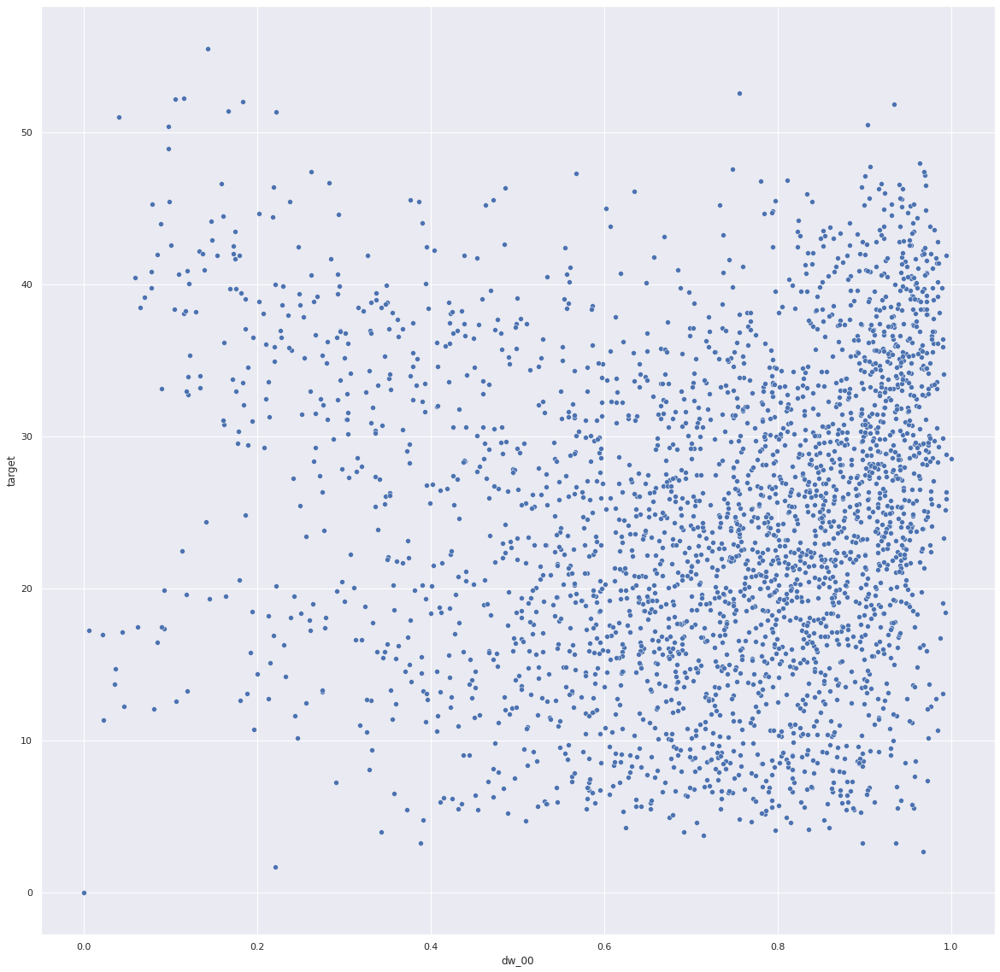

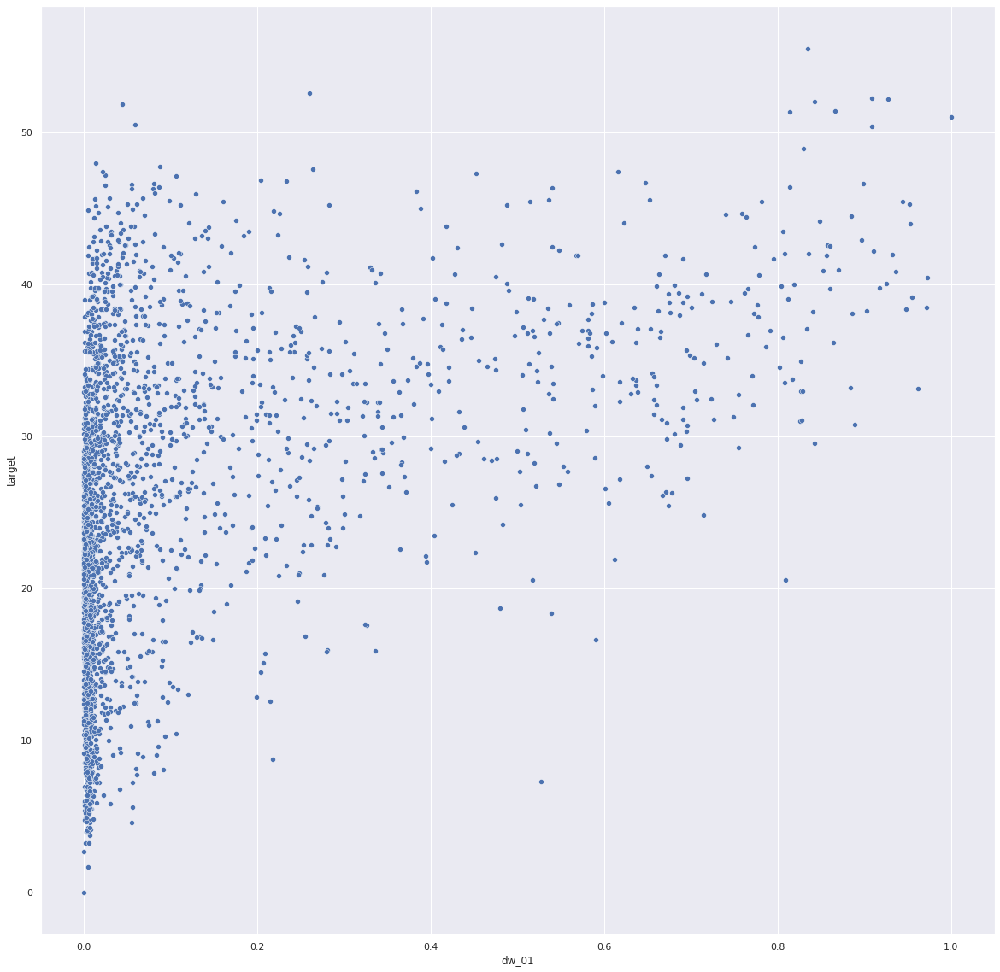

...

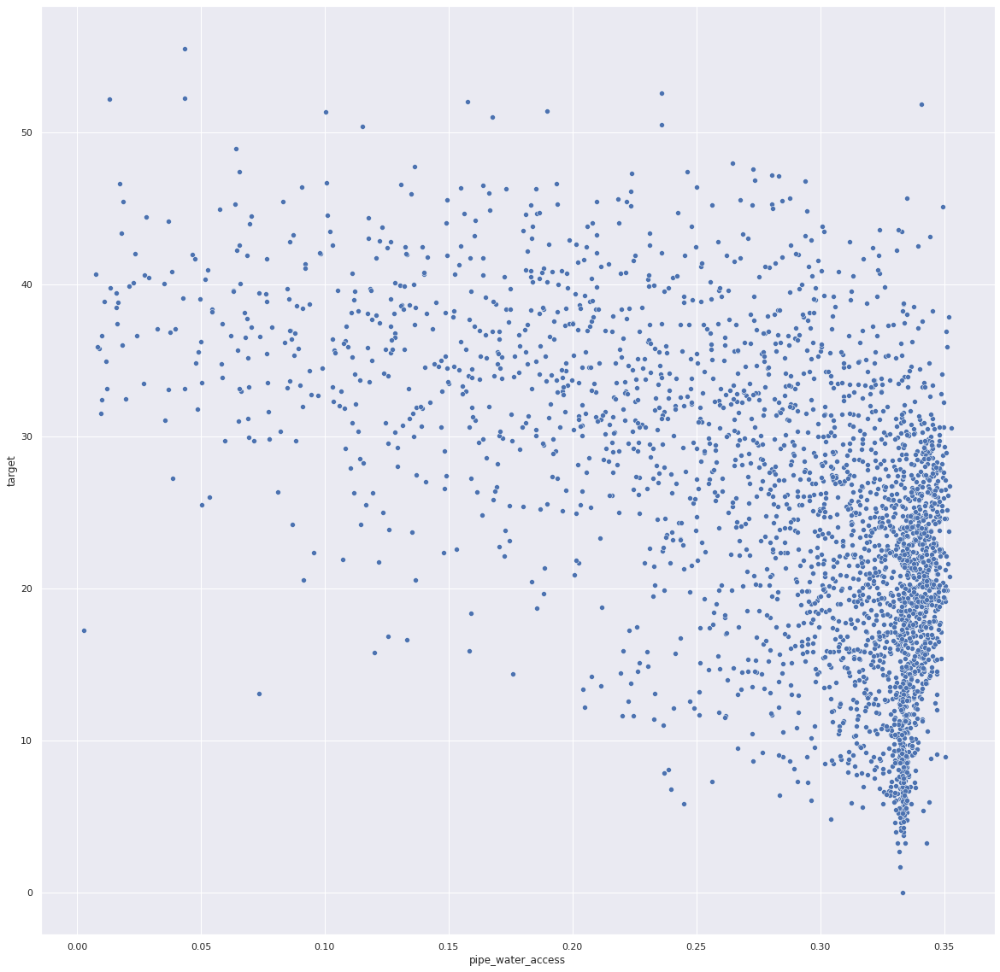

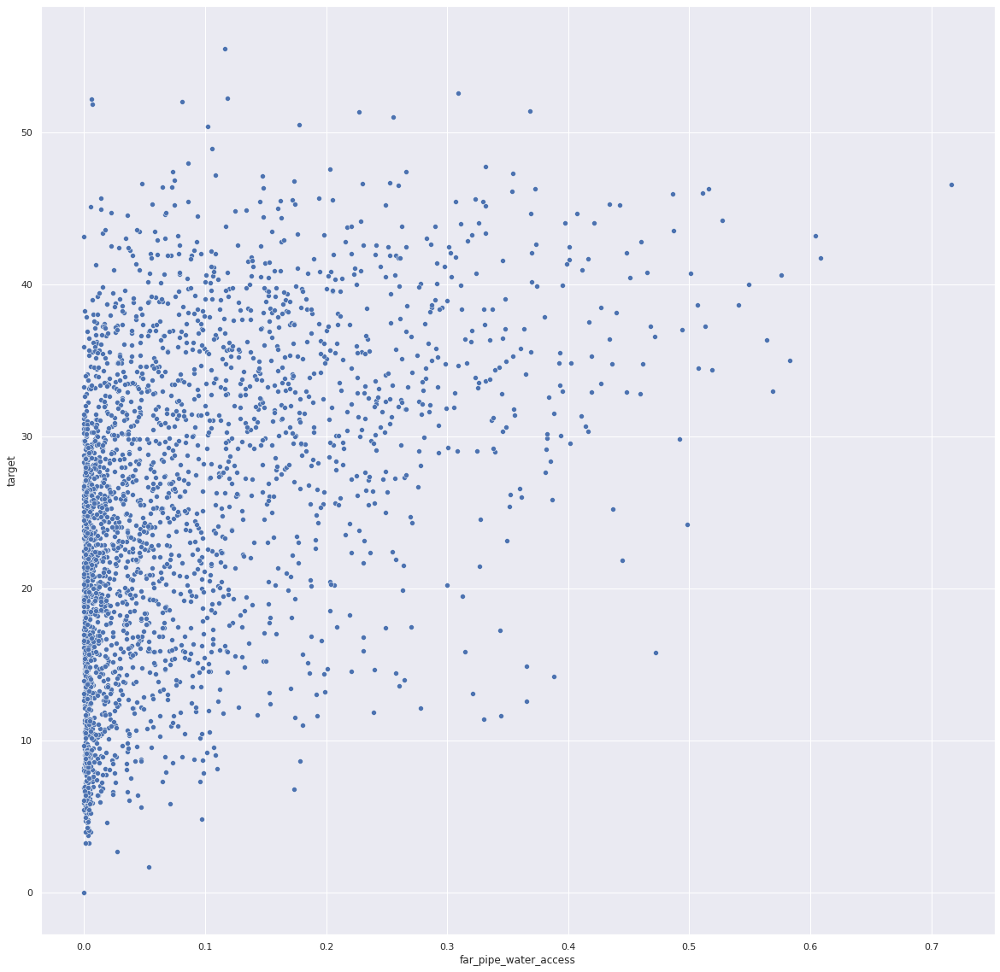

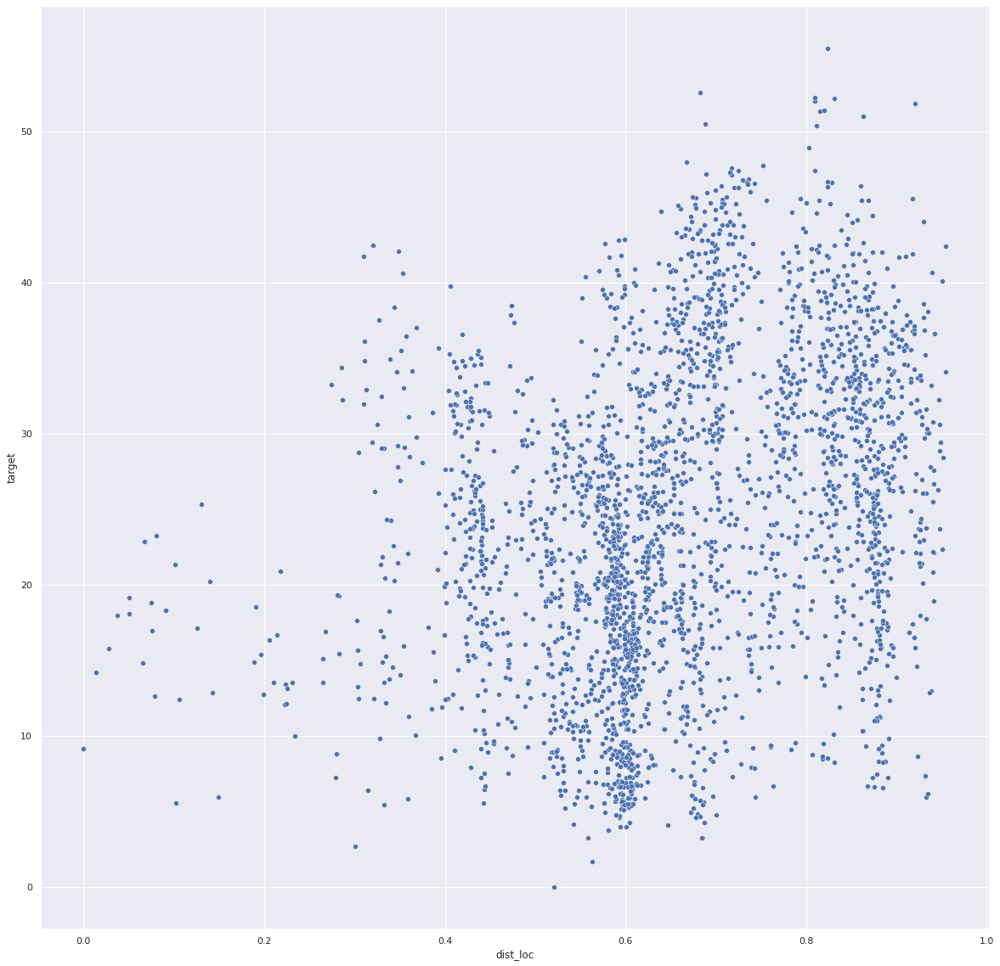

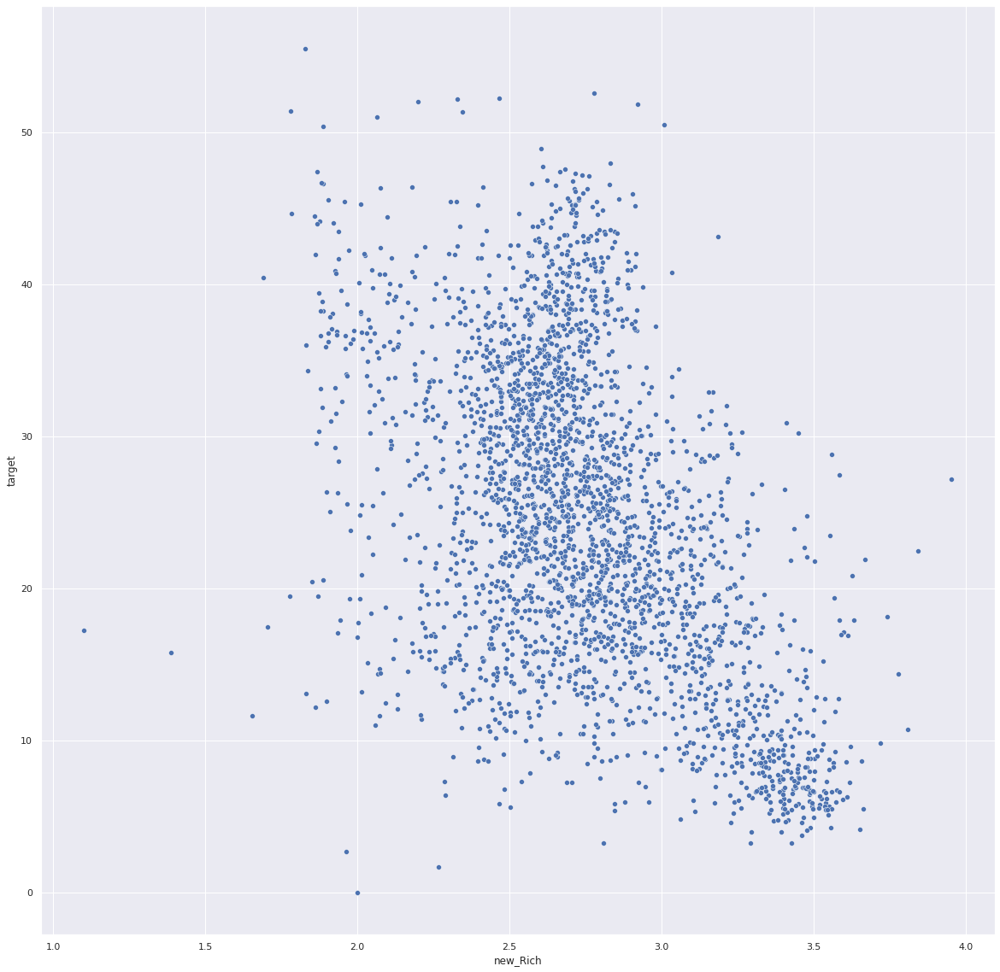

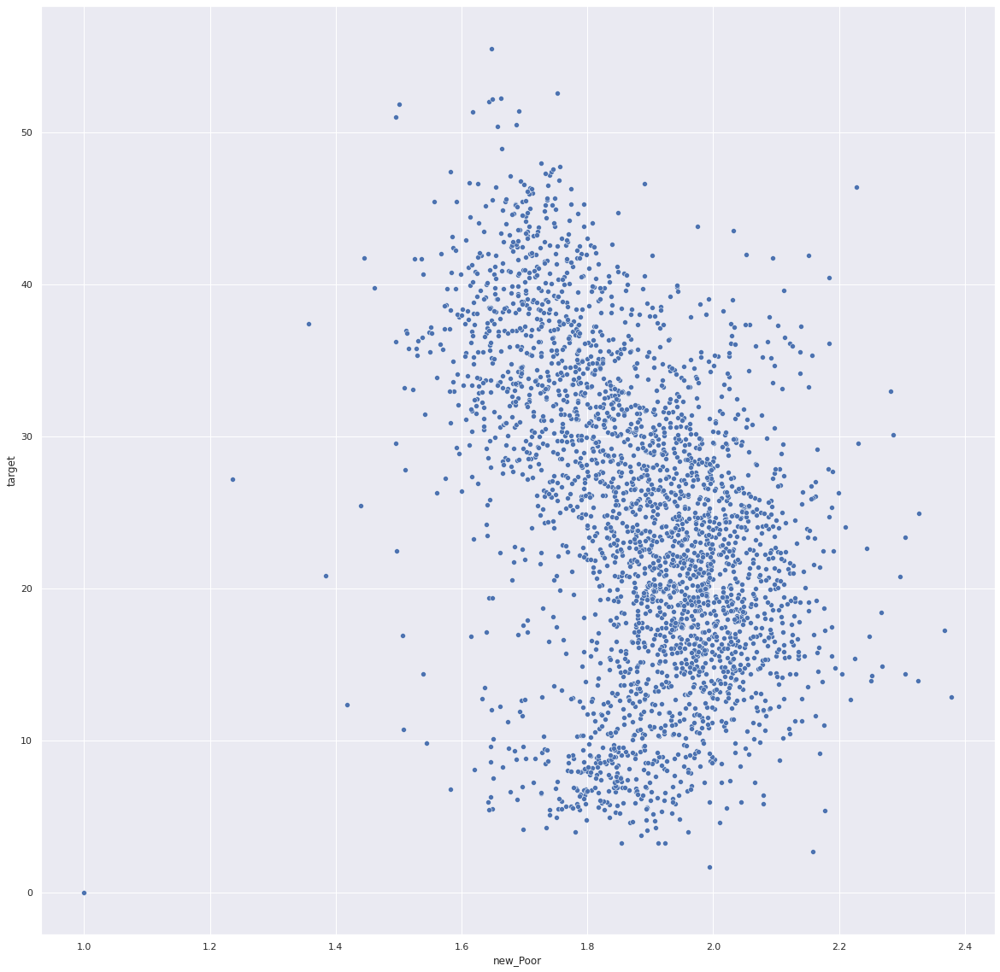

<Figure size 1440x1440 with 0 Axes>

In [ ]:
displaygraphs(list(newDatas.columns.values))

In [ ]:
def displaygraph(headers):
    for i in headers : 
        plt.figure(figsize=[10,7])
        plt.scatter(x=i, y='target', data=newData)
        #plt.figure()
        plt.title(i,fontsize=15)

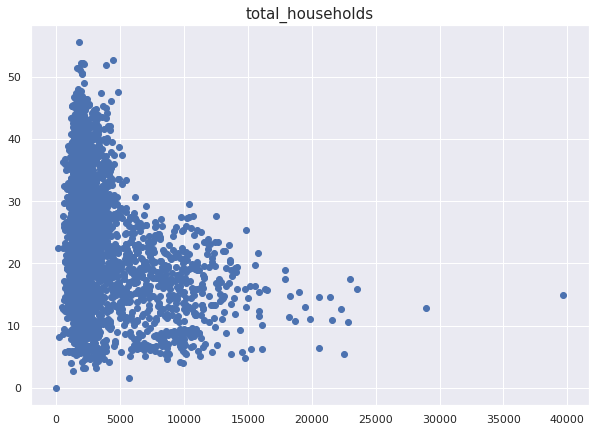

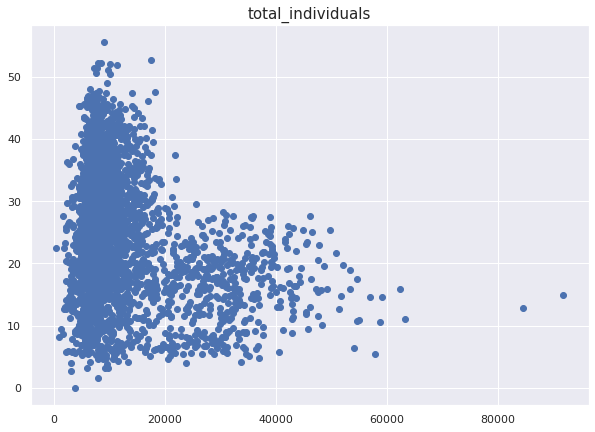

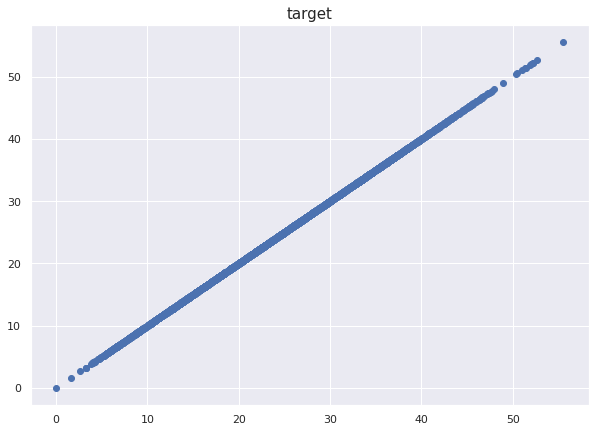

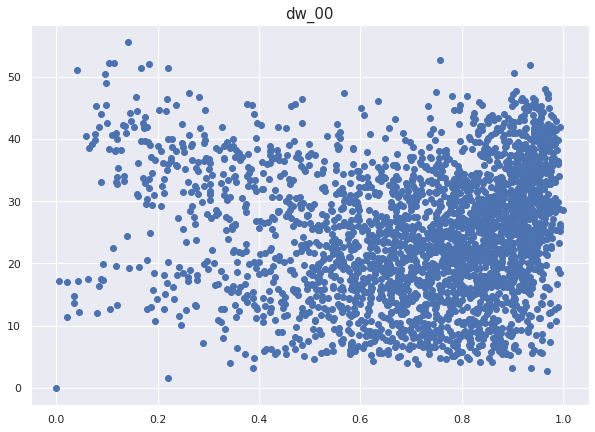

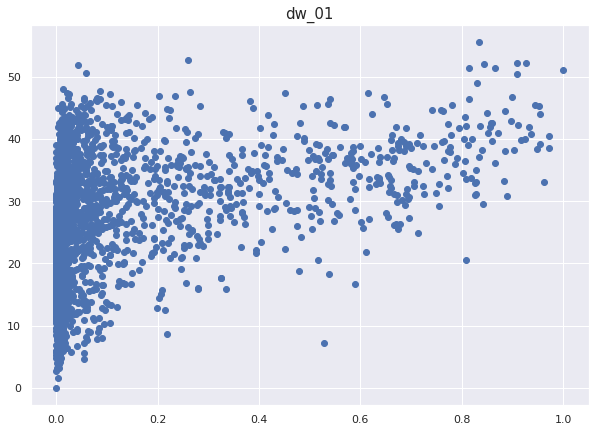

...

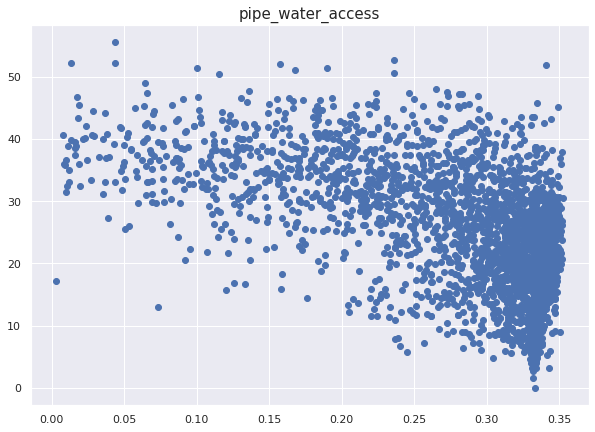

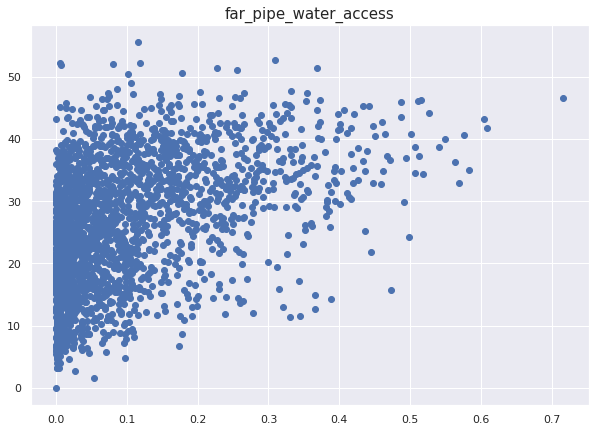

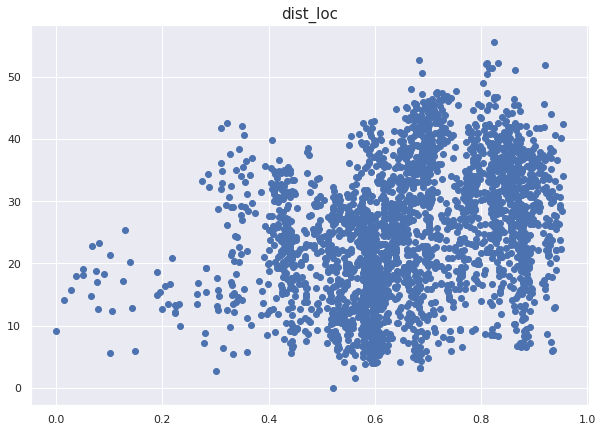

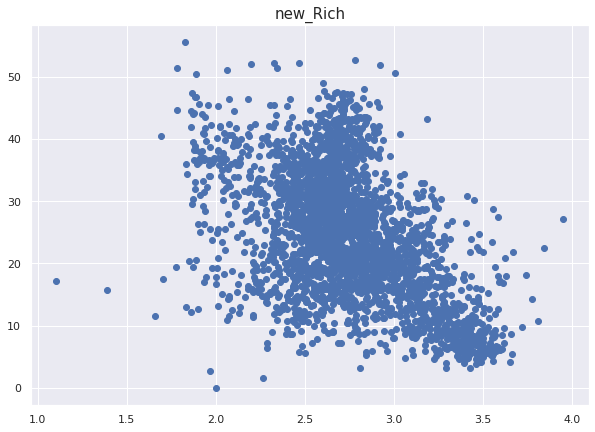

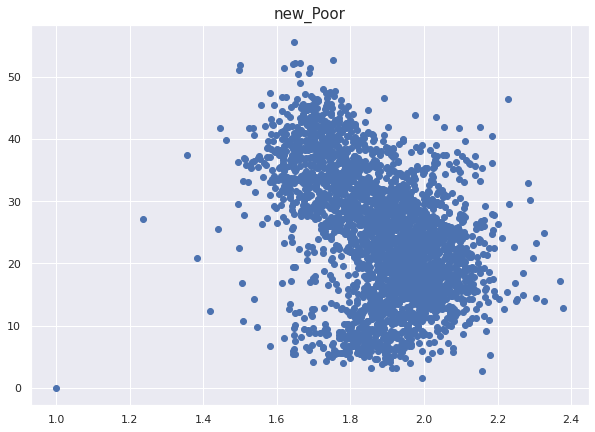

In [ ]:
displaygraph(list(newDatas.columns.values))

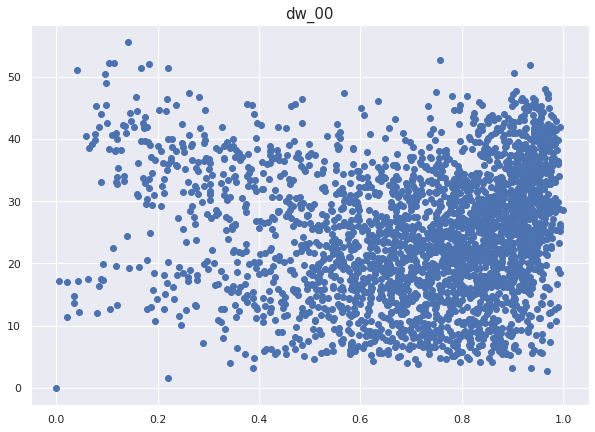

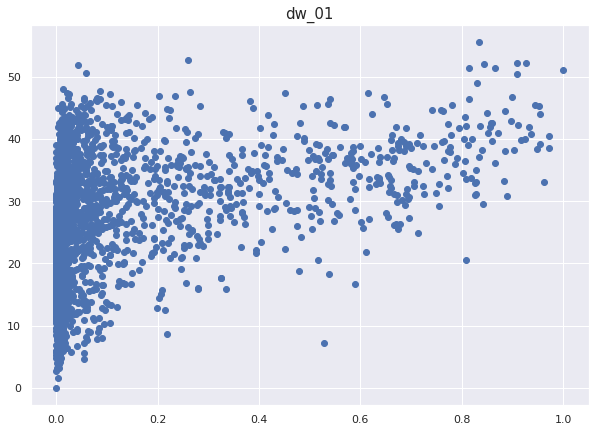

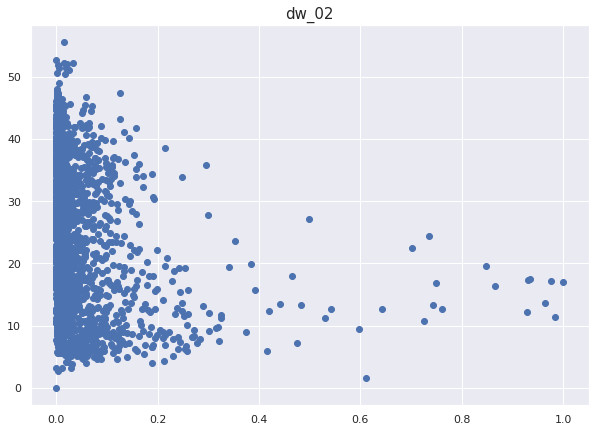

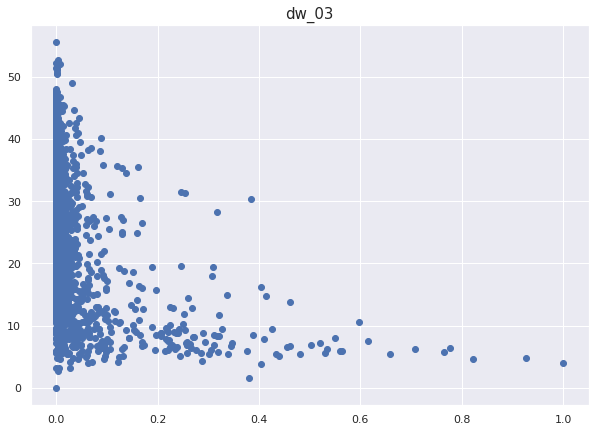

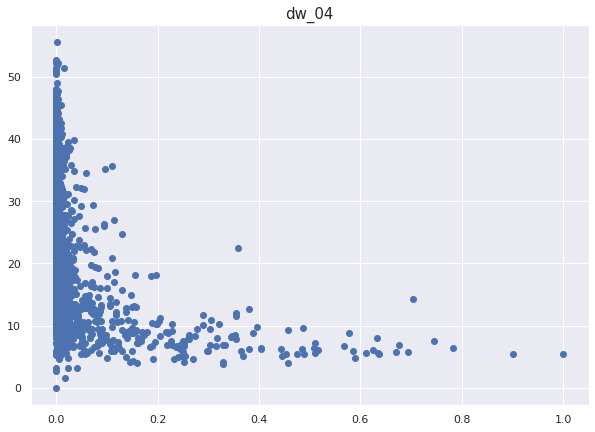

...

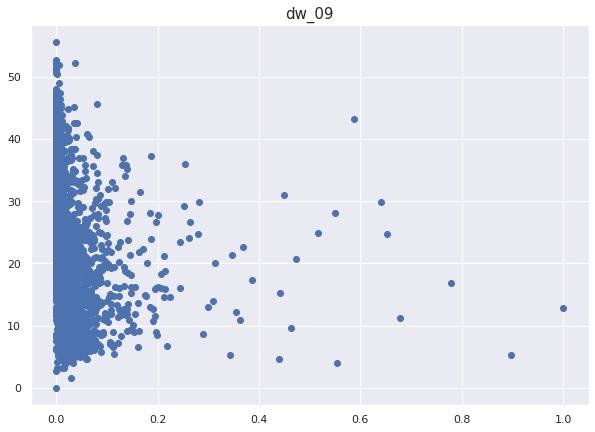

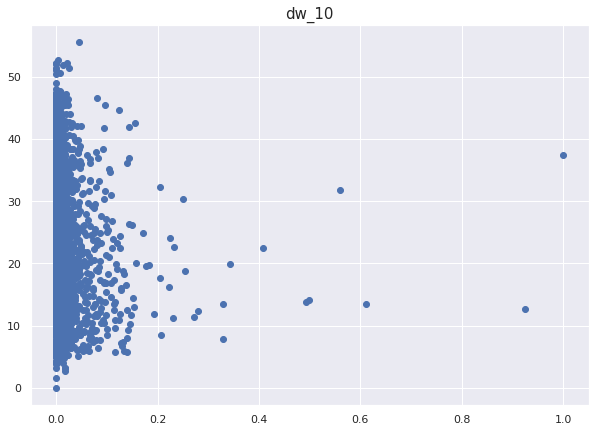

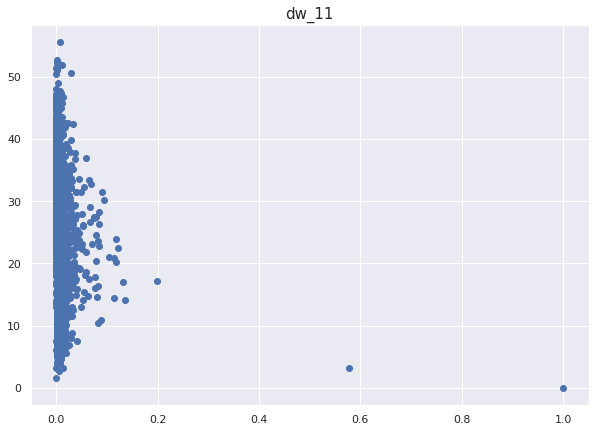

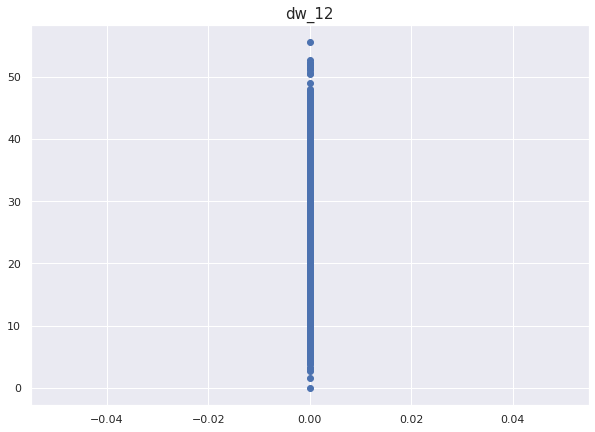

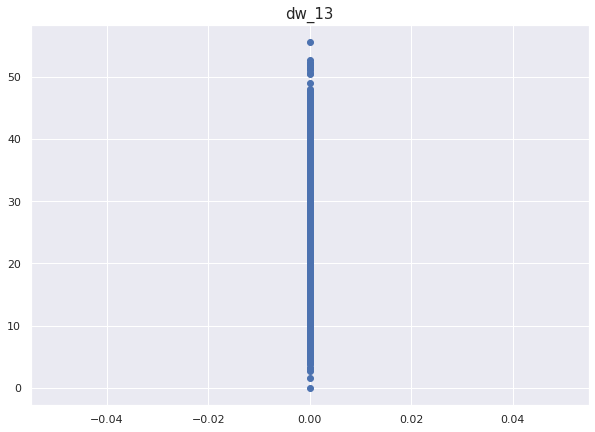

In [ ]:
displaygraph(living_Quarters)

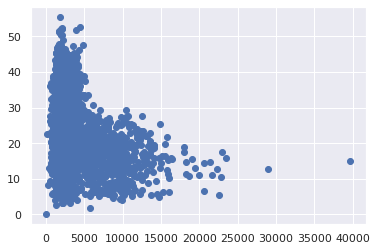

In [ ]:
plt.scatter(x='total_households', y='target', data=train)

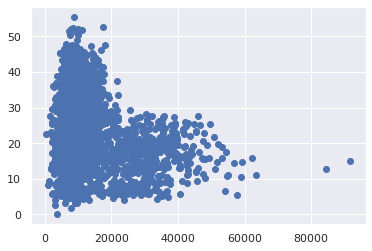

In [ ]:
plt.scatter(x='total_individuals', y='target', data=train)

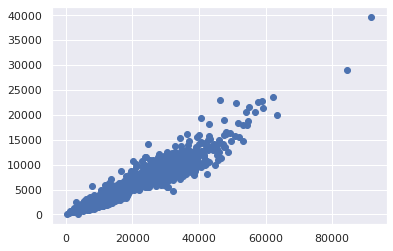

In [ ]:
plt.scatter(x='total_individuals', y='total_households', data=train)

In [ ]:
def displaygraph(headers):
    for i in headers : 
        plt.figure(figsize=[8,5])
        plt.hist(train[i], color='r',alpha=1, rwidth=0.75)
        plt.title(i,fontsize=15)

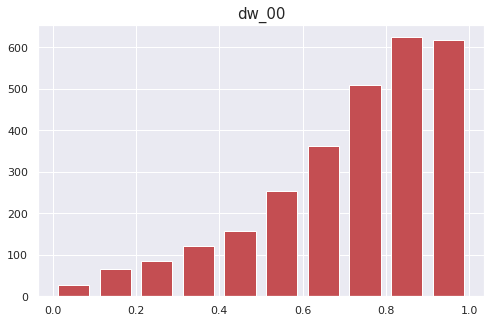

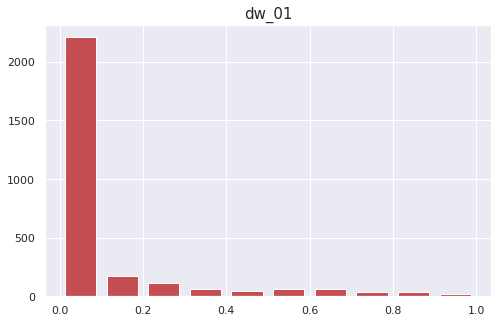

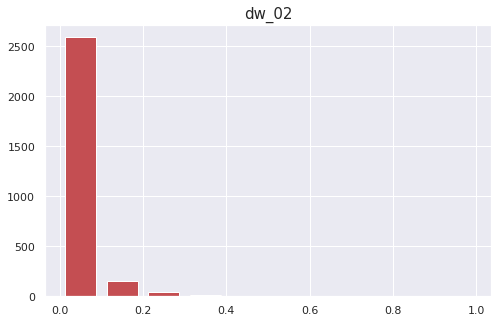

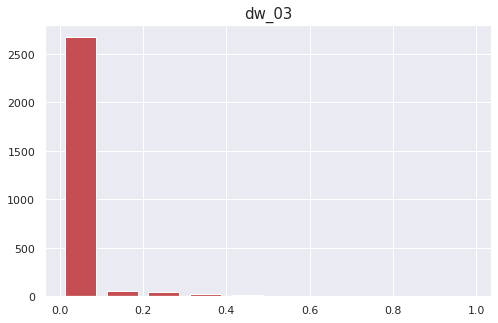

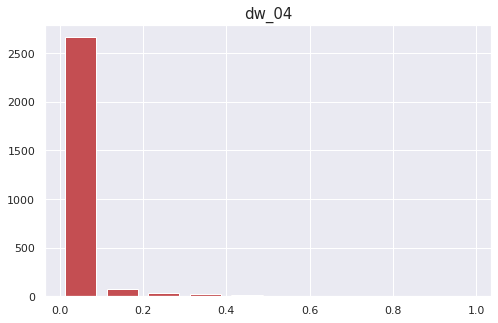

...

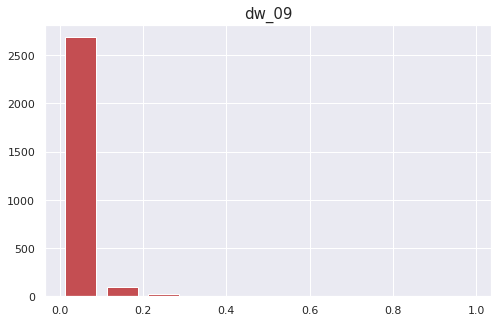

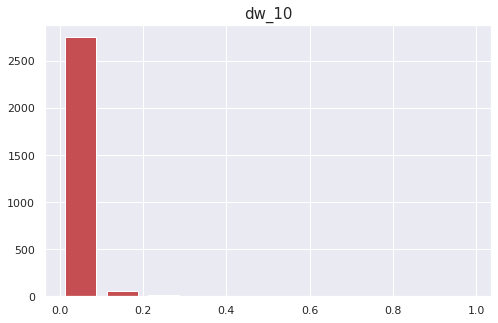

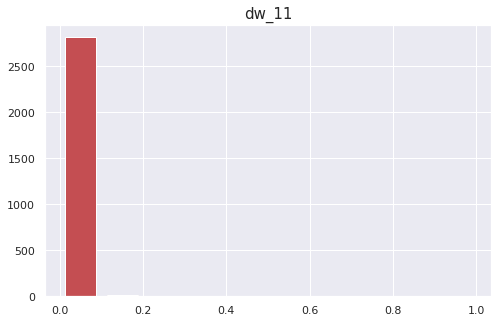

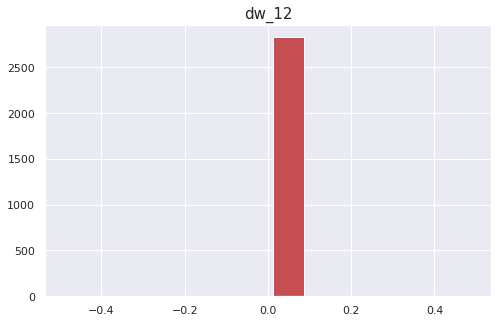

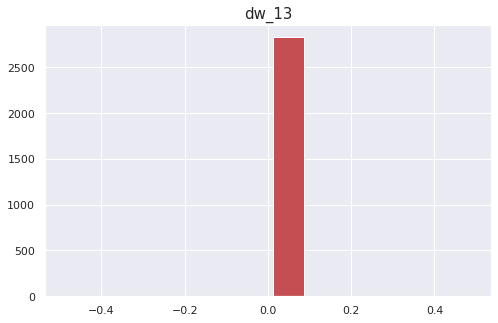

In [ ]:
displaygraph(living_Quarters)

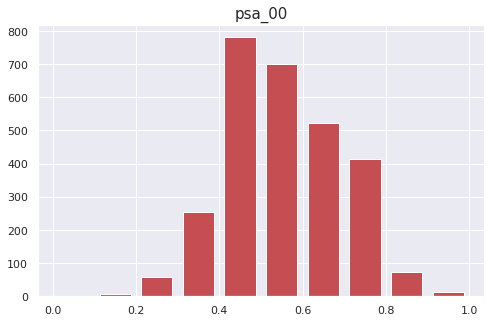

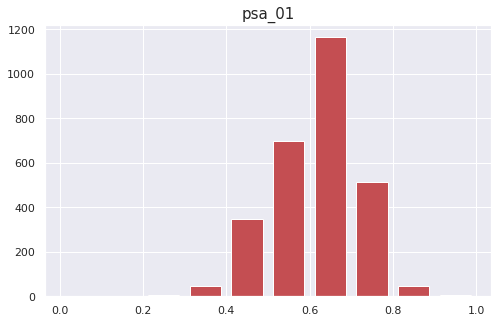

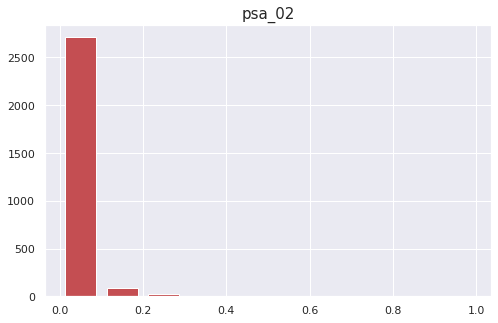

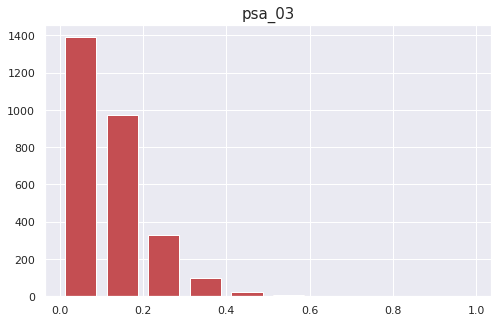

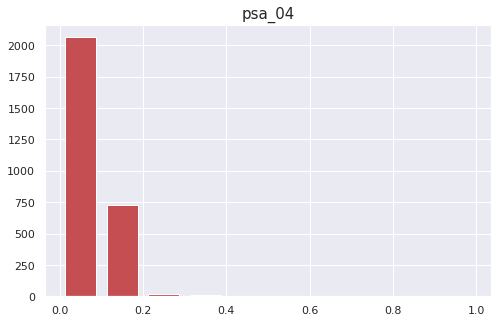

In [ ]:
displaygraph(schools)

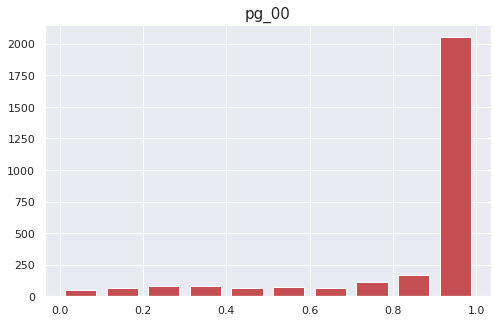

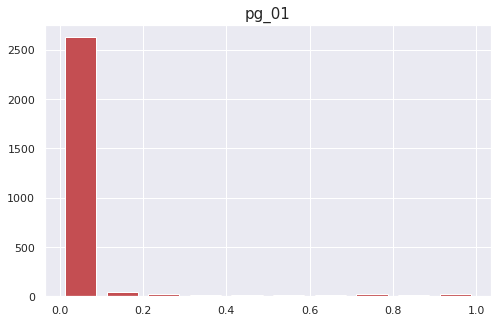

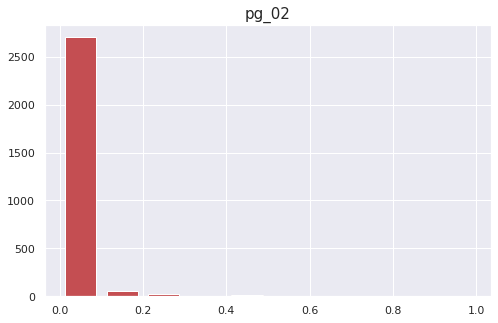

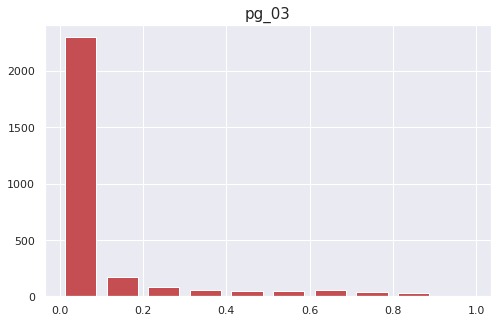

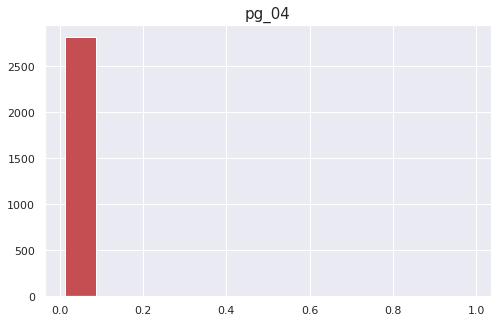

In [ ]:
displaygraph(population)

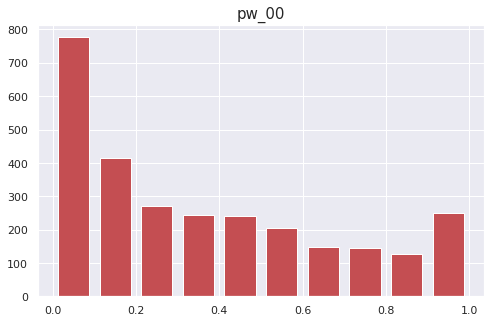

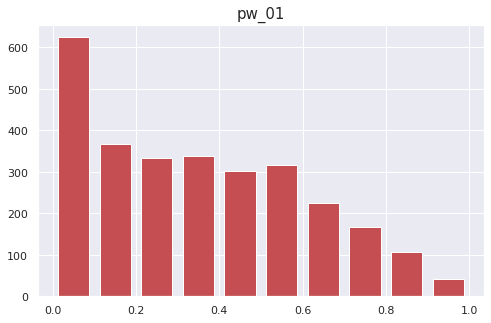

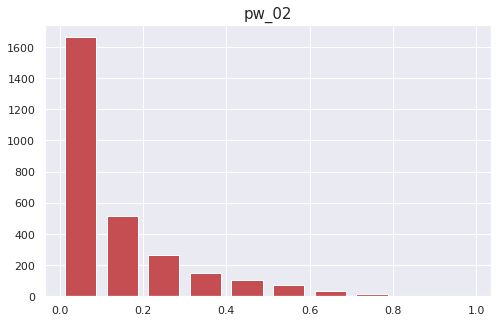

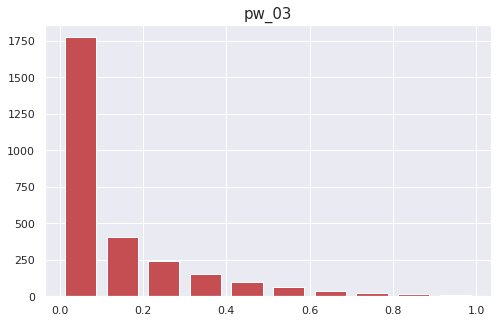

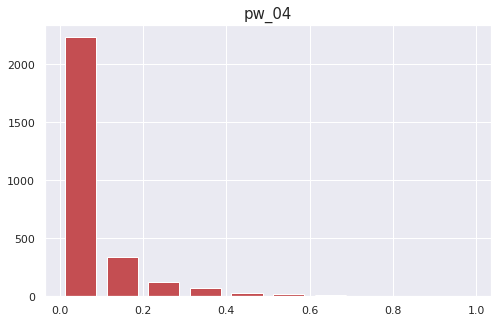

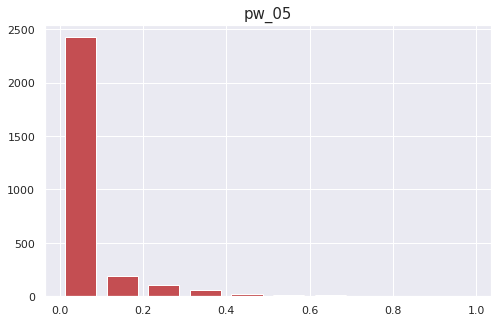

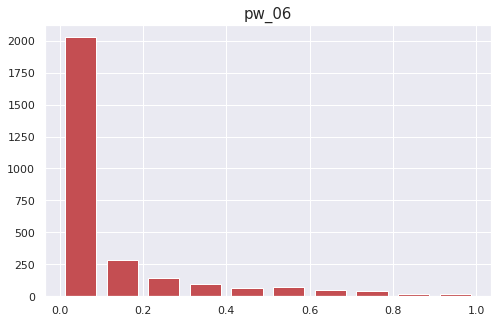

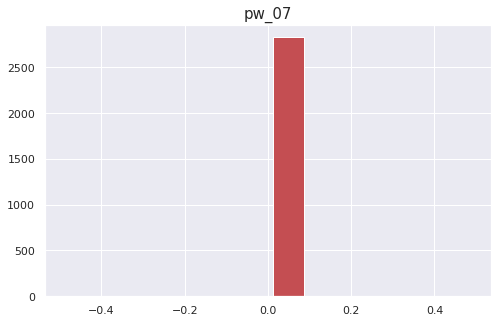

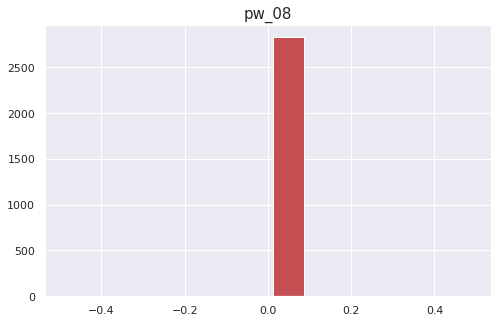

In [ ]:
displaygraph(access_Water)

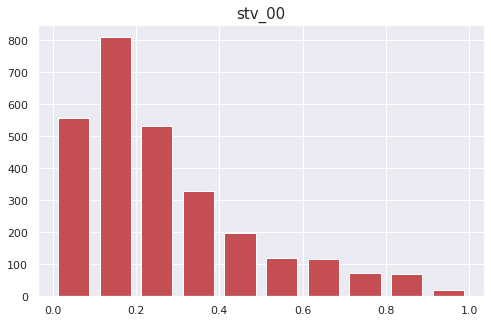

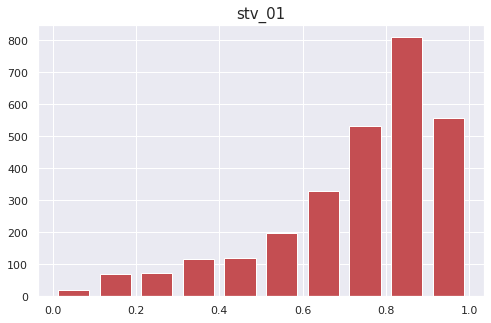

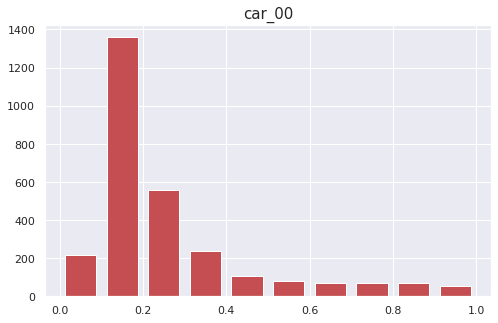

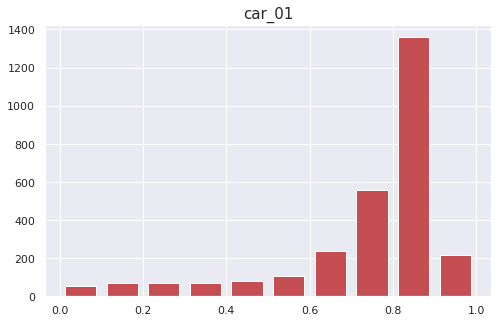

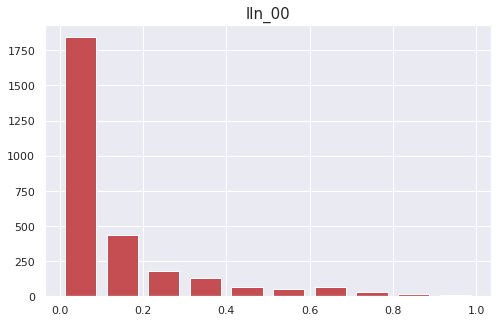

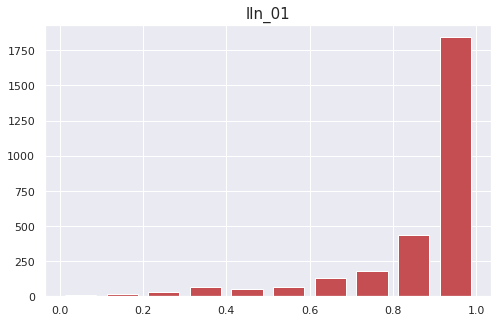

In [ ]:
displaygraph(car_Land)

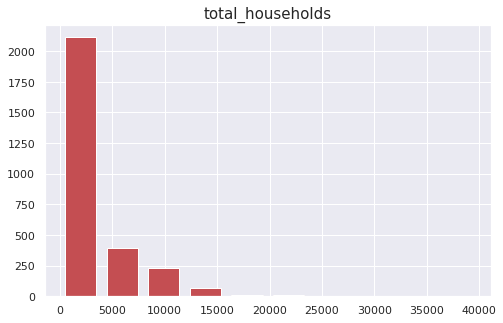

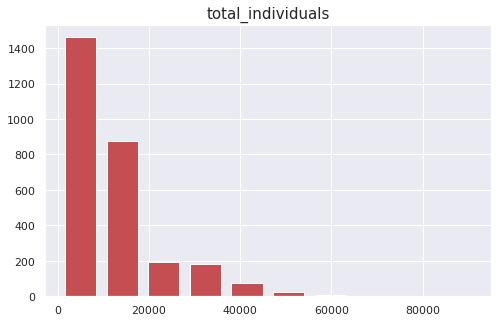

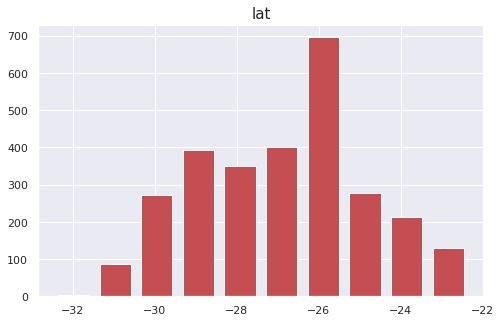

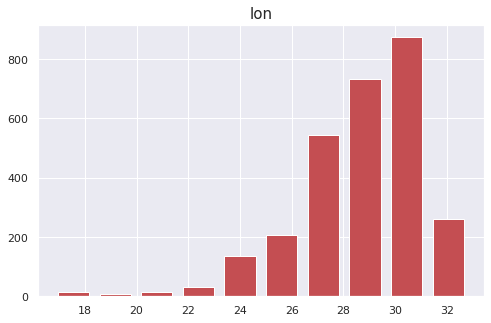

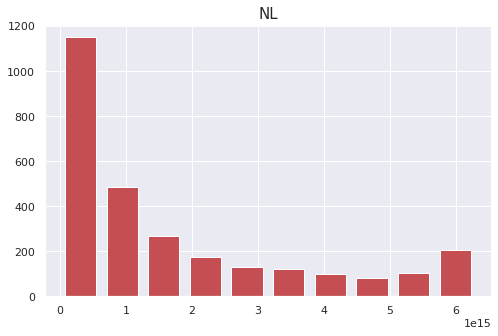

In [ ]:
displaygraph(others)

In [ ]:
newData['target'].head()

0    16.773757
1    21.496661
2    10.931425
3    23.119257
4    13.652252
Name: target, dtype: float64

#Feature Importance Section

In [ ]:
#OLD
#new_Y = pd.DataFrame(train)["target"]
#new_X = newData.drop(['ward', 'ADM4_PCODE', 'target'],1)
#new_X = pd.DataFrame(newData)

In [ ]:
#OLD
#new_Y = pd.DataFrame(train)["target"]
#new_X = newData.drop(['ward', 'ADM4_PCODE', 'target'],1)
#X_train, X_test, y_train, y_test = train_test_split(new_X, new_Y, test_size = 0.3, random_state = 29)
#categorical_features_indices = np.where(X_train.dtypes == np.object)[0]

In [ ]:
finalDf = lastingData.copy()
new_Y = pd.DataFrame(finalDf)['target']
new_X = finalDf.drop(['target','ward',"ADM4_PCODE"],axis=1)
X_train, X_test, y_train, y_test = train_test_split(new_Xing, new_Ying, test_size = 0.3, random_state = 29)

In [ ]:
'''
import pandas as pd
from sklearn.model_selection import StratifiedKFold
skf = StratifiedKFold(n_splits=5)

from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
model = LogisticRegression()
def train_model(train, test, fold_no):
    X = ['Retail_Price','Discount']
    y = ['Returned_Units']
    X_train = train[X]
    y_train = train[y]
    X_test = test[X]
    y_test = test[y]
    model.fit(X_train,y_train)
    predictions = model.predict(X_test)
    print('Fold',str(fold_no),'Accuracy:',accuracy_score(y_test,predictions))
    fold_no = 1
for train_index, test_index in skf.split(df, target):
    train = df.loc[train_index,:]
    test = df.loc[test_index,:]
    train_model(train,test,fold_no)
    fold_no += 1
    '''

"\nimport pandas as pd\nfrom sklearn.model_selection import StratifiedKFold\nskf = StratifiedKFold(n_splits=5)\n\nfrom sklearn.linear_model import LogisticRegression\nfrom sklearn.metrics import accuracy_score\nmodel = LogisticRegression()\ndef train_model(train, test, fold_no):\n    X = ['Retail_Price','Discount']\n    y = ['Returned_Units']\n    X_train = train[X]\n    y_train = train[y]\n    X_test = test[X]\n    y_test = test[y]\n    model.fit(X_train,y_train)\n    predictions = model.predict(X_test)\n    print('Fold',str(fold_no),'Accuracy:',accuracy_score(y_test,predictions))\n    fold_no = 1\nfor train_index, test_index in skf.split(df, target):\n    train = df.loc[train_index,:]\n    test = df.loc[test_index,:]\n    train_model(train,test,fold_no)\n    fold_no += 1\n    "

In [ ]:
def plot_feature_importance(importance,names,model_type):

    #Create arrays from feature importance and feature names
    feature_importance = np.array(importance)
    feature_names = np.array(names)

    #Create a DataFrame using a Dictionary
    data={'feature_names':feature_names,'feature_importance':feature_importance}
    fi_df = pd.DataFrame(data)

    #Sort the DataFrame in order decreasing feature importance
    fi_df.sort_values(by=['feature_importance'], ascending=False,inplace=True)

    #Define size of bar plot
    plt.figure(figsize=(20,20))
    #Plot Searborn bar chart
    a=sns.barplot(x=fi_df['feature_importance'], y=fi_df['feature_names'])
    a.get_figure().savefig("hi")
    #Add chart labels
    plt.title(model_type + ' FEATURE IMPORTANCE')
    plt.xlabel('FEATURE IMPORTANCE')
    plt.ylabel('FEATURE NAMES')

[14:10:54] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
Feature Importances :  [4.2111505e-04 9.4462914e-04 0.0000000e+00 1.9248633e-03 1.4690680e-03
 3.1286064e-03 1.2654947e-02 3.6789689e-03 2.2885285e-03 3.5740410e-03
 9.5572863e-03 1.8434600e-04 8.7749428e-04 1.1242890e-03 9.1926230e-04
 1.7715337e-03 5.4303166e-03 1.1886578e-03 2.2525524e-03 2.2634072e-02
 1.5799007e-03 9.1178843e-04 0.0000000e+00 2.8615340e-03 8.0961036e-04
 7.8975596e-04 2.6857436e-03 1.6017982e-03 2.5262774e-03 1.3605804e-03
 4.1628012e-01 9.4619803e-03 5.7517254e-04 1.7393285e-03 9.8498994e-03
 1.0109774e-02 7.6261372e-03 4.4082385e-02 2.1496313e-02 8.3575556e-03
 2.1339647e-02 2.5818208e-03 7.9465508e-03 1.2198050e-03 1.3610208e-03
 3.5084172e-03 1.8451239e-03 3.8822345e-03 3.4529103e-03 2.6867080e-03
 2.3485497e-03 8.2822489e-03 1.8262686e-02 1.1644497e-03 4.3509114e-03
 4.4582490e-02 1.1078225e-02 2.7186647e-03 2.4657371e-02 1.4319888e-0

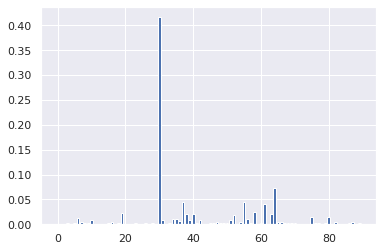

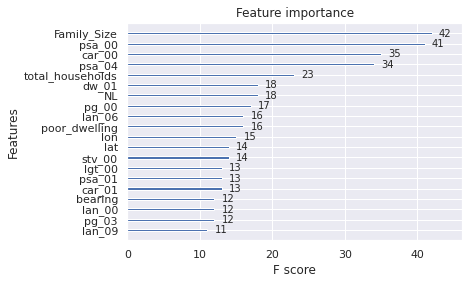

In [ ]:
#XGB

# fit model to training data
xgb_model = XGBRegressor(random_state = 0 )
xgb_model.fit(X_train, y_train)

print("Feature Importances : ", xgb_model.feature_importances_)

# plot feature importance
pyplot.bar(range(len(xgb_model.feature_importances_)), xgb_model.feature_importances_)
pyplot.savefig("XGBFeatures")
pyplot.show()
plot_importance(xgb_model,max_num_features = 20)
plt.show()

[14:09:55] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
Feature Importances :  [4.2111505e-04 9.4462914e-04 0.0000000e+00 1.9248633e-03 1.4690680e-03
 3.1286064e-03 1.2654947e-02 3.6789689e-03 2.2885285e-03 3.5740410e-03
 9.5572863e-03 1.8434600e-04 8.7749428e-04 1.1242890e-03 9.1926230e-04
 1.7715337e-03 5.4303166e-03 1.1886578e-03 2.2525524e-03 2.2634072e-02
 1.5799007e-03 9.1178843e-04 0.0000000e+00 2.8615340e-03 8.0961036e-04
 7.8975596e-04 2.6857436e-03 1.6017982e-03 2.5262774e-03 1.3605804e-03
 4.1628012e-01 9.4619803e-03 5.7517254e-04 1.7393285e-03 9.8498994e-03
 1.0109774e-02 7.6261372e-03 4.4082385e-02 2.1496313e-02 8.3575556e-03
 2.1339647e-02 2.5818208e-03 7.9465508e-03 1.2198050e-03 1.3610208e-03
 3.5084172e-03 1.8451239e-03 3.8822345e-03 3.4529103e-03 2.6867080e-03
 2.3485497e-03 8.2822489e-03 1.8262686e-02 1.1644497e-03 4.3509114e-03
 4.4582490e-02 1.1078225e-02 2.7186647e-03 2.4657371e-02 1.4319888e-0

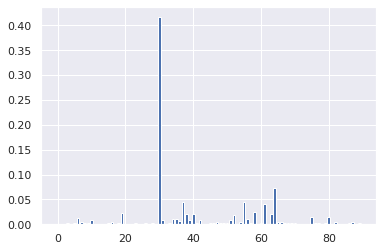

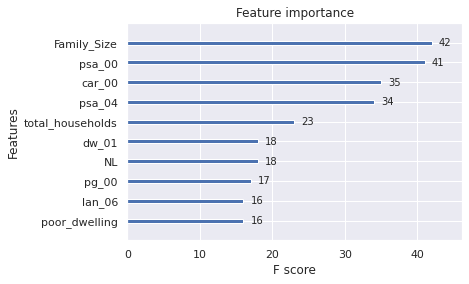

In [ ]:
from xgboost import XGBRegressor
from xgboost import plot_importance

# fit model to training data
#XGB
xgb_model = XGBRegressor(random_state = 0 )
xgb_model.fit(X_train, y_train)

print("Feature Importances : ", xgb_model.feature_importances_)

# plot feature importance
pyplot.bar(range(len(xgb_model.feature_importances_)), xgb_model.feature_importances_)
pyplot.savefig("XGBFeatures")
pyplot.show()
plot_importance(xgb_model,max_num_features = 10)
plt.savefig("XGB")
plt.show()

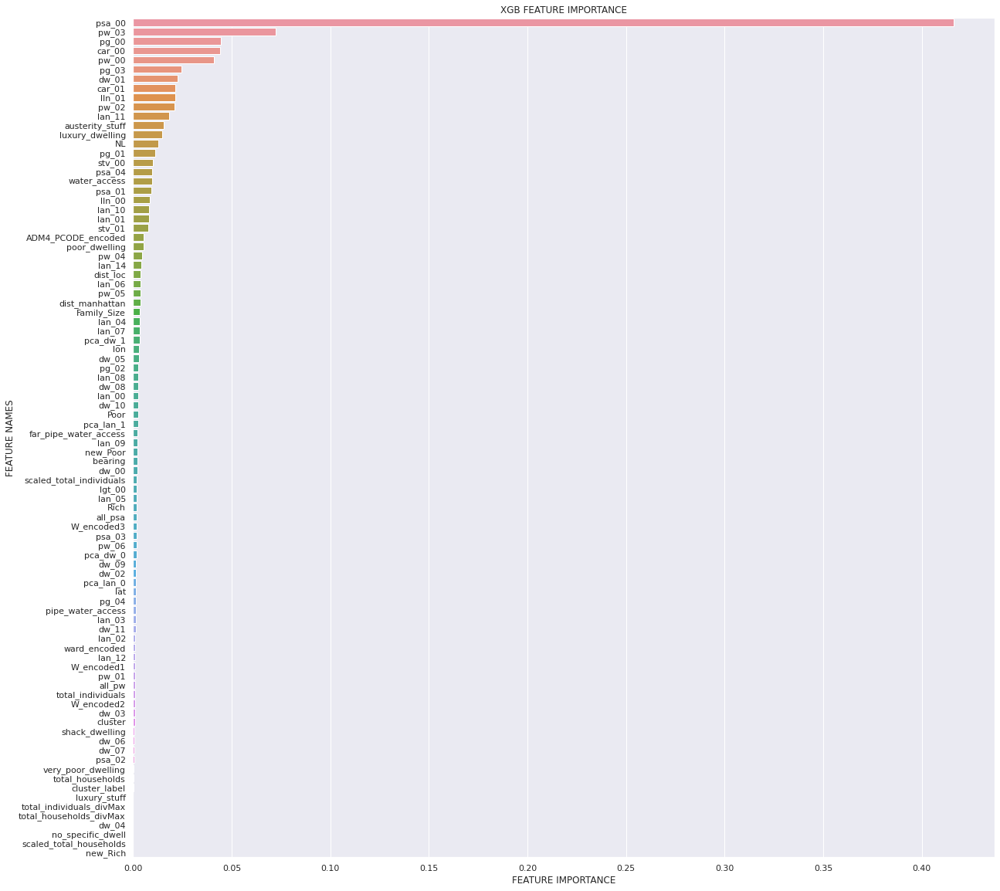

In [ ]:
plot_feature_importance(xgb_model.feature_importances_,X_train.columns,'XGB')

Best alpha using built-in LassoCV: 3.062291
Best score using built-in LassoCV: 0.430709


Text(0.5, 1.0, 'Feature importance using Lasso Model')

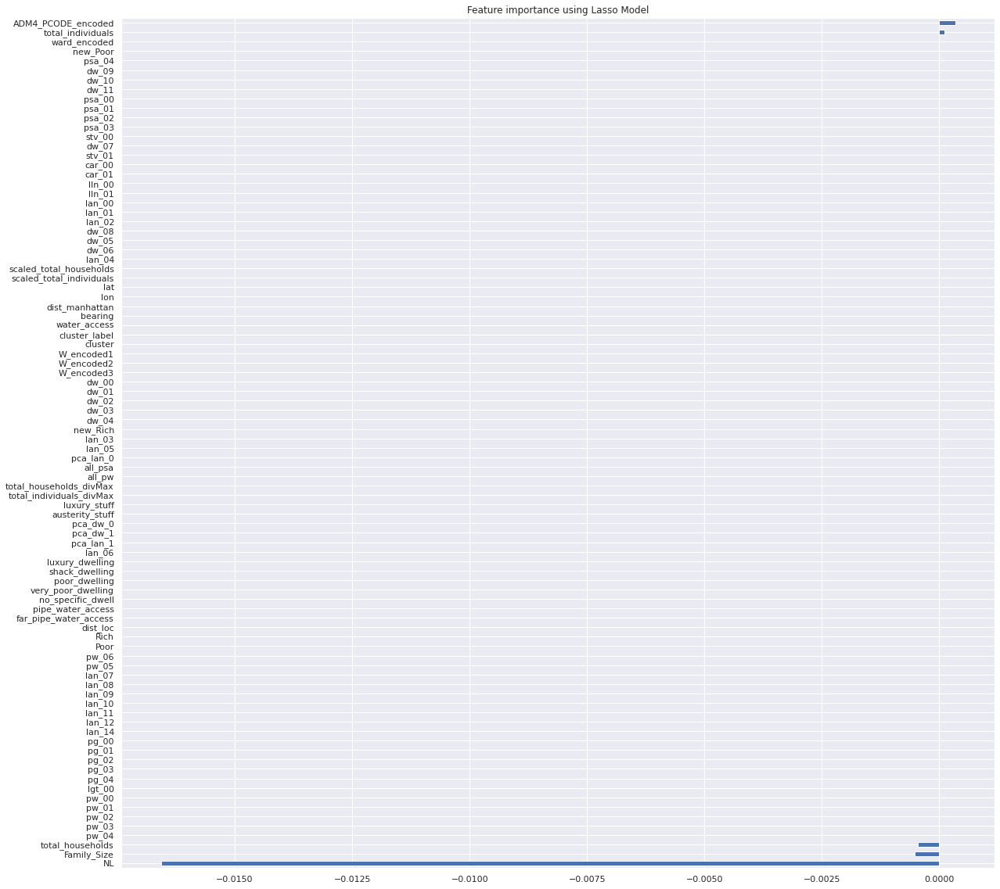

In [ ]:
#X = numericdata.drop("damage_grade",1)   #Feature Matrix
#y = numericdata["damage_grade"]          #Target Variable
import matplotlib
reg = LassoCV()
reg.fit(new_X, new_Y)
print("Best alpha using built-in LassoCV: %f" % reg.alpha_)
print("Best score using built-in LassoCV: %f" %reg.score(new_X,new_Y))
coef = pd.Series(reg.coef_, index = new_X.columns)
imp_coef = coef.sort_values()
matplotlib.rcParams['figure.figsize'] = (20, 20.0)
imp_coef.plot(kind = "barh")
plt.title("Feature importance using Lasso Model")

Best alpha using built-in LassoCV: 0.003608
Best score using built-in LassoCV: 0.863025


Text(0.5, 1.0, 'Feature importance using Lasso Model')

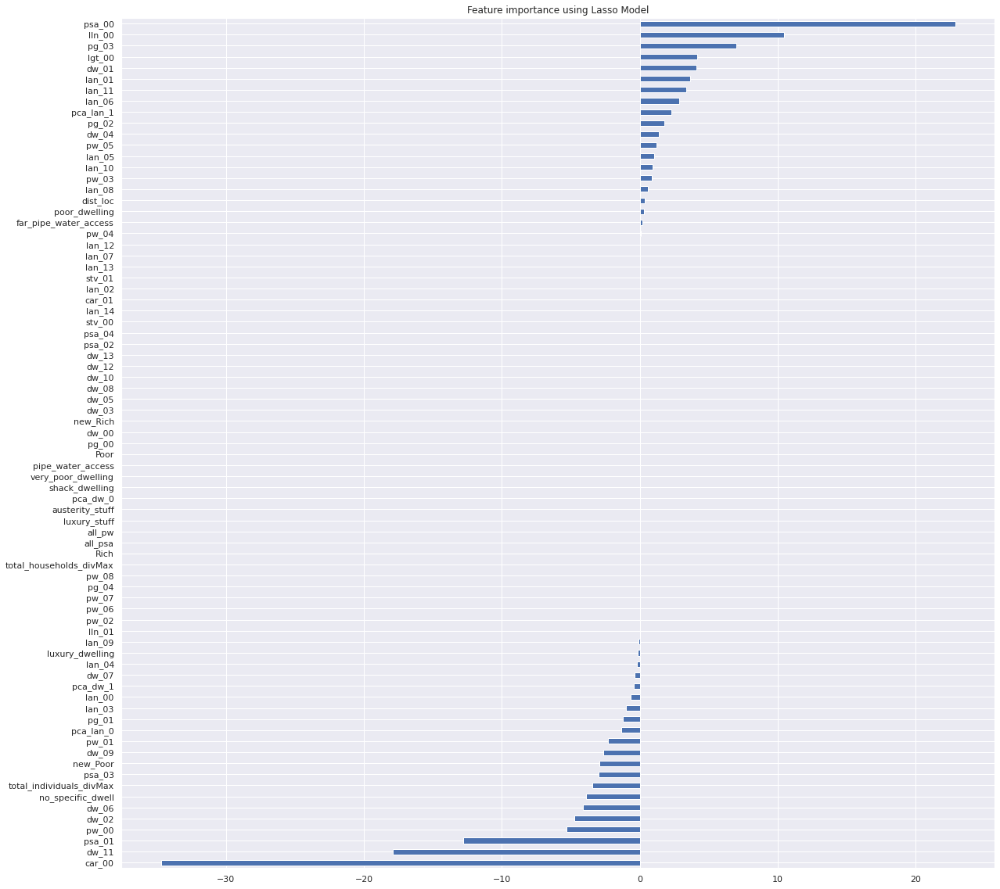

In [ ]:
import matplotlib
reg = LassoCV()
reg.fit(new_Xing, new_Ying)
print("Best alpha using built-in LassoCV: %f" % reg.alpha_)
print("Best score using built-in LassoCV: %f" %reg.score(new_Xing,new_Ying))
coef = pd.Series(reg.coef_, index = new_Xing.columns)
imp_coef = coef.sort_values()
matplotlib.rcParams['figure.figsize'] = (20, 20)
imp_coef.plot(kind = "barh")
plt.title("Feature importance using Lasso Model")

Best alpha using built-in RidgeCV: 10.000000
Best score using built-in RidgeCV: 0.913918


Text(0.5, 1.0, 'Feature importance using Ridge Model')

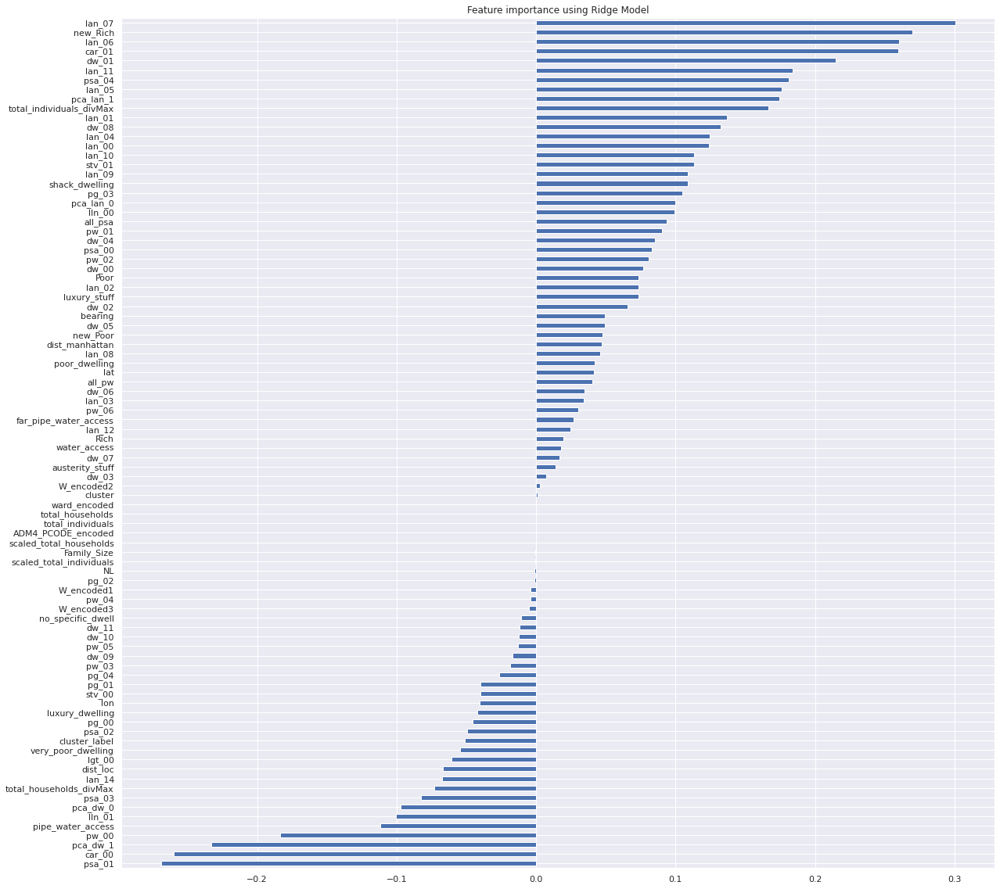

In [ ]:
reg = RidgeCV()
reg.fit(new_X, new_Y)
print("Best alpha using built-in RidgeCV: %f" % reg.alpha_)
print("Best score using built-in RidgeCV: %f" %reg.score(new_X,new_Y))
coef = pd.Series(reg.coef_, index = new_X.columns)
imp_coef = coef.sort_values()
import matplotlib
matplotlib.rcParams['figure.figsize'] = (20.0, 20.0)
imp_coef.plot(kind = "barh")
plt.title("Feature importance using Ridge Model")

Best alpha using built-in RidgeCV: 0.100000
Best score using built-in RidgeCV: 0.864585


Text(0.5, 1.0, 'Feature importance using Ridge Model')

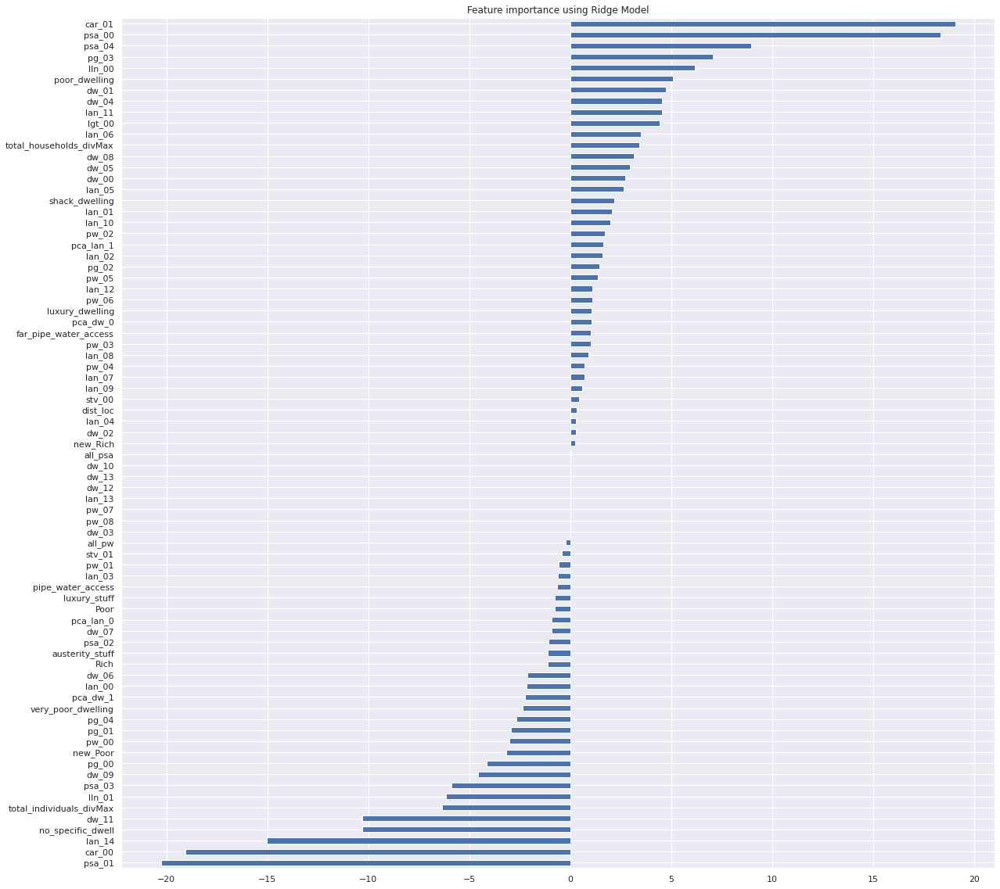

In [ ]:
reg = RidgeCV()
reg.fit(new_Xing, new_Ying)
print("Best alpha using built-in RidgeCV: %f" % reg.alpha_)
print("Best score using built-in RidgeCV: %f" %reg.score(new_Xing,new_Ying))
coef = pd.Series(reg.coef_, index = new_Xing.columns)
imp_coef = coef.sort_values()
import matplotlib
matplotlib.rcParams['figure.figsize'] = (20.0, 20.0)
imp_coef.plot(kind = "barh")
plt.title("Feature importance using Ridge Model")

Text(0.5, 1.0, 'Feature importance using Ridge Model')

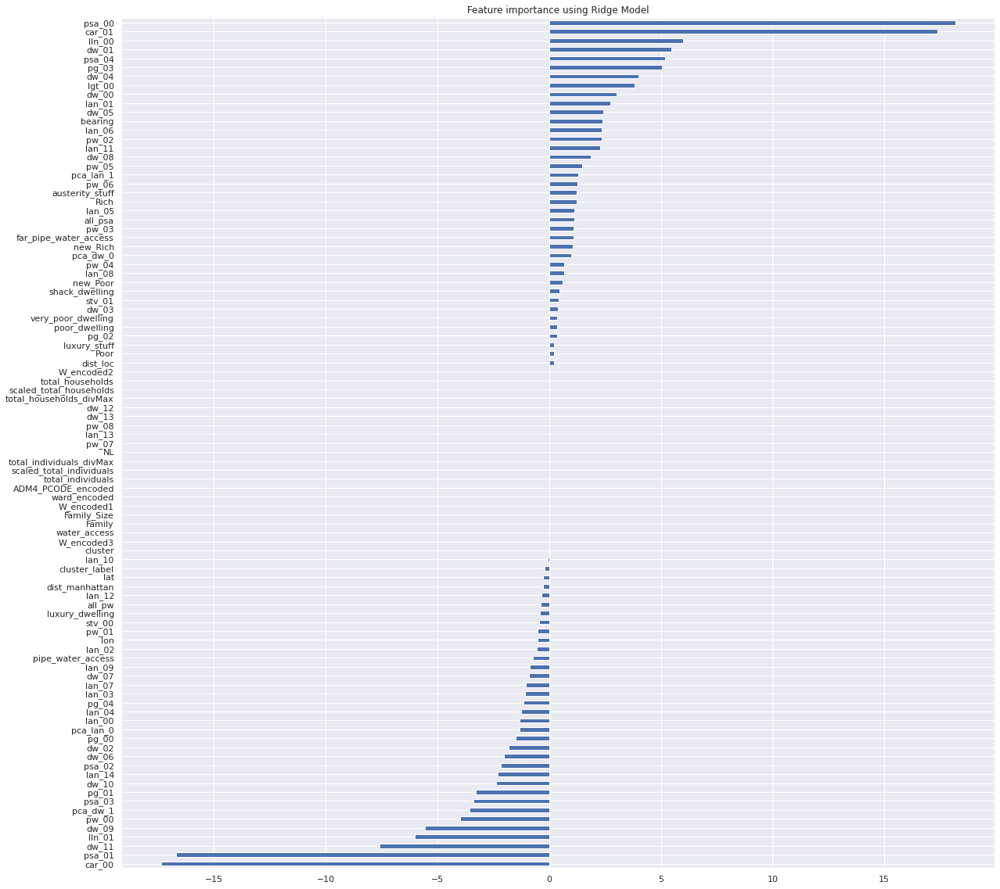

In [ ]:
reg = Ridge()
reg.fit(new_X, new_Y)
#print("Best alpha using built-in RidgeCV: %f" % reg.alpha_)
#print("Best score using built-in RidgeCV: %f" %reg.score(new_X,new_Y))
coef = pd.Series(reg.coef_, index = new_X.columns)
imp_coef = coef.sort_values()
import matplotlib
matplotlib.rcParams['figure.figsize'] = (20, 20.0)
imp_coef.plot(kind = "barh")
plt.title("Feature importance using Ridge Model")

Feature: 0, Score: -100994688264079.12500
Feature: 1, Score: -17792897208628.00000
Feature: 2, Score: 2422334647743.85938
Feature: 3, Score: -789174395342.98047
Feature: 4, Score: -1357791385577.49609
Feature: 5, Score: -2065226081435.31836
Feature: 6, Score: -1888332521525.94336
Feature: 7, Score: 49053106975.49219
Feature: 8, Score: 1410098078941.33789
Feature: 9, Score: 11164429936654.81250
Feature: 10, Score: 13271534757145.52734
Feature: 11, Score: -1140818723164.16406
Feature: 12, Score: 1257079962588.63477
Feature: 13, Score: -444835228257.91309
Feature: 14, Score: 8498936617615.49316
Feature: 15, Score: -41538465516350.32031
Feature: 16, Score: -13818335839141.21289
Feature: 17, Score: -13818340890923.55469
Feature: 18, Score: -13818354920206.28516
Feature: 19, Score: -83719133618.13232
Feature: 20, Score: 49953677099524.54688
Feature: 21, Score: 22288210664555.11719
Feature: 22, Score: -27749185568549.87109
Feature: 23, Score: -10234063065208.02734
Feature: 24, Score: -1023406

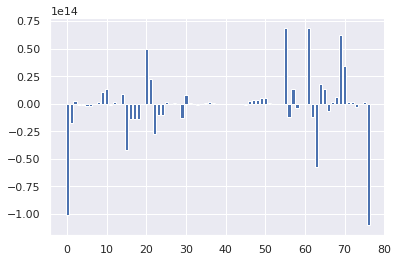

In [ ]:
from sklearn.datasets import make_regression
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor

from matplotlib import pyplot
# define dataset
#X, y = make_regression(n_samples=1000, n_features=10, n_informative=5, random_state=1)


lrmodel = LinearRegression()
# define the model
#model = LinearRegression()
# fit the model
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
n_scores = cross_val_score(lrmodel, new_X, new_Y, scoring='r2', cv=cv, n_jobs=-1, error_score='raise')
lrmodel.fit(Xing_train, ying_train)
# get importance
importance = lrmodel.coef_
# summarize feature importance
for i,v in enumerate(importance):
	print('Feature: %0d, Score: %.5f' % (i,v))
# plot feature importance
pyplot.bar([x for x in range(len(importance))], importance)
pyplot.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier as RClf
from sklearn.preprocessing import LabelEncoder

lab_enc = LabelEncoder()
training_scores_encoded = lab_enc.fit_transform(y_train)
#training_scores_encod = lab_enc.fit_transform(X_train)
#X_train = np.argmax(X_train, axis=1)
rfmodel = RClf(n_estimators = 30)
rfmodel.fit(X_train, training_scores_encoded)
importances = rfmodel.feature_importances_
std = np.std([tree.feature_importances_ for tree in rfmodel.estimators_], axis = 0)

indices = np.argsort(importances)[::-1]

print('Feature Ranking:')
print(X_train.columns[1])
for f in range(new_X.shape[1]):
	print((f+1, new_X.columns[indices[f]],importances[indices[f]]))

Feature Ranking:
total_individuals
(1, 'lan_06', 0.014249933556222016)
(2, 'lan_02', 0.014156350346466954)
(3, 'psa_03', 0.01386416804144221)
(4, 'dw_11', 0.0137934199012624)
(5, 'dist_manhattan', 0.013533044463504902)
(6, 'lan_07', 0.013496855930828954)
(7, 'lan_08', 0.013329488206359959)
(8, 'dw_02', 0.013323017495486313)
(9, 'pca_lan_1', 0.013253748336130713)
(10, 'lan_00', 0.013026002204310187)
(11, 'ward_encoded', 0.013009661183473662)
(12, 'lan_03', 0.01279449253167077)
(13, 'dw_06', 0.012681243259680024)
(14, 'pca_lan_0', 0.012615533285646362)
(15, 'dist_loc', 0.012589765362759995)
(16, 'psa_04', 0.012544040201904413)
(17, 'all_psa', 0.012434469341894171)
(18, 'all_pw', 0.012409208946623607)
(19, 'pg_00', 0.012213588787218871)
(20, 'Family_Size', 0.012171604350115045)
(21, 'pw_06', 0.012168165671970764)
(22, 'pw_00', 0.012168008891362842)
(23, 'pg_03', 0.012155289402587411)
(24, 'pw_01', 0.012118814333703385)
(25, 'pw_02', 0.01199600090069094)
(26, 'ADM4_PCODE_encoded', 0.011984

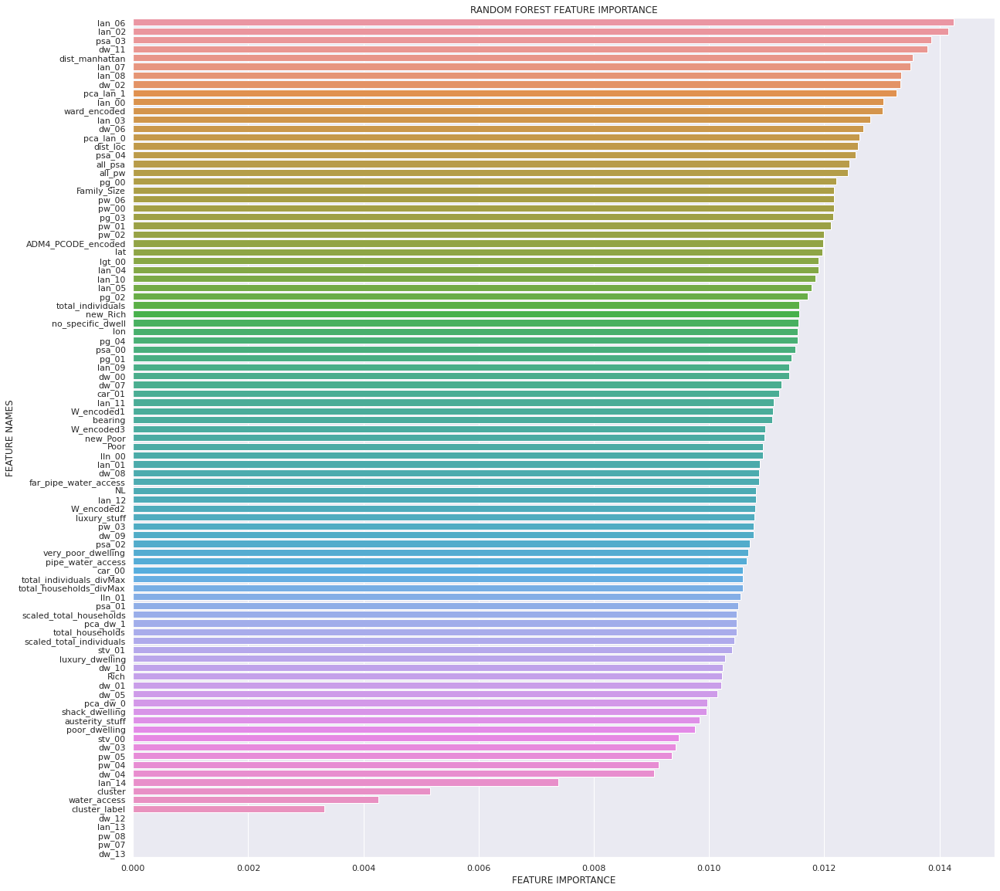

In [ ]:
plot_feature_importance(rfmodel.feature_importances_,X_train.columns,'RANDOM FOREST')

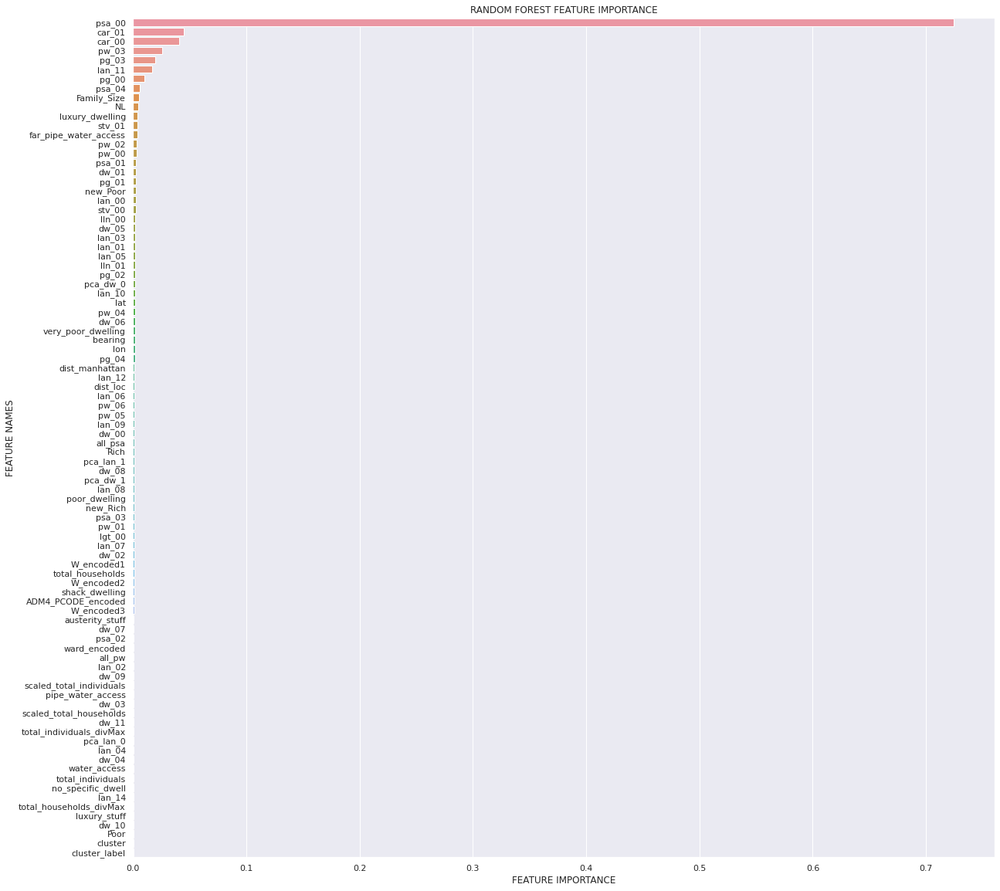

In [ ]:
from sklearn.ensemble import RandomForestRegressor as RClf
from sklearn.preprocessing import LabelEncoder

#lab_enc = LabelEncoder()
#training_scores_encoded = lab_enc.fit_transform(y_train)
#training_scores_encod = lab_enc.fit_transform(X_train)
#X_train = np.argmax(X_train, axis=1)
rfmodel = RClf(n_estimators = 100)
rfmodel.fit(X_train, y_train)
importances = rfmodel.feature_importances_
std = np.std([tree.feature_importances_ for tree in rfmodel.estimators_], axis = 0)

indices = np.argsort(importances)[::-1]

#print('Feature Ranking:')
#print(X_train.columns[1])
#for f in range(new_X.shape[1]):
#	print((f+1, new_X.columns[indices[f]],importances[indices[f]]))
plot_feature_importance(rfmodel.feature_importances_,X_train.columns,'RANDOM FOREST')

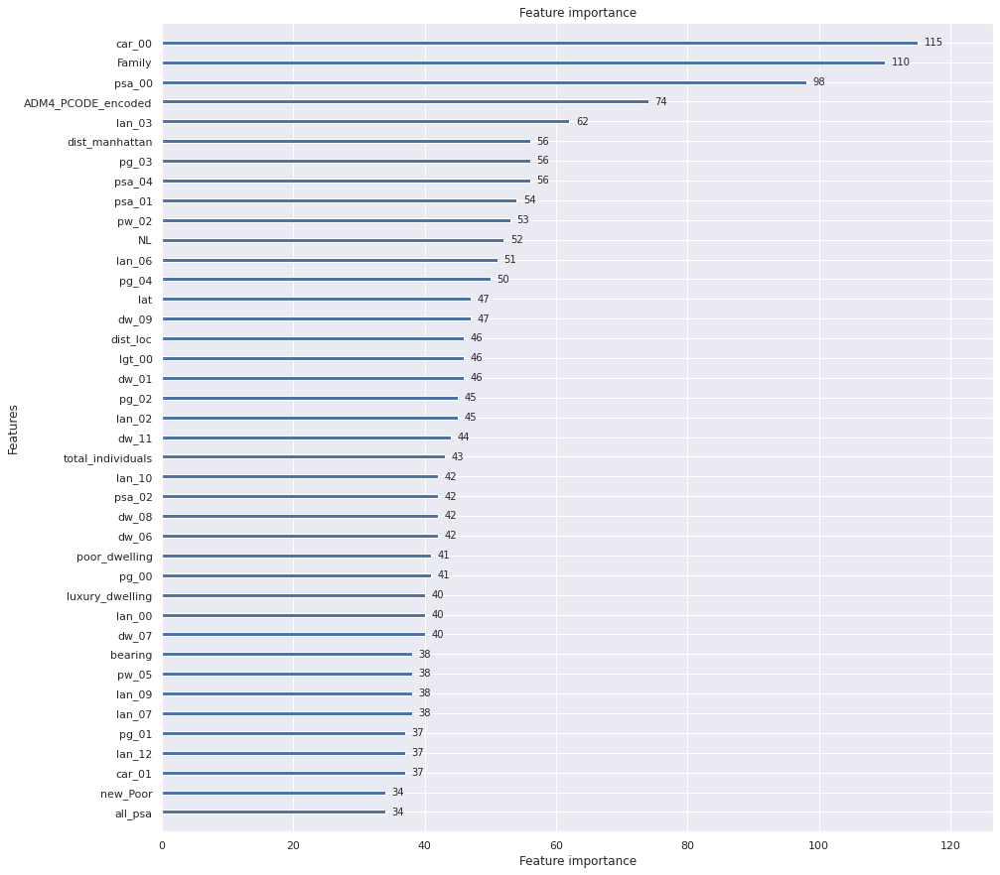

In [ ]:
#LightGBM


#lgb.plot_importance(model)
lgbmodel = LGBMRegressor()
lgbmodel.fit(X_train, y_train)

ax = lgb.plot_importance(lgbmodel, max_num_features=40, figsize=(15,15))
plt.show()

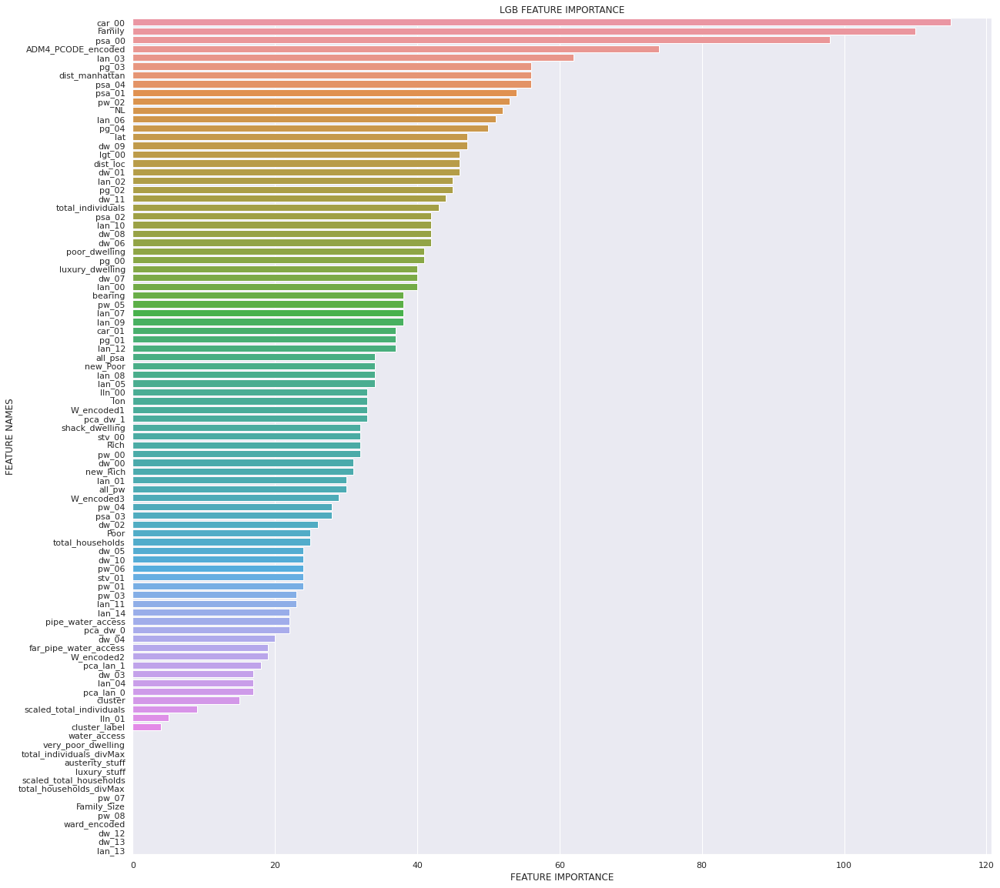

In [ ]:
plot_feature_importance(lgbmodel.feature_importances_,X_train.columns,'LGB')

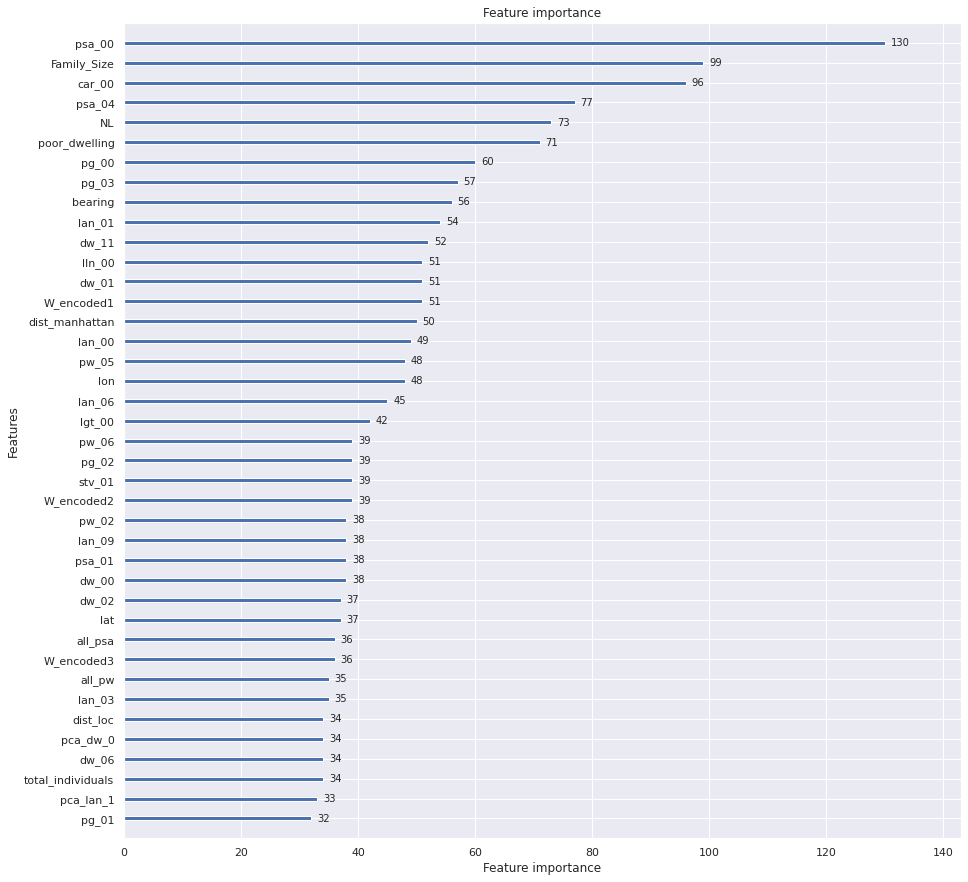

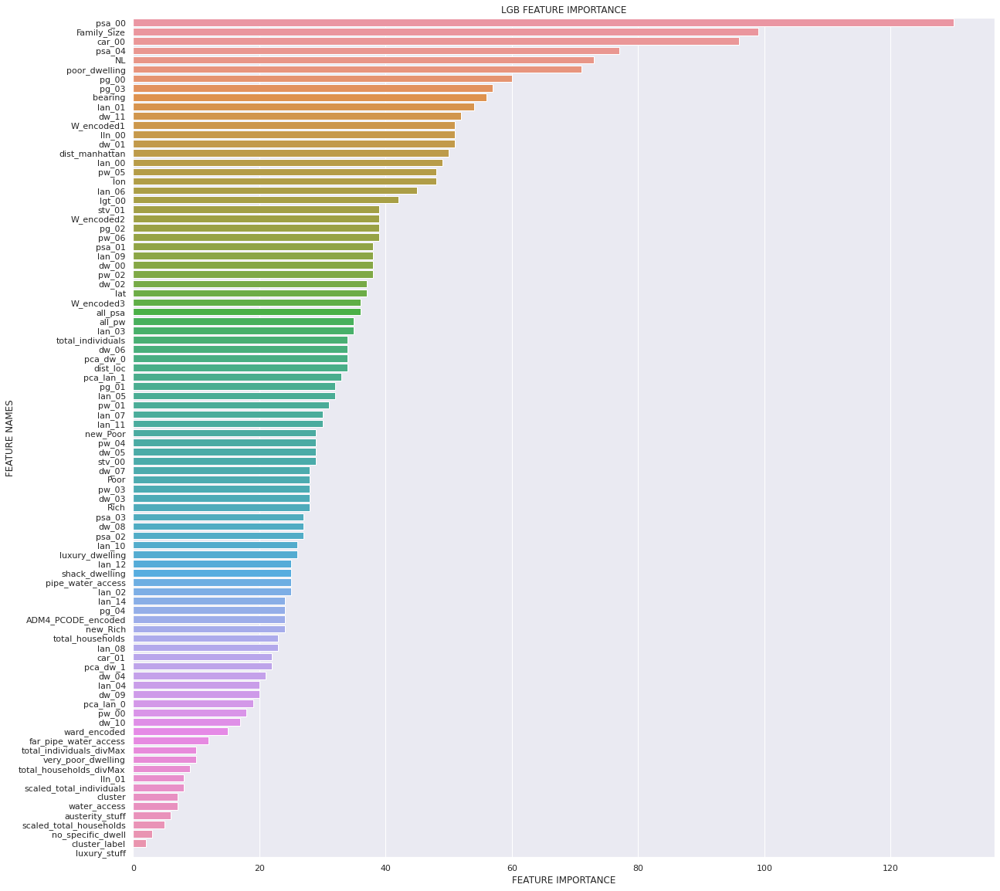

In [ ]:
#LightGBM

#lgb.plot_importance(model)
lgbmodel = LGBMRegressor()
lgbmodel.fit(X_train, y_train)

ax = lgb.plot_importance(lgbmodel, max_num_features=40, figsize=(15,15))
plt.show()
plot_feature_importance(lgbmodel.feature_importances_,X_train.columns,'LGB')

In [ ]:
print(f"MEAN: {mean(n_scores)*100}, STD:{stdev(n_scores)}")
print(f"MEAN: {mean(n_predict_scores)}, STD:{stdev(n_predict_scores)}")

MEAN: 90.25094514514153, STD:0.010715158028282702
MEAN: 24.153280403597073, STD:9.225895908135834


In [ ]:
import sklearn
sorted(sklearn.metrics.SCORERS.keys())
https://www.kaggle.com/questions-and-answers/92771
https://scikit-learn.org/stable/modules/model_evaluation.html

['accuracy',
 'adjusted_mutual_info_score',
 'adjusted_rand_score',
 'average_precision',
 'balanced_accuracy',
 'completeness_score',
 'explained_variance',
 'f1',
 'f1_macro',
 'f1_micro',
 'f1_samples',
 'f1_weighted',
 'fowlkes_mallows_score',
 'homogeneity_score',
 'jaccard',
 'jaccard_macro',
 'jaccard_micro',
 'jaccard_samples',
 'jaccard_weighted',
 'max_error',
 'mutual_info_score',
 'neg_brier_score',
 'neg_log_loss',
 'neg_mean_absolute_error',
 'neg_mean_gamma_deviance',
 'neg_mean_poisson_deviance',
 'neg_mean_squared_error',
 'neg_mean_squared_log_error',
 'neg_median_absolute_error',
 'neg_root_mean_squared_error',
 'normalized_mutual_info_score',
 'precision',
 'precision_macro',
 'precision_micro',
 'precision_samples',
 'precision_weighted',
 'r2',
 'recall',
 'recall_macro',
 'recall_micro',
 'recall_samples',
 'recall_weighted',
 'roc_auc',
 'roc_auc_ovo',
 'roc_auc_ovo_weighted',
 'roc_auc_ovr',
 'roc_auc_ovr_weighted',
 'v_measure_score']

In [ ]:
print(n_scores)

[-2.48749796 -2.56810251 -2.58160239 -2.4950167  -2.59994914 -2.48659772]


In [ ]:
from sklearn.model_selection import train_test_split, KFold

In [ ]:
model=CatBoostRegressor(iterations=800, #leaf_estimation_iterations=10,#800
                              learning_rate=0.1,
                              depth=4,#loss_function='MultiClass',#,scale_pos_weight=200,
                             #l2_leaf_reg=5,
                             bootstrap_type='Bernoulli',
                              subsample=0.9,
                              eval_metric='RMSE',
                                random_seed=4,
                              metric_period=20,
                                   #class_weight s=0,
                              #od_type='Iter',
                              #od_wait=45,
                              
                              allow_writing_files=False)


m=model.fit(X_train, y_train)#, cat_features=categorical_features_indices)

from catboost import Pool
feature_score = pd.DataFrame(list(zip(new_X.dtypes.index, model.get_feature_importance(Pool(new_X, label=new_Y,)))),columns=['Feature','Score']) #cat_features=categorical_features_indices)))),
                #columns=['Feature','Score'])

feature_score.sort_values(by="Score", ascending =False)

0:	learn: 9.6042276	total: 72.1ms	remaining: 57.6s
20:	learn: 4.2930928	total: 271ms	remaining: 10.1s
40:	learn: 3.5635612	total: 471ms	remaining: 8.72s
60:	learn: 3.2832167	total: 676ms	remaining: 8.19s
80:	learn: 3.0987241	total: 871ms	remaining: 7.73s
100:	learn: 2.9288008	total: 1.07s	remaining: 7.38s
120:	learn: 2.7701814	total: 1.26s	remaining: 7.07s
140:	learn: 2.6389541	total: 1.46s	remaining: 6.82s
160:	learn: 2.5241004	total: 1.67s	remaining: 6.64s
180:	learn: 2.4209421	total: 1.87s	remaining: 6.39s
200:	learn: 2.3224264	total: 2.06s	remaining: 6.16s
220:	learn: 2.2301111	total: 2.26s	remaining: 5.92s
240:	learn: 2.1398308	total: 2.46s	remaining: 5.7s
260:	learn: 2.0582666	total: 2.66s	remaining: 5.5s
280:	learn: 1.9800580	total: 2.85s	remaining: 5.27s
300:	learn: 1.9101570	total: 3.05s	remaining: 5.06s
320:	learn: 1.8455289	total: 3.25s	remaining: 4.84s
340:	learn: 1.7814656	total: 3.44s	remaining: 4.63s
360:	learn: 1.7204005	total: 3.64s	remaining: 4.42s
380:	learn: 1.66494

,Feature,Score
16,psa_00,25.098661
24,car_01,10.868379
23,car_00,5.055807
21,stv_00,4.367567
48,pw_00,4.363703
42,pg_00,3.365330
27,lan_00,2.870231
60,Family_Size,2.609900
17,psa_01,2.205835
30,lan_03,2.174837


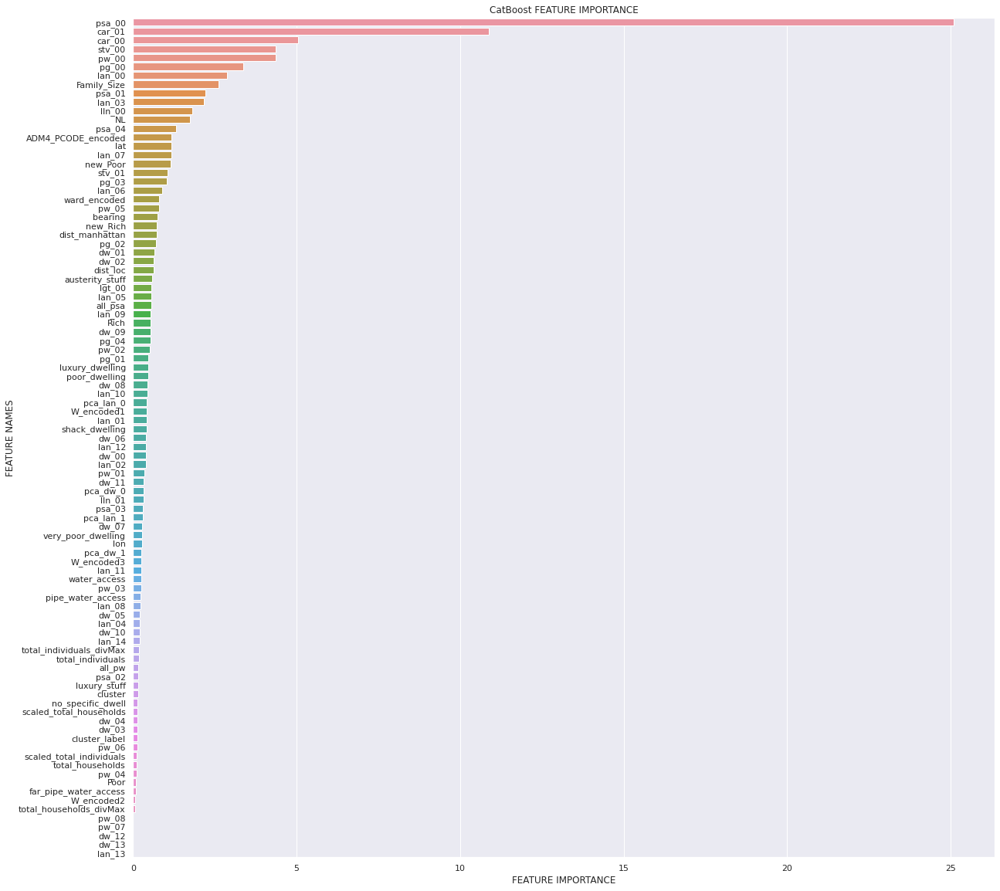

In [ ]:
plot_feature_importance(m.feature_importances_,X_train.columns,'CatBoost')

0:	learn: 1.0617406	total: 9.6ms	remaining: 14.4s
20:	learn: 0.4050828	total: 187ms	remaining: 13.2s
40:	learn: 0.3299490	total: 375ms	remaining: 13.3s
60:	learn: 0.3017341	total: 555ms	remaining: 13.1s
80:	learn: 0.2813345	total: 745ms	remaining: 13s
100:	learn: 0.2633422	total: 916ms	remaining: 12.7s
120:	learn: 0.2460835	total: 1.09s	remaining: 12.5s
140:	learn: 0.2302980	total: 1.27s	remaining: 12.3s
160:	learn: 0.2181547	total: 1.46s	remaining: 12.1s
180:	learn: 0.2058784	total: 1.63s	remaining: 11.9s
200:	learn: 0.1957842	total: 1.82s	remaining: 11.8s
220:	learn: 0.1874525	total: 2s	remaining: 11.6s
240:	learn: 0.1791932	total: 2.18s	remaining: 11.4s
260:	learn: 0.1709094	total: 2.35s	remaining: 11.2s
280:	learn: 0.1623086	total: 2.54s	remaining: 11s
300:	learn: 0.1558598	total: 2.72s	remaining: 10.8s
320:	learn: 0.1499444	total: 2.9s	remaining: 10.6s
340:	learn: 0.1445789	total: 3.07s	remaining: 10.4s
360:	learn: 0.1383800	total: 3.25s	remaining: 10.3s
380:	learn: 0.1327369	tota

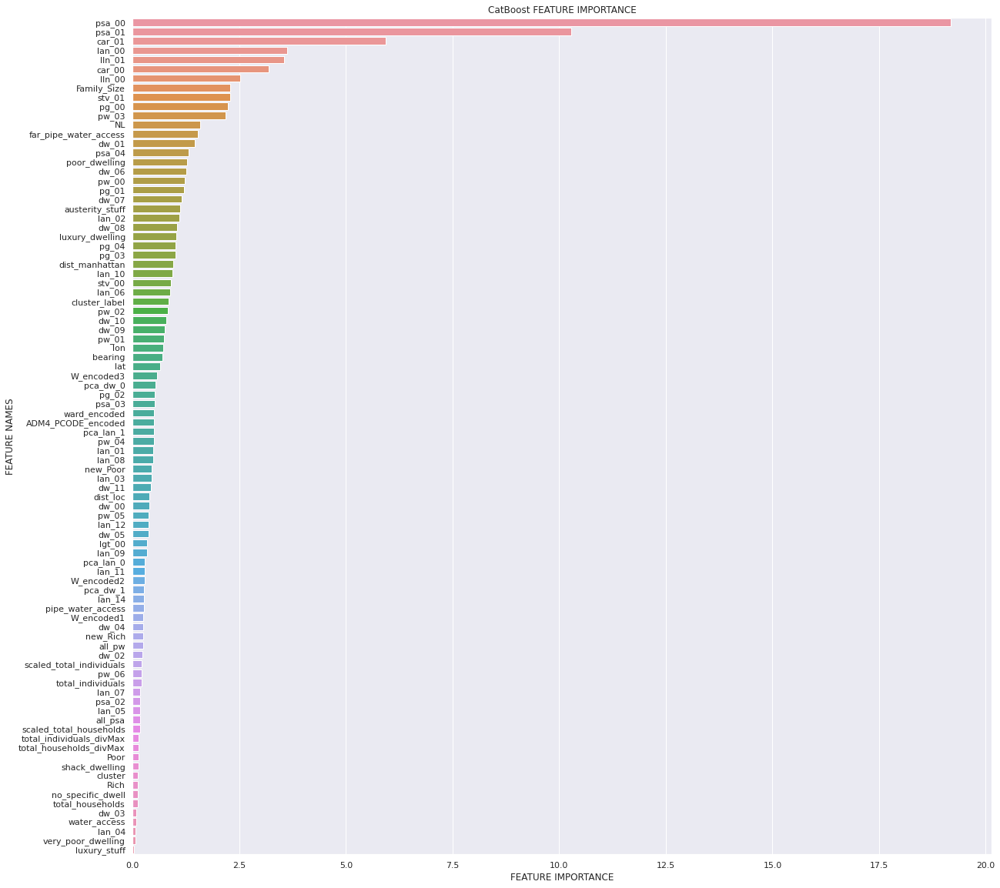

In [ ]:
model=CatBoostRegressor(iterations=1500, #leaf_estimation_iterations=10,#800
                              learning_rate=0.1,
                              depth=4,#loss_function='MultiClass',#,scale_pos_weight=200,
                             #l2_leaf_reg=5,
                             bootstrap_type='Bernoulli',
                              subsample=0.9,
                              eval_metric='RMSE',
                                random_seed=4,
                              metric_period=20,
                                   #class_weight s=0,
                              #od_type='Iter',
                              #od_wait=45,
                              
                              allow_writing_files=False)


m=model.fit(X_train, y_train)#, cat_features=categorical_features_indices)

from catboost import Pool
feature_score = pd.DataFrame(list(zip(new_X.dtypes.index, model.get_feature_importance(Pool(new_X, label=new_Y,)))),columns=['Feature','Score']) #cat_features=categorical_features_indices)))),
                #columns=['Feature','Score'])

print(feature_score.sort_values(by="Score", ascending =False))
plot_feature_importance(m.feature_importances_,X_train.columns,'CatBoost')

In [ ]:
#AdaBoost Regressor
Adamodel = AdaBoostRegressor()
# fit the model on the whole dataset
Adamodel.fit(X_train, y_train)
# make a single 

AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=50, random_state=None)

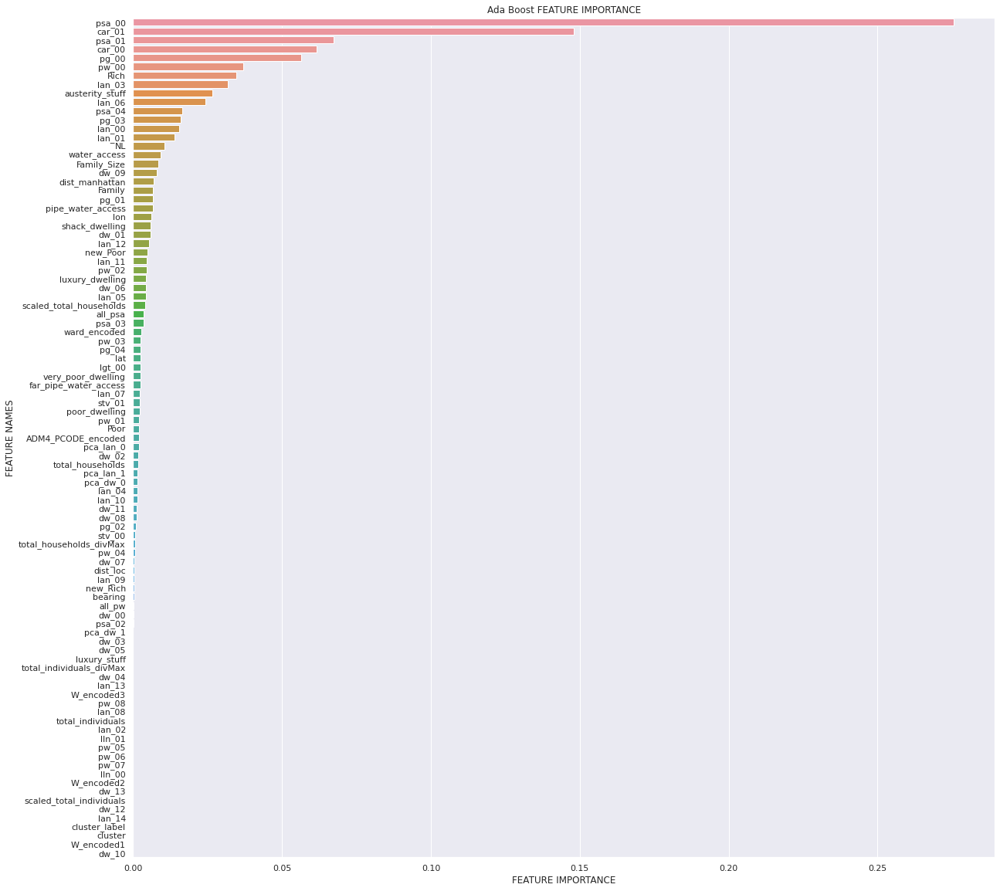

In [ ]:
plot_feature_importance(Adamodel.feature_importances_,X_train.columns,'Ada Boost')

In [ ]:
#Gradient Boosting Regressor
GBRmodel = GradientBoostingRegressor()
GBRmodel.fit(X_train, y_train)

GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                          init=None, learning_rate=0.1, loss='ls', max_depth=3,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=100,
                          n_iter_no_change=None, presort='deprecated',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False)

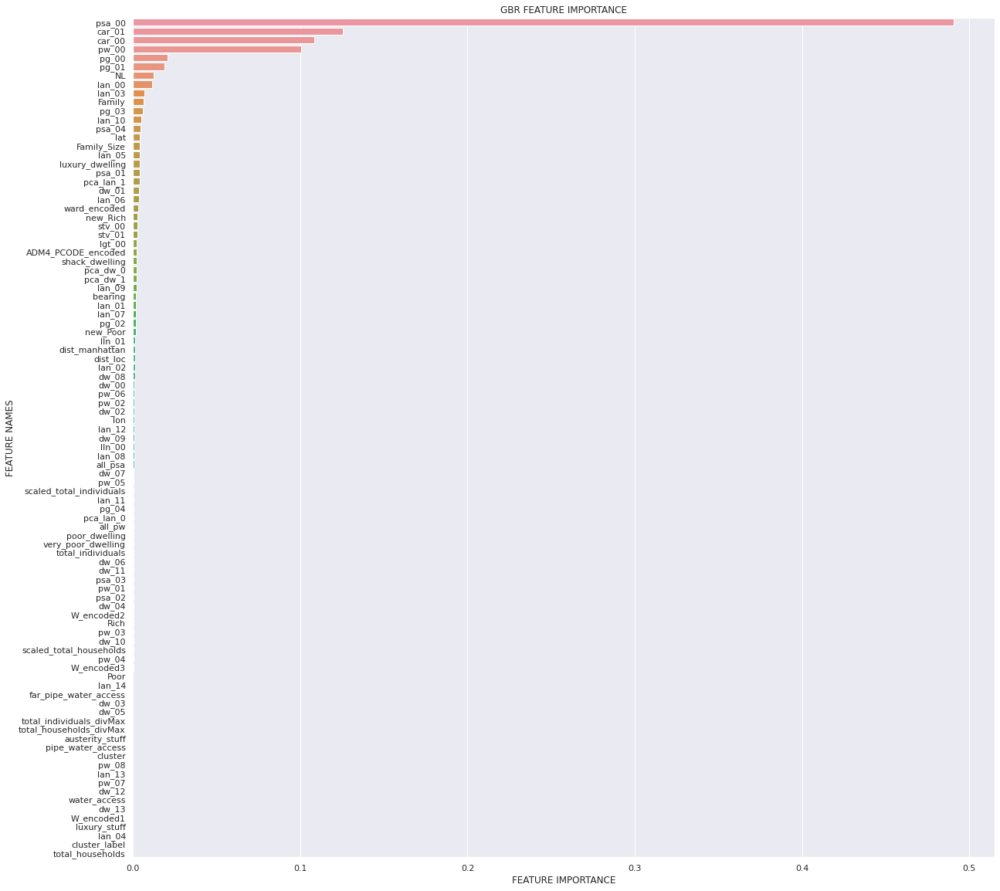

In [ ]:
plot_feature_importance(GBRmodel.feature_importances_,X_train.columns,'GBR')

In [ ]:
#Extra Trees Model
etrmodel = ExtraTreesRegressor()
etrmodel.fit(X_train,y_train)

ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=100, n_jobs=None, oob_score=False,
                    random_state=None, verbose=0, warm_start=False)

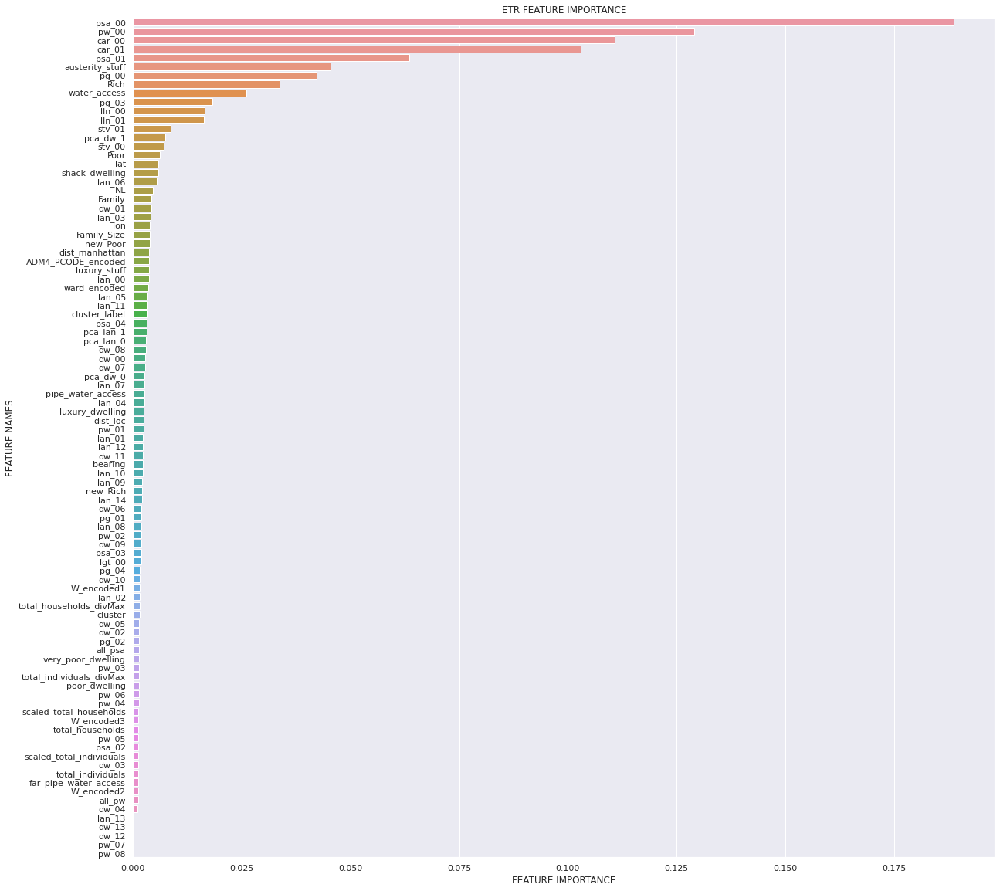

In [ ]:
plot_feature_importance(etrmodel.feature_importances_,X_train.columns,'ETR')

In [ ]:
decmodel = DecisionTreeRegressor()
decmodel.fit(X_train,y_train)

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

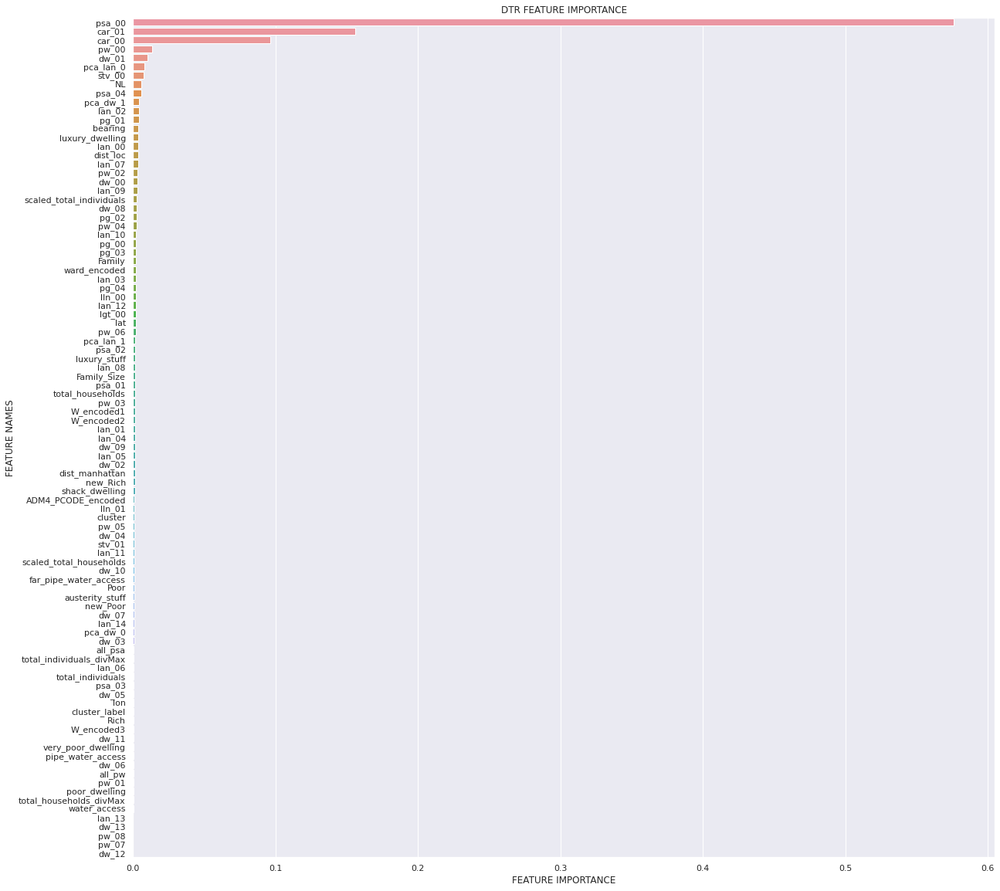

In [ ]:
plot_feature_importance(decmodel.feature_importances_,X_train.columns,'DTR')

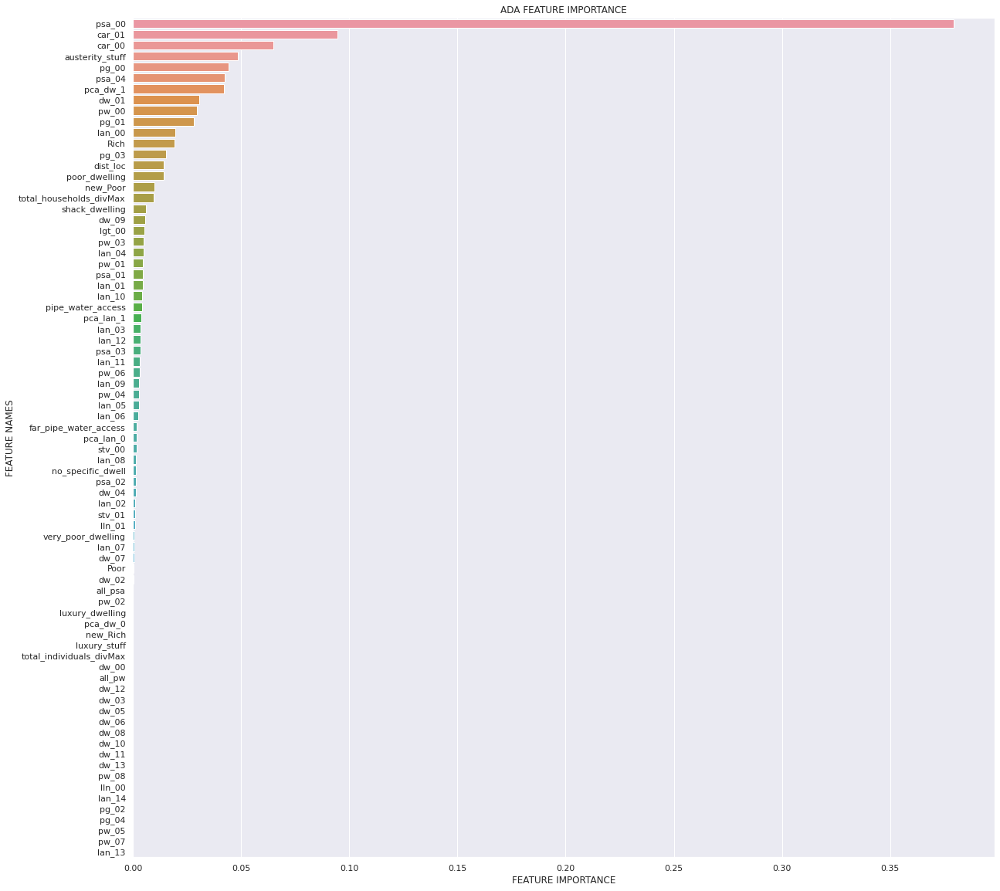

In [ ]:
adamodel = AdaBoostRegressor()
adamodel.fit(new_Xing,new_Ying)
plot_feature_importance(adamodel.feature_importances_,Xing_train.columns,'ADA')

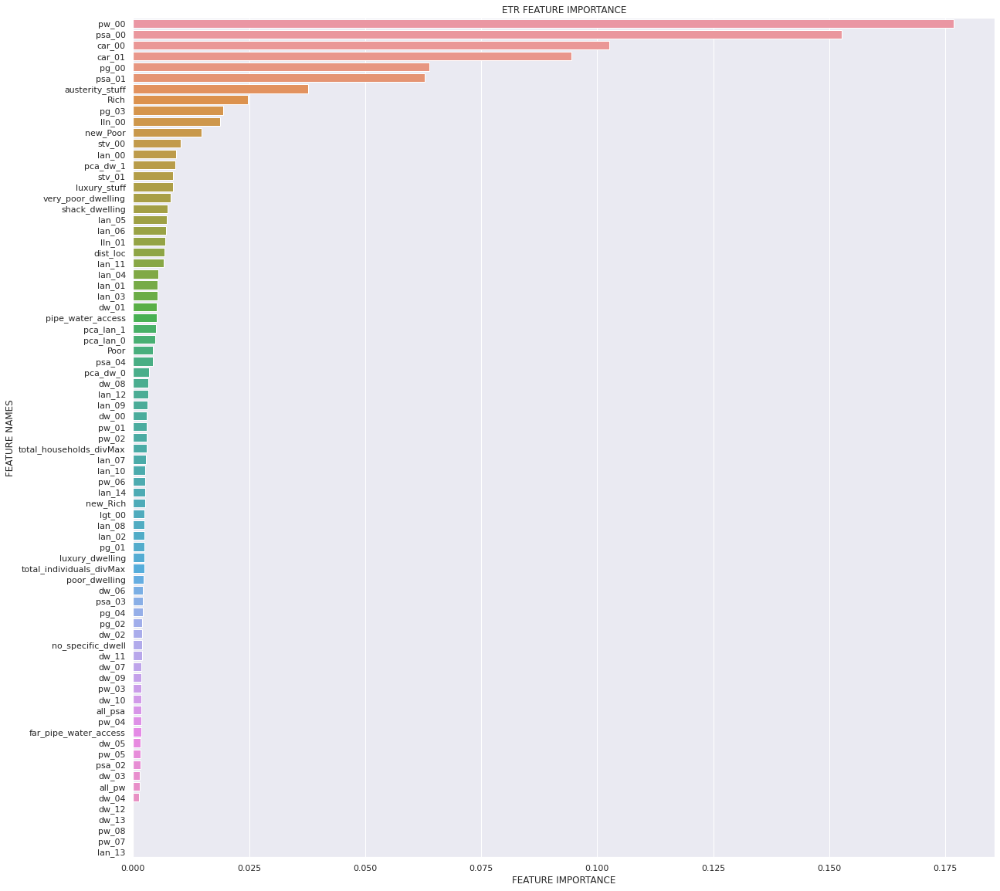

In [ ]:
etrmodel = ExtraTreesRegressor()
etrmodel.fit(new_Xing,new_Ying)
plot_feature_importance(etrmodel.feature_importances_,Xing_train.columns,'ETR')

#MODEL TESTING

In [ ]:
new_Y = pd.DataFrame(train)["target"]
new_X = newData.drop(['ward', 'ADM4_PCODE', 'target'],1)
X_train, X_test, y_train, y_test = train_test_split(new_X, new_Y, test_size = 0.3, random_state = 29)
categorical_features_indices = np.where(X_train.dtypes == np.object)[0]

In [ ]:
mlpmodel = MLPRegressor(random_state=1, max_iter=500)
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
n_scores = cross_val_score(mlpmodel, new_X, new_Y, scoring='r2', cv=cv, n_jobs=-1, error_score='raise')

In [ ]:
print(f"MEAN: {mean(n_scores)*100}, STD:{stdev(n_scores)}")

MEAN: -795616892.971139, STD:20109900.022357017


In [ ]:
sgdmodel = SGDRegressor()
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
n_scores = cross_val_score(sgdmodel, new_X, new_Y, scoring='r2', cv=cv, n_jobs=-1, error_score='raise')

In [ ]:
print(f"MEAN: {mean(n_scores)*100}, STD:{stdev(n_scores)}")

MEAN: -1.209130299401539e+59, STD:1.7622519516485347e+57


In [ ]:
new_Y = pd.DataFrame(train)["target"]
new_specX = newData.drop(['target'],1)
categorical_features_indices = np.where(new_specX.dtypes == np.object)[0]

In [ ]:
catmodel = CatBoostRegressor(iterations=800, #leaf_estimation_iterations=10,#800
                              learning_rate=0.1,
                              depth=4,#loss_function='MultiClass',#,scale_pos_weight=200,
                             #l2_leaf_reg=5,
                             bootstrap_type='Bernoulli',
                              subsample=0.9,
                              eval_metric="R2",#'RMSE'
                                random_seed=4,
                              metric_period=20,
                                   #class_weight s=0,
                              #od_type='Iter',
                              #od_wait=45,
                              
                              allow_writing_files=False)#,cat_features=categorical_features_indices,verbose=True)

cv = RepeatedKFold(n_splits=2, n_repeats=3, random_state=1)
n_scores = cross_validate(catmodel, new_X, new_Y, scoring='RMSE', cv=cv, n_jobs=-1, error_score='raise',verbose=1,return_estimator=False)
#feature_score = pd.DataFrame(list(zip(new_specX.dtypes.index, catmodel.get_feature_importance(Pool(new_specX, label=new_Y, cat_features=categorical_features_indices)))),columns=['Feature','Score'])

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of   6 | elapsed:   47.4s finished


In [ ]:
print(n_scores)

{'fit_time': array([15.10107374, 15.04490328, 15.15190864, 15.12604451, 14.974509  ,
       15.02100849]), 'score_time': array([0.01796055, 0.01423955, 0.02612591, 0.02511477, 0.01249599,
       0.00813651]), 'test_score': array([0.90285714, 0.89737652, 0.89376611, 0.90308753, 0.89802805,
       0.89876634])}


In [ ]:
# Set up folds
K = 5
kf = KFold(n_splits = K, random_state = 1, shuffle = True)
OPTIMIZE_ROUNDS = False
def eval_gini(y_true, y_prob):
    y_true = np.asarray(y_true)
    y_true = y_true[np.argsort(y_prob)]
    ntrue = 0
    gini = 0
    delta = 0
    n = len(y_true)
    for i in range(n-1, -1, -1):
        y_i = y_true[i]
        ntrue += y_i
        gini += y_i * delta
        delta += 1 - y_i
    gini = 1 - 2 * gini / (ntrue * (n - ntrue))
    return gini
y_valid_pred = 0*new_Y
y_test_pred=0
catmodel = CatBoostRegressor(iterations=800, #leaf_estimation_iterations=10,#800
                              learning_rate=0.1,
                              depth=4,#loss_function='MultiClass',#,scale_pos_weight=200,
                             #l2_leaf_reg=5,
                             bootstrap_type='Bernoulli',
                              subsample=0.9,
                              eval_metric='RMSE',
                                random_seed=4,
                              metric_period=20,
                                   #class_weight s=0,
                              #od_type='Iter',
                              #od_wait=45,
                              
                              allow_writing_files=False)#,cat_features=categorical_features_indices,verbose=True)
# Run CV

for i, (train_index, test_index) in enumerate(kf.split(new_X)):
    
    # Create data for this fold
    y_train, y_valid = new_Y.iloc[train_index], new_Y.iloc[test_index]
    X_train, X_valid = new_X.iloc[train_index,:], new_X.iloc[test_index,:]
    print( "\nFold ", i)
    
    # Run model for this fold
    if OPTIMIZE_ROUNDS:
        fit_model = catmodel.fit( X_train, y_train, 
                               eval_set=[X_valid, y_valid],
                               use_best_model=True
                             )
        print( "  N trees = ", catmodel.tree_count_ )
    else:
        fit_model = catmodel.fit( X_train, y_train )
        
    # Generate validation predictions for this fold
    pred = fit_model.predict(X_valid)
    #print( "  Gini = ", eval_gini(y_valid, pred) )
    y_valid_pred.iloc[test_index] = pred
    
    # Accumulate test set predictions
    y_test_pred += fit_model.predict(X_test)
    
y_test_pred /= K  # Average test set predictions

print( "\nGini for full training set:" )
eval_gini(new_Y, y_valid_pred)


Fold  0
0:	learn: 9.6696932	total: 10.4ms	remaining: 8.32s
20:	learn: 4.3717307	total: 228ms	remaining: 8.47s
40:	learn: 3.6395012	total: 418ms	remaining: 7.74s
60:	learn: 3.3926595	total: 618ms	remaining: 7.48s
80:	learn: 3.2004820	total: 806ms	remaining: 7.16s
100:	learn: 3.0366767	total: 1.01s	remaining: 7s
120:	learn: 2.8786006	total: 1.21s	remaining: 6.76s
140:	learn: 2.7493183	total: 1.4s	remaining: 6.54s
160:	learn: 2.6295675	total: 1.59s	remaining: 6.33s
180:	learn: 2.5305319	total: 1.79s	remaining: 6.11s
200:	learn: 2.4298102	total: 1.99s	remaining: 5.92s
220:	learn: 2.3355277	total: 2.18s	remaining: 5.72s
240:	learn: 2.2554436	total: 2.38s	remaining: 5.51s
260:	learn: 2.1737825	total: 2.58s	remaining: 5.33s
280:	learn: 2.1028594	total: 2.77s	remaining: 5.12s
300:	learn: 2.0420550	total: 2.97s	remaining: 4.92s
320:	learn: 1.9748148	total: 3.17s	remaining: 4.72s
340:	learn: 1.9158721	total: 3.37s	remaining: 4.53s
360:	learn: 1.8499712	total: 3.56s	remaining: 4.33s
380:	learn: 

-0.009362699860458568

In [ ]:
print(f"MEAN: {mean(n_scores)*100}, STD:{stdev(n_scores)}")

MEAN: 89.76744508446168, STD:0.004334433570495279


In [ ]:
lgmodel = LGBMRegressor()
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
#cv = KFold(n_splits=10, random_state=1)
n_scores = cross_val_score(lgmodel, new_X, new_Y, scoring='r2', cv=cv, n_jobs=-1, error_score='raise')
#n_predict_scores= cross_val_predict(lgmodel, new_X, new_Y, cv=cv, n_jobs=-1) #use only with KFold

# use 'r2' or 'neg_root_mean_squared_error'
# fit the model on the whole dataset

In [ ]:
print(f"MEAN: {mean(n_scores)*100}, STD:{stdev(n_scores)}")

MEAN: 90.23999137054393, STD:0.012376388700786608


In [ ]:
xgbmodel = XGBRegressor()
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
#cv = KFold(n_splits=10, random_state=1)
n_scores = cross_val_score(xgbmodel, new_X, new_Y, scoring='r2', cv=cv, n_jobs=-1, error_score='raise')
#n_predict_scores= cross_val_predict(lgmodel, new_X, new_Y, cv=cv, n_jobs=-1) #use only with KFold

# use 'r2' or 'neg_root_mean_squared_error'
# fit the model on the whole dataset

In [ ]:
print(f"MEAN: {mean(n_scores)*100}, STD:{stdev(n_scores)}")

MEAN: 88.9147479215903, STD:0.011830259415902263


#Real Prediction

In [ ]:
#new_Y = pd.DataFrame(train)["target"]
#new_X = newData.drop(['ward', 'ADM4_PCODE', 'target'],1)
#testingdata = testData.drop(['ward','ADM4_PCODE'],1)
ID = test['ward']

In [ ]:
#finalDf = lastingData.copy()
#finalDf = newestData.copy()
finalDf = newData

new_Y = pd.DataFrame(finalDf)['target']
new_X = finalDf.drop(['target','ward',"ADM4_PCODE"],axis=1)

#Using the lastingData
testingdata = testData.copy()
testingdata = testingdata.drop(['ward','ADM4_PCODE'],1)

#Using the newestData
#testingdata = ntData.copy()
#testingdata = ntData.drop(['ward','ADM4_PCODE'],1)
ID = testData['ward']

#X_train, X_test, y_train, y_test = train_test_split(new_Xing, new_Ying, test_size = 0.3, random_state = 29)

In [ ]:
from math import sqrt
errcb=[]
y_pred_totcb=[]
from sklearn.model_selection import KFold,StratifiedKFold, TimeSeriesSplit
fold=KFold(n_splits=5)
i=1
X=new_X
y=new_Y
for train_index, test_index in fold.split(X,y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y[train_index], y[test_index]
    m=CatBoostRegressor(n_estimators=800,eval_metric='RMSE', #max_depth=4,learning_rate=0.1,#reg_lambda=5,#5
                              #subsample=0.9,bootstrap_type='Bernoulli',#leaf_estimation_iterations=10,
                    #l2_leaf_reg=5,#bagging_temperature=0.85,random_strength=100,
                     use_best_model=True)
    #CatBoostClassifier(n_estimators=1000,eval_metric='AUC',max_depth=5,learning_rate=0.1,reg_lambda=5,#5
                              #subsample=0.9,bootstrap_type='Bernoulli',
                    #l2_leaf_reg=5,#bagging_temperature=0.85,random_strength=100,
                     #use_best_model=True)
    m.fit(X_train,y_train,eval_set=[(X_train,y_train),(X_test, y_test)], early_stopping_rounds=100,verbose=100)
    preds=m.predict(X_test)
    print("err: ",np.sqrt(mean_squared_error(y_test,preds)))
    errcb.append(sqrt(mean_squared_error(y_test,preds)))
    p = m.predict(testingdata)
    y_pred_totcb.append(p)

Learning rate set to 0.061756
0:	learn: 10.0274723	test: 10.0274723	test1: 9.4880997	best: 9.4880997 (0)	total: 24.7ms	remaining: 19.8s
100:	learn: 3.0478724	test: 3.0478724	test1: 4.1803820	best: 4.1714490 (94)	total: 2.2s	remaining: 15.2s
200:	learn: 2.4280467	test: 2.4280467	test1: 3.8172039	best: 3.8172039 (200)	total: 4.37s	remaining: 13s
300:	learn: 1.9751613	test: 1.9751613	test1: 3.6802532	best: 3.6802532 (300)	total: 6.57s	remaining: 10.9s
400:	learn: 1.6585905	test: 1.6585905	test1: 3.6415250	best: 3.6415250 (400)	total: 8.81s	remaining: 8.77s
500:	learn: 1.4023184	test: 1.4023184	test1: 3.6343998	best: 3.6293553 (466)	total: 11s	remaining: 6.55s
600:	learn: 1.1901616	test: 1.1901616	test1: 3.6297434	best: 3.6264303 (537)	total: 13.1s	remaining: 4.34s
700:	learn: 1.0055116	test: 1.0055116	test1: 3.6120602	best: 3.6092274 (694)	total: 15.3s	remaining: 2.16s
799:	learn: 0.8643780	test: 0.8643780	test1: 3.6019017	best: 3.6019017 (799)	total: 17.4s	remaining: 0us

bestTest = 3.60

In [ ]:
from math import sqrt
from sklearn.model_selection import GridSearchCV

from sklearn.model_selection import KFold,StratifiedKFold, TimeSeriesSplit

m=CatBoostRegressor(n_estimators=800,eval_metric='RMSE', #max_depth=4,learning_rate=0.1,#reg_lambda=5,#5
                              #subsample=0.9,bootstrap_type='Bernoulli',#leaf_estimation_iterations=10,
                    #l2_leaf_reg=5,#bagging_temperature=0.85,random_strength=100,
                     use_best_model=True)
    #CatBoostClassifier(n_estimators=1000,eval_metric='AUC',max_depth=5,learning_rate=0.1,reg_lambda=5,#5
                              #subsample=0.9,bootstrap_type='Bernoulli',
                    #l2_leaf_reg=5,#bagging_temperature=0.85,random_strength=100,
                     #use_best_model=True)
dicty = {}
model = GridSearchCV(m,param_grid=, scoring='RMSE', cv=5,refit=True, n_jobs=-1,verbose=4)
m.fit(X_train,y_train,eval_set=[(X_train,y_train),(X_test, y_test)], early_stopping_rounds=100,verbose=100)
preds=m.predict(X_test)

TypeError: ignored

In [ ]:
def outputcsv(file_name,X_data = new_X, y_data= new_Y, ID_column = ID, test_data = testingdata):
    from math import sqrt
    errcb=[]
    y_pred_totcb=[]
    from sklearn.model_selection import KFold,StratifiedKFold, TimeSeriesSplit
    fold=KFold(n_splits=5)
    X=new_X
    y=new_Y
    for train_index, test_index in fold.split(X,y):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y[train_index], y[test_index]
        m = LGBMRegressor()
        #CatBoostClassifier(n_estimators=1000,eval_metric='AUC',max_depth=5,learning_rate=0.1,reg_lambda=5,#5
                                #subsample=0.9,bootstrap_type='Bernoulli',
                        #l2_leaf_reg=5,#bagging_temperature=0.85,random_strength=100,
                        #use_best_model=True)
        m.fit(X_train,y_train,eval_set=[(X_train,y_train),(X_test, y_test)], early_stopping_rounds=100,verbose=100)
        preds=m.predict(X_test)
        print("err: ",np.sqrt(mean_squared_error(y_test,preds)))
        errcb.append(sqrt(mean_squared_error(y_test,preds)))
        p = m.predict(testingdata)
        y_pred_totcb.append(p)

        output = pd.DataFrame({'ward' : ID_column,
                           'target' : p})

        output.to_csv(file_name, index=False)


In [ ]:
def outputcsvs(file_name,X_data = new_X, y_data= new_Y, ID_column = ID, test_data = testingdata):
    from math import sqrt
    errcb=[]
    y_pred_totcb=[]
    from sklearn.model_selection import KFold,StratifiedKFold, TimeSeriesSplit
    fold=KFold(n_splits=5)
    i=1
    X=new_X
    y=new_Y
    for train_index, test_index in fold.split(X,y):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y[train_index], y[test_index]
        
        m=CatBoostRegressor(n_estimators=8
                            00,eval_metric='RMSE', max_depth=4,learning_rate=0.1,#reg_lambda=5,#5
                                subsample=0.9,bootstrap_type='Bernoulli',#leaf_estimation_iterations=10,
                        #l2_leaf_reg=5,#bagging_temperature=0.85,random_strength=100,
                        use_best_model=True)
        #CatBoostClassifier(n_estimators=1000,eval_metric='AUC',max_depth=5,learning_rate=0.1,reg_lambda=5,#5
                                #subsample=0.9,bootstrap_type='Bernoulli',
                        #l2_leaf_reg=5,#bagging_temperature=0.85,random_strength=100,
                        #use_best_model=True)
        m.fit(X_train,y_train,eval_set=[(X_train,y_train),(X_test, y_test)], early_stopping_rounds=100,verbose=100)
        preds=m.predict(X_test)
        print("err: ",np.sqrt(mean_squared_error(y_test,preds)))
        errcb.append(sqrt(mean_squared_error(y_test,preds)))
        p = m.predict(testingdata)
        y_pred_totcb.append(p)

        output = pd.DataFrame({'ward' : ID_column,
                           'target' : p})

        output.to_csv(file_name, index=False)


SyntaxError: ignored

In [ ]:
def newoutputcsv(file_name,X_data = new_X, y_data= new_Y, ID_column = ID, test_data = testingdata):
    from math import sqrt
    errcb=[]
    y_pred_totcb=[]
    from sklearn.model_selection import KFold,StratifiedKFold, TimeSeriesSplit
    fold=KFold(n_splits=5)
    X=new_X
    y=new_Y
    for train_index, test_index in fold.split(X,y):
        X_train, X_test = X.reindex[train_index], X.reindex[test_index]
        y_train, y_test = y[train_index], y[test_index]
        m = LGBMRegressor()
        #CatBoostClassifier(n_estimators=1000,eval_metric='AUC',max_depth=5,learning_rate=0.1,reg_lambda=5,#5
                                #subsample=0.9,bootstrap_type='Bernoulli',
                        #l2_leaf_reg=5,#bagging_temperature=0.85,random_strength=100,
                        #use_best_model=True)
        m.fit(X_train,y_train,eval_set=[(X_train,y_train),(X_test, y_test)], early_stopping_rounds=100,verbose=100)
        preds=m.predict(X_test)
        print("err: ",np.sqrt(mean_squared_error(y_test,preds)))
        errcb.append(sqrt(mean_squared_error(y_test,preds)))
        p = m.predict(testingdata)
        y_pred_totcb.append(p)

        output = pd.DataFrame({'ward' : ID_column,
                           'target' : p})

        output.to_csv(file_name, index=False)


In [ ]:
newoutputcsv("doggs.csv")

TypeError: ignored

In [ ]:
outputcsv("dog.csv")

Training until validation scores don't improve for 100 rounds.
[100]	training's l2: 1.07145	valid_1's l2: 13.363
Did not meet early stopping. Best iteration is:
[100]	training's l2: 1.07145	valid_1's l2: 13.363
err:  3.655541231305563
Training until validation scores don't improve for 100 rounds.
[100]	training's l2: 1.07836	valid_1's l2: 11.9196
Did not meet early stopping. Best iteration is:
[100]	training's l2: 1.07836	valid_1's l2: 11.9196
err:  3.4524793617102505
Training until validation scores don't improve for 100 rounds.
[100]	training's l2: 0.946723	valid_1's l2: 19.5201
Did not meet early stopping. Best iteration is:
[100]	training's l2: 0.946723	valid_1's l2: 19.5201
err:  4.418158883113787
Training until validation scores don't improve for 100 rounds.
[100]	training's l2: 0.995819	valid_1's l2: 16.8422
Did not meet early stopping. Best iteration is:
[100]	training's l2: 0.995819	valid_1's l2: 16.8422
err:  4.103922660056027
Training until validation scores don't improve fo

In [ ]:
pred = model.predict(test)

In [ ]:
# WE ARE DROPPING THE 'target' pd series(column) FROM X 


ID = test['ward']
testy = test.drop(['ward','ADM4_PCODE'], axis=1)
print("Shape of X", new_X.shape)
print("Shape of y", new_Y.shape)
print("Shape of ID", ID.shape)

Shape of X (2822, 95)
Shape of y (2822,)
Shape of ID (1013,)


In [ ]:
# CREATING THE ML ALGORITHMS WE WANT TO STACK TOGETHER
CAT1 = CatBoostRegressor(metric_period=50, eval_metric="RMSE")
CAT2 = CatBoostRegressor(metric_period=20, eval_metric='RMSE')

# CREATING A XGB ALGORITM TO SERVE AS OUT META-REGRESSOR (it aggregates prediction from the stacked models)
XG = XGBRegressor(objective ='reg:squarederror')#, colsample_bytree = 0.3, learning_rate = 0.1, max_depth = 5, alpha = 10, n_estimators = 10)

# CREATING PUT STACKED MODEL USING "StackingRegressor"
model = StackingRegressor(regressors= [CAT1, CAT2], meta_regressor= XG)

In [ ]:
def output_csv(file_name, algorithm = model, X_data = new_X, y_data= new_Y, ID_column = ID, test_data = testingdata):
    algorithm.fit(X_data, y_data)

    pred = algorithm.predict(test_data)
    

    output = pd.DataFrame({'ward' : ID_column,
                           'target' : pred})

    output.to_csv(file_name, index=False)

In [ ]:
output_csv("Stacking_Prediction.csv")

Learning rate set to 0.046055
0:	learn: 11.4011500	total: 24.7ms	remaining: 24.7s
50:	learn: 3.8170144	total: 1.25s	remaining: 23.3s
100:	learn: 2.9352421	total: 2.48s	remaining: 22.1s
150:	learn: 2.5667979	total: 3.67s	remaining: 20.6s
200:	learn: 2.2886123	total: 4.86s	remaining: 19.3s
250:	learn: 2.0412874	total: 6.04s	remaining: 18s
300:	learn: 1.8206772	total: 7.24s	remaining: 16.8s
350:	learn: 1.6518367	total: 8.43s	remaining: 15.6s
400:	learn: 1.5022958	total: 9.61s	remaining: 14.4s
450:	learn: 1.3623867	total: 10.8s	remaining: 13.1s
500:	learn: 1.2453905	total: 11.9s	remaining: 11.9s
550:	learn: 1.1428978	total: 13.1s	remaining: 10.7s
600:	learn: 1.0492763	total: 14.3s	remaining: 9.47s
650:	learn: 0.9650194	total: 15.5s	remaining: 8.29s
700:	learn: 0.8895969	total: 16.6s	remaining: 7.1s
750:	learn: 0.8207427	total: 17.8s	remaining: 5.92s
800:	learn: 0.7626261	total: 19s	remaining: 4.72s
850:	learn: 0.7092554	total: 20.2s	remaining: 3.53s
900:	learn: 0.6632605	total: 21.3s	remai